In [1]:
import gym
from gym import spaces
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import t
from tqdm import tqdm
from multiprocessing import Pool

import agents
import environments
from utility import print_gridworld_with_policy, print_heatmap, plot_graph

2023-09-15 11:27:55.073924: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-15 11:27:55.150979: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-15 11:27:55.151620: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-15 11:27:56.649103: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
# GLOBAL VARIABLES
confidence = 0.95

# Gridworld MDP

In [3]:
# Create the Gridworld environment and the REINFORCE agent
env = environments.GridworldEnv(time_horizon=20)

## Reward Reinforce Agent MDP

**Test Reward MDP single sampling**

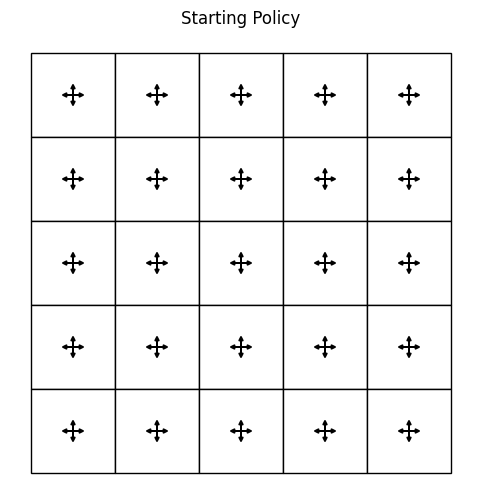

In [9]:
# Create the REINFORCE agent
agent = agents.REINFORCEAgent(env)

# Print the starting policy
print_gridworld_with_policy(agent, env, title="Starting Policy")


100%|██████████████████████████████████████| 6000/6000 [00:07<00:00, 837.50it/s]


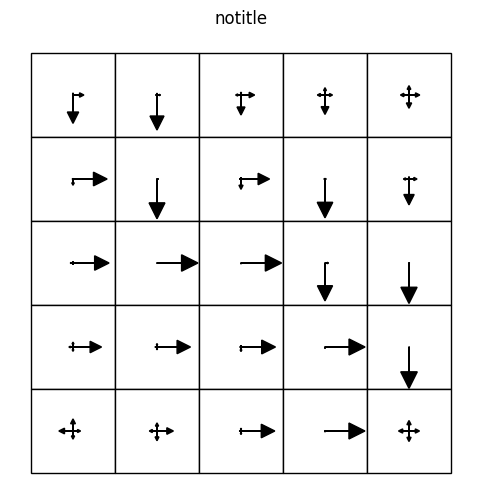

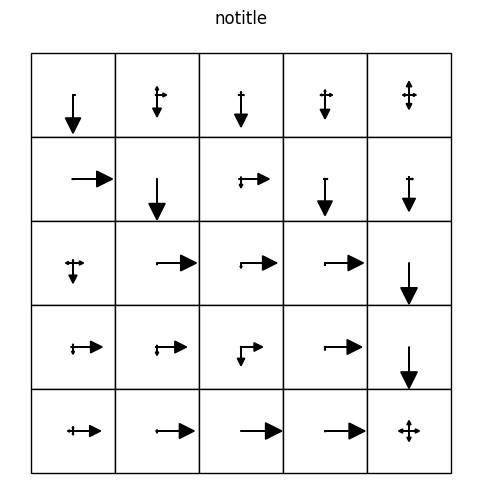

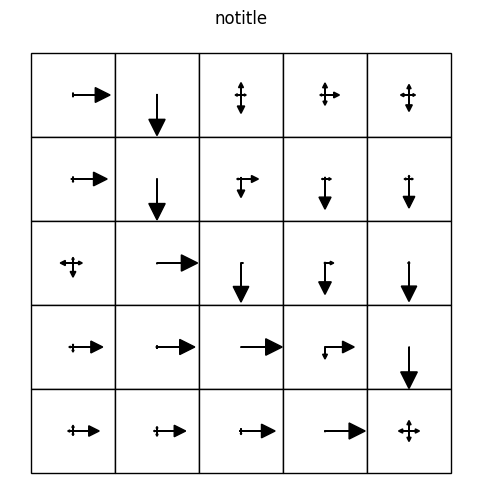

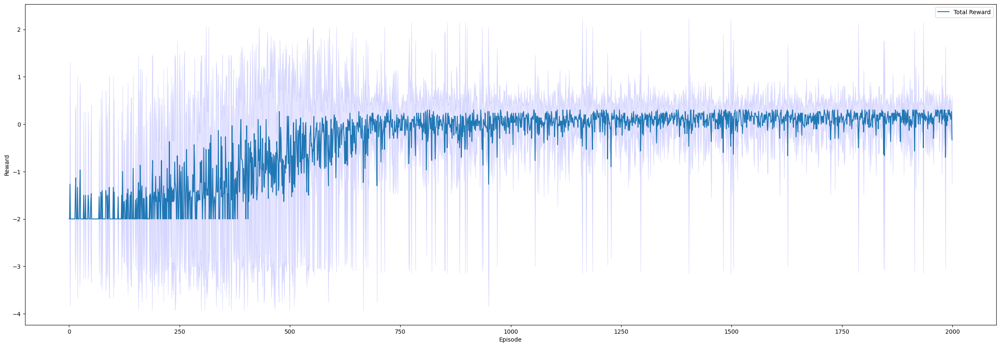

In [10]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 2000
#number of run per episode
n_run = 3

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgent(env, alpha=0.1)
        # Initialize the rewards array
        total_rewards = []
        for i in range(n_episodes):
            # Play the environment
            episode, total_reward = agent.play(env)
            # Save the reward
            total_rewards.append(total_reward)
            # Update the policy
            agent.update_single_sampling(episode)
            pbar.update(1)
        # Save the rewards over the run
        list_total_rewards.append(total_rewards)
        # Print the ending policy
        print_gridworld_with_policy(agent, env)
# Adjust the representation of the rewards
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Prepare values to print
plot_args = {}

total_rewards_means = np.mean(list_total_rewards, axis=1)
total_rewards_stds = np.std(list_total_rewards, axis=1)
plot_args["Total Reward"] = [total_rewards_means, total_rewards_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Reward', 'Reward MDP single sampling')

**Test Reward MDP multiple sampling**

100%|█████████████████████████████████████████| 500/500 [00:13<00:00, 37.33it/s]


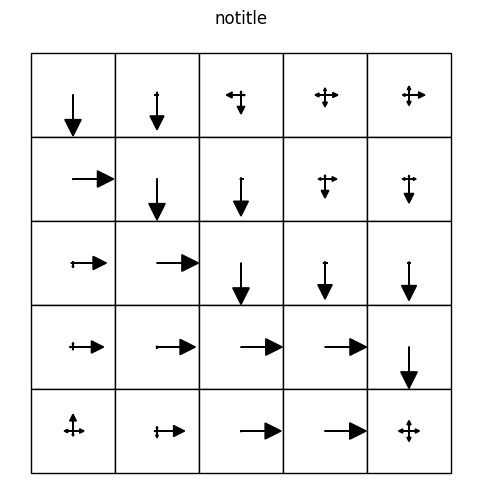

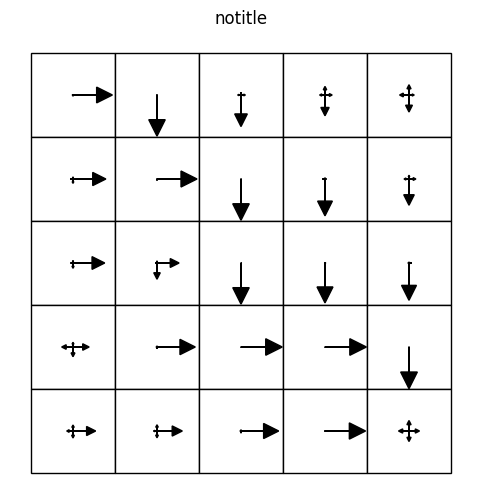

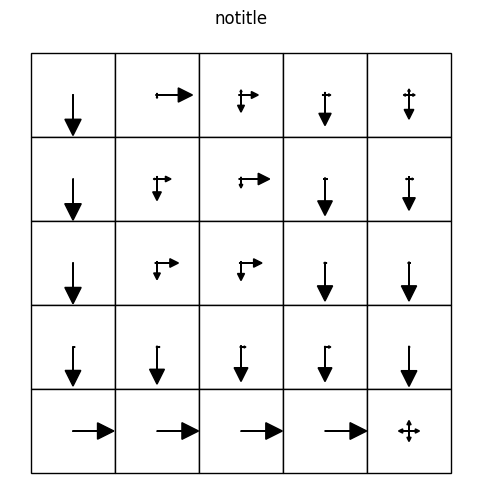

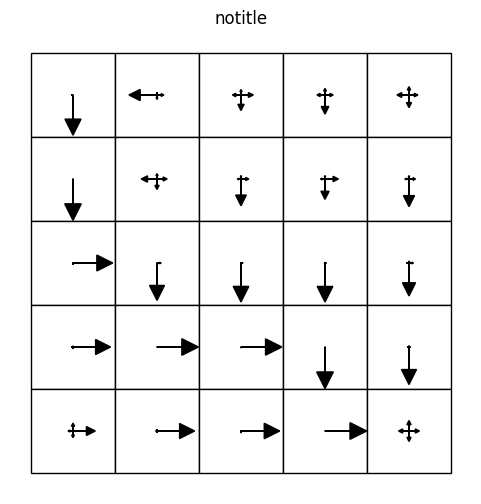

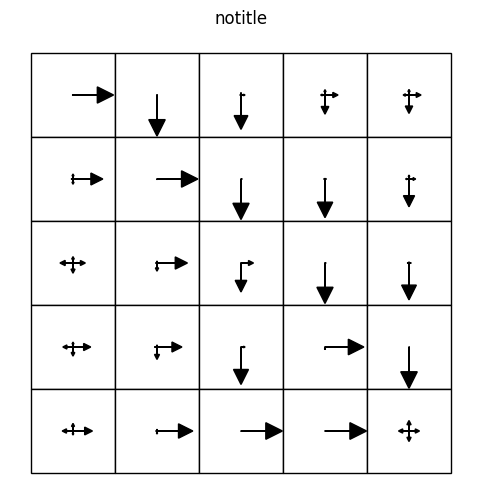

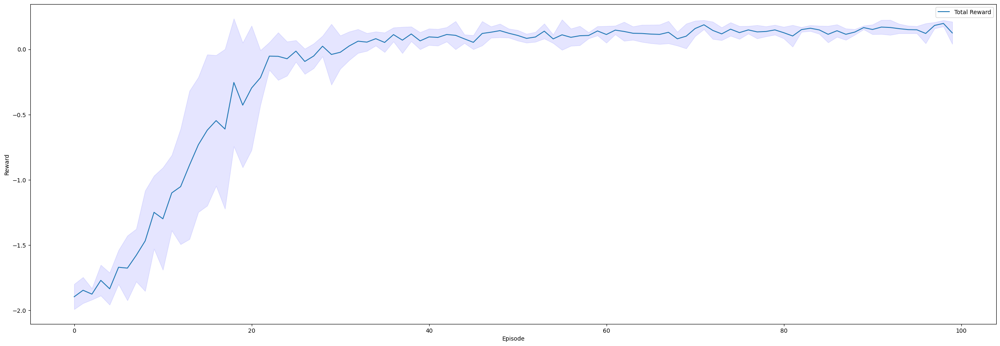

In [11]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 25
#number of run per episode
n_run = 5

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgent(env, alpha=3)
        # Initialize the average rewards array
        total_avg_rewards = []
        for i in range(n_episodes):
            # Play the environment
            episodes, total_rewards = agent.play(env, n_traj)
            # Update the policy
            agent.update_multiple_sampling(episodes)
            # Compute the average the reward in the episode and save it
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        # Save the average rewards over the run
        list_total_rewards.append(total_avg_rewards)
        # Print the ending policy
        print_gridworld_with_policy(agent, env)
# Adjust the representation of the rewards
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Prepare values to print
plot_args = {}

total_rewards_means = np.mean(list_total_rewards, axis=1)
total_rewards_stds = np.std(list_total_rewards, axis=1)
plot_args["Total Reward"] = [total_rewards_means, total_rewards_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Reward', 'Reward MDP multiple sampling')

## Entropy Reinforce Agent MDP

In [12]:
env = environments.GridworldEnvGoalless(time_horizon=25)

**Optimal Policy deterministic**

100%|████████████████████████████████████| 10000/10000 [00:21<00:00, 467.20it/s]


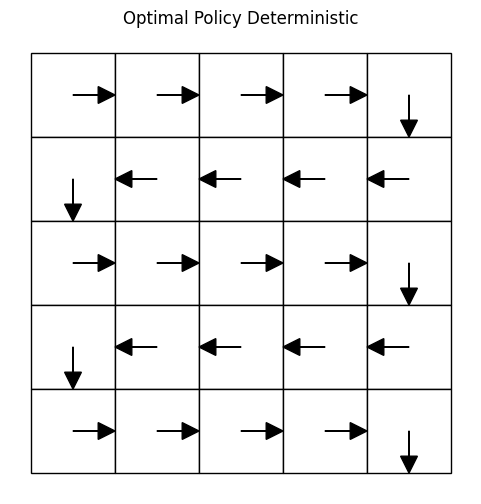

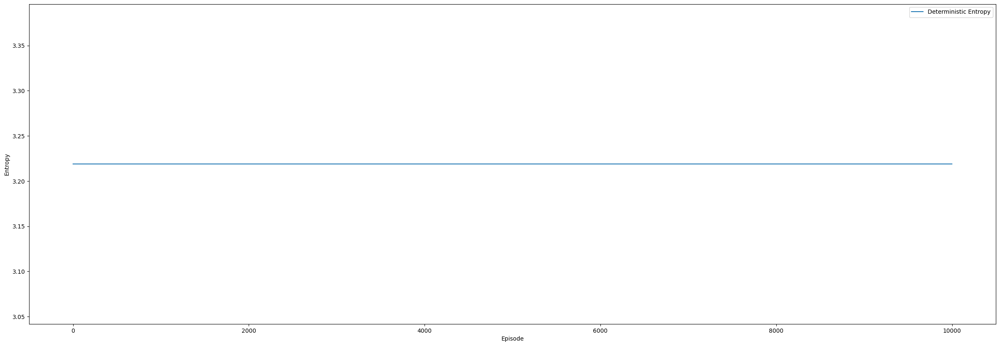

In [16]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
env = environments.GridworldEnvGoalless(time_horizon = 25, prob= 0)
# Number of times the learning is executed
n_run = 1

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, policy=1)
        # Initialize the rewards array
        entropies = []
        for i in range(n_episodes):
            # Play the environment
            episode, d_t = agent.play(env)
            # Update the policy
            entropy = agent.update_single_sampling(episode, d_t)
            # Save the entropy
            entropies.append(entropy)
            pbar.update(1)
        # Save the rewards over the run
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Print the ending policy
print_gridworld_with_policy(agent, env, title="Optimal Policy Deterministic")

# Prepare values to print
plot_args = {}

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Deterministic Entropy'] = [true_entropies_means, true_entropies_stds]
optimal_deterministic_result = plot_args
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Optimal Policy Deterministic')

**Optimal Policy stochastic**
Increasing the number of runs doesn't make the variance of the curve smaller

100%|████████████████████████████████████| 50000/50000 [01:24<00:00, 588.52it/s]


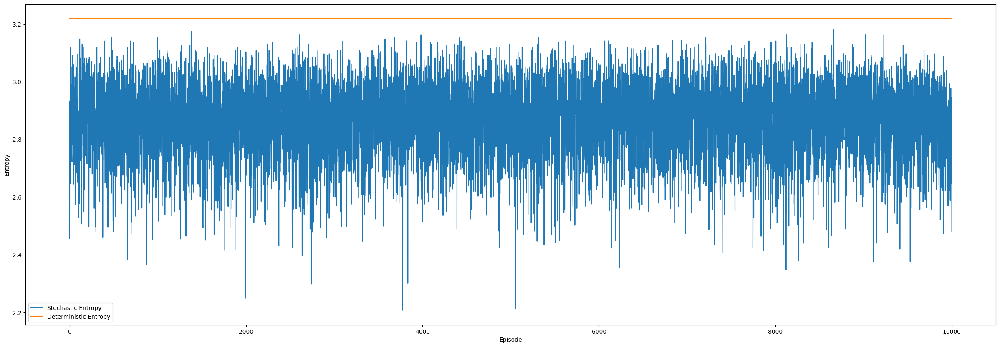

In [17]:
n_episodes = 10000
env = environments.GridworldEnvGoalless(time_horizon = 25, prob= 0.1)
# Number of runs per episode
n_run = 5

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, policy=1)
        # Initialize the array of entropies over the episodes
        entropies = []
        for i in range(n_episodes):
            # Play the environment
            entropy, d_t = agent.play(env)
            # Compute the entropy
            entropy = agent.compute_entropy(d_t)
            # Save the entropy
            entropies.append(entropy)
            pbar.update(1)
        # Save the entropies during the runs
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Stochastic Entropy'] = [true_entropies_means, true_entropies_stds]
plot_args.update(optimal_deterministic_result)
optimal_stochastic_result = plot_args
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic')

**UNIFORM**

**Test Entropy MDP single sampling deterministic**

100%|████████████████████████████████████| 50000/50000 [01:49<00:00, 457.18it/s]


Stochastic Optimal mean: 2.869411266865766
Deterministic Learned mean: 2.4718144163961058


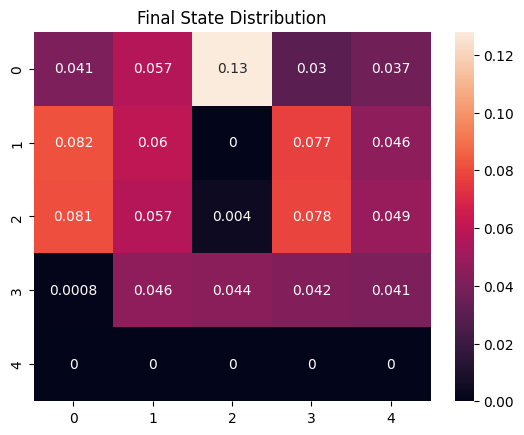

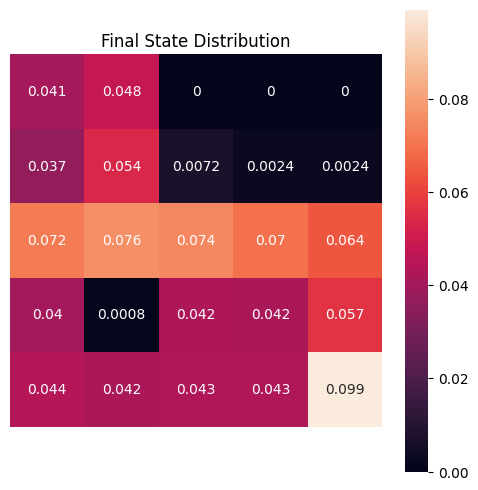

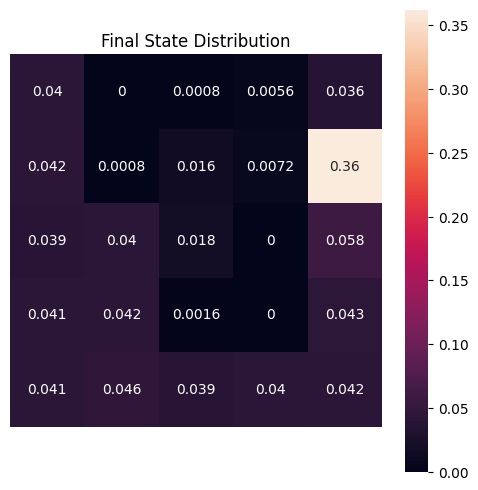

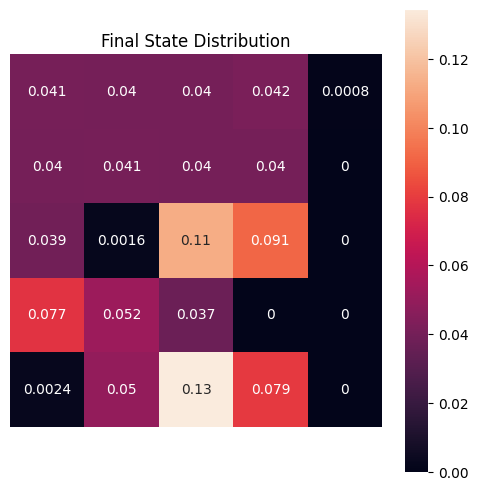

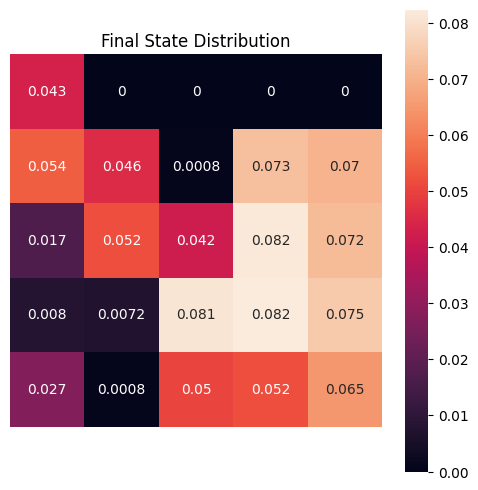

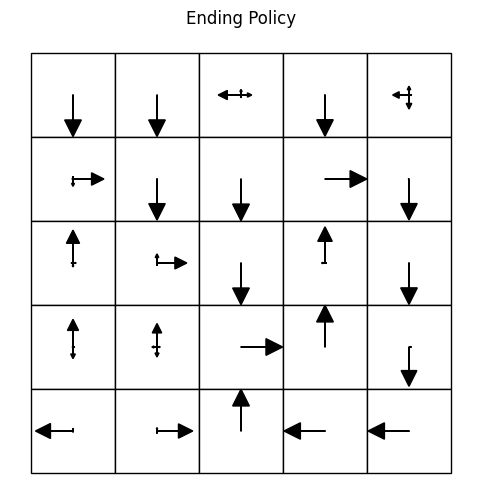

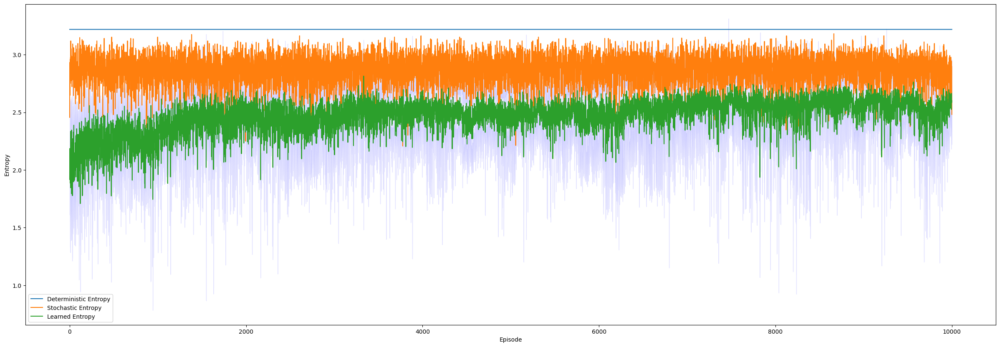

In [18]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
time_horizon = 25
env = environments.GridworldEnvGoalless(time_horizon = 25, prob=0)
# Number of runs per episode
n_run = 5
# Number of trajectories to print the visuals
n_traj = 50

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, alpha=0.04)
        # Initialize the entropies array
        entropies = []
        # Training part
        for i in range(n_episodes):
            # Play the environment
            episode, d_t = agent.play(env)
            # Update the policy
            entropy = agent.update_single_sampling(episode, d_t)
            # Save the entropies
            entropies.append(entropy)
            pbar.update(1)
        # Print the policy and the expected state visitation
        agent.print_visuals(env, n_traj)
        # Save the entropies during the run
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Deterministic Learned mean: " + str(np.mean(true_entropies_means)))

**Test Entropy MDP single sampling stochastic**

 20%|███████▍                             | 9983/50000 [00:20<01:22, 487.38it/s]

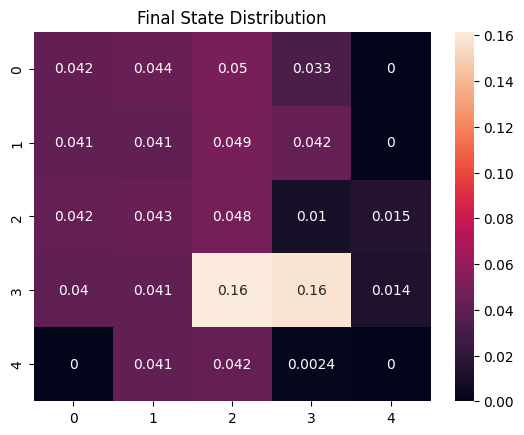

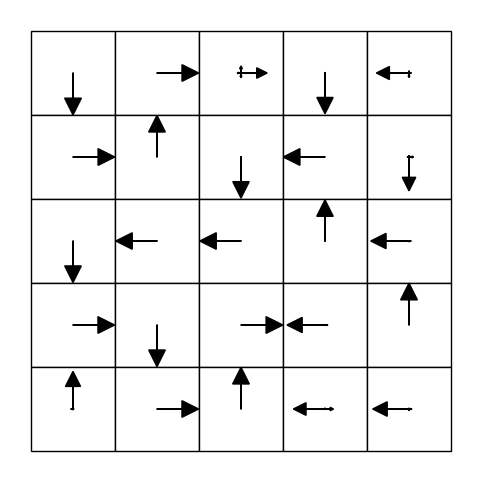

 40%|██████████████▍                     | 20000/50000 [00:41<01:03, 469.34it/s]

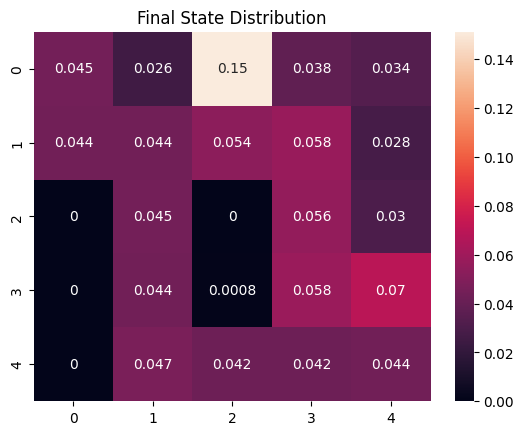

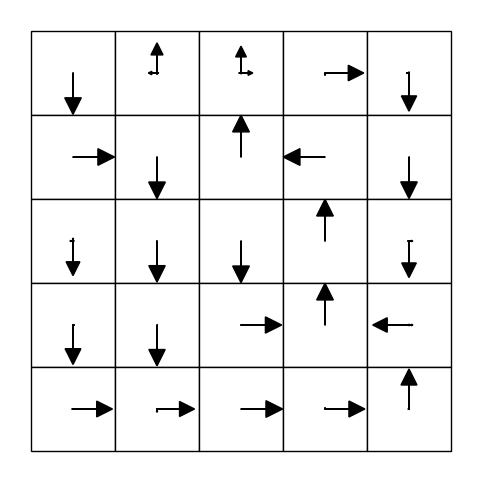

 60%|█████████████████████▌              | 29990/50000 [01:02<00:40, 492.82it/s]

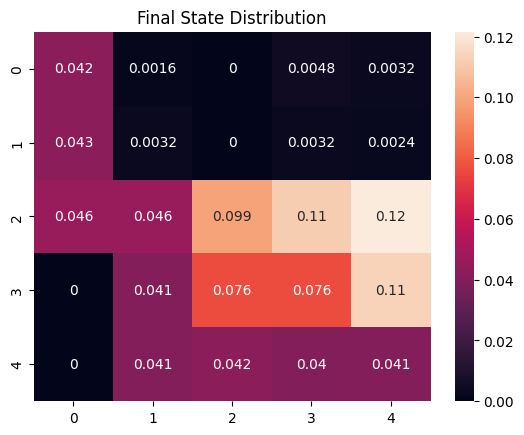

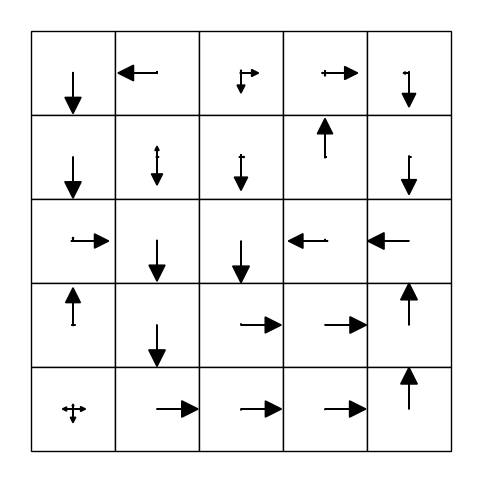

 80%|████████████████████████████▊       | 39970/50000 [01:23<00:20, 494.26it/s]

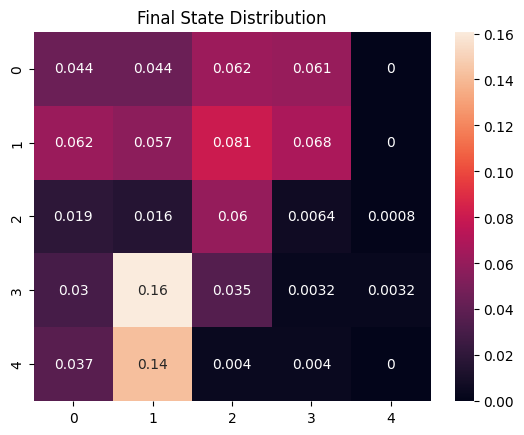

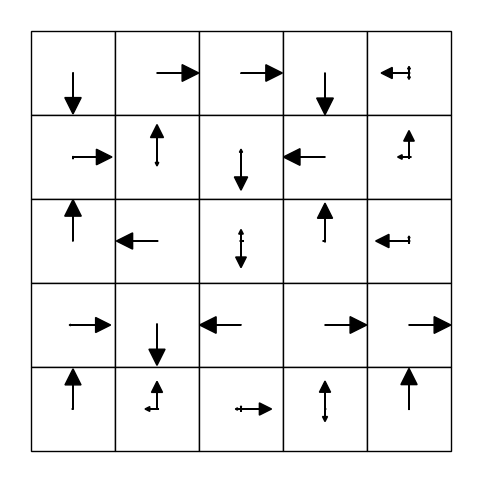

100%|███████████████████████████████████▉| 49953/50000 [01:44<00:00, 487.06it/s]

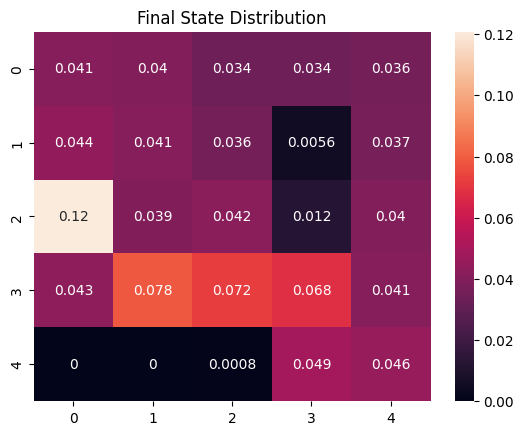

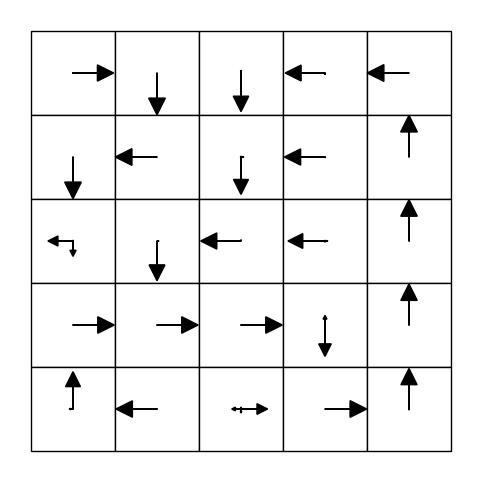

100%|████████████████████████████████████| 50000/50000 [01:45<00:00, 473.94it/s]


Stochastic Optimal mean: 2.870896222973462
Stochastic Learned mean: 2.6915443416421376


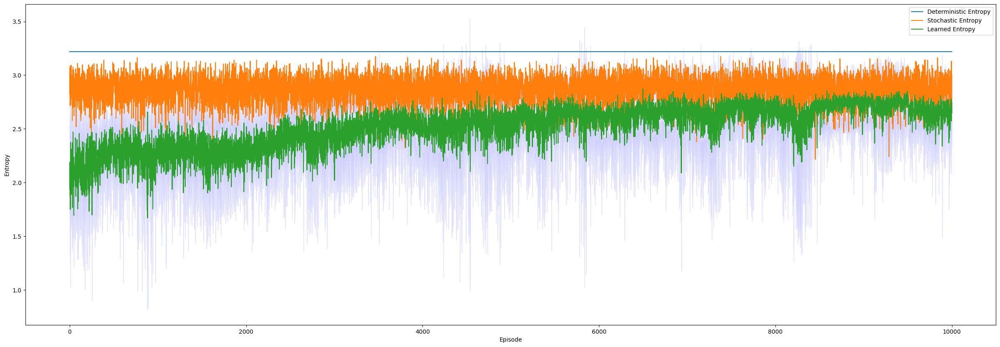

In [15]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
time_horizon = 25
env = environments.GridworldEnvGoalless(time_horizon = 25, prob=0)
# Number of runs per episode
n_run = 5
# Number of trajectories to print the visuals
n_traj = 50

# Train the agent and plot the rewards
list_true_entropies = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, alpha=0.04)
        # Initialize the entropies array
        entropies = []
        # Training part
        for i in range(n_episodes):
            # Play the environment
            episode, d_t = agent.play(env)
            # Update the policy
            entropy = agent.update_single_sampling(episode, d_t)
            # Save the entropies
            entropies.append(entropy)
            pbar.update(1)
        # Print the policy and the expected state visitation
        agent.print_visuals(env, n_traj)
        # Save the entropies during the run
        list_true_entropies.append(entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9000:])))

**Test Entropy MDP multiple sampling deterministic**

  0%|                                                 | 0/50000 [00:00<?, ?it/s]

 20%|███████▌                              | 9999/50000 [13:47<55:11, 12.08it/s]

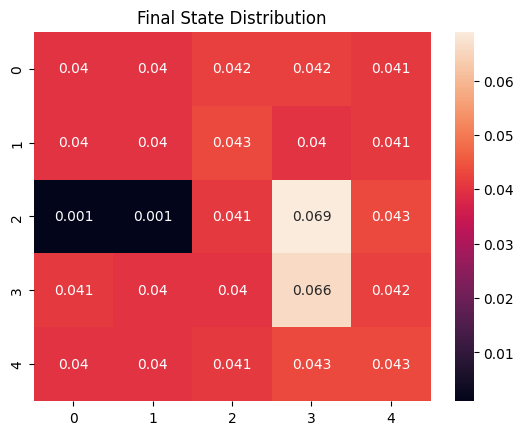

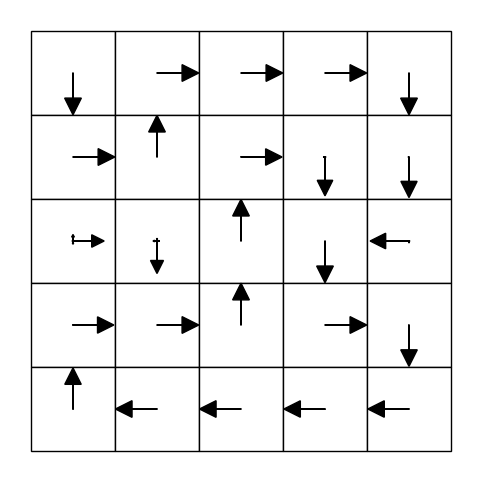

 40%|██████████████▊                      | 20000/50000 [27:39<41:17, 12.11it/s]

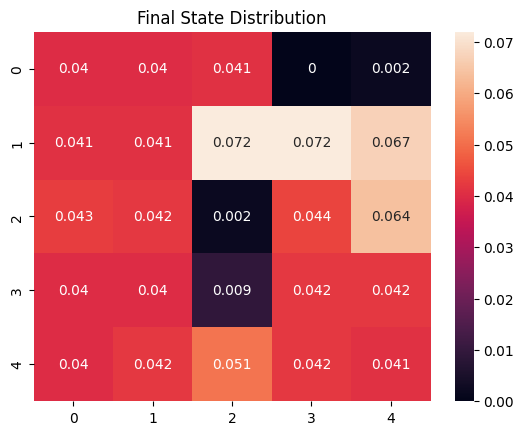

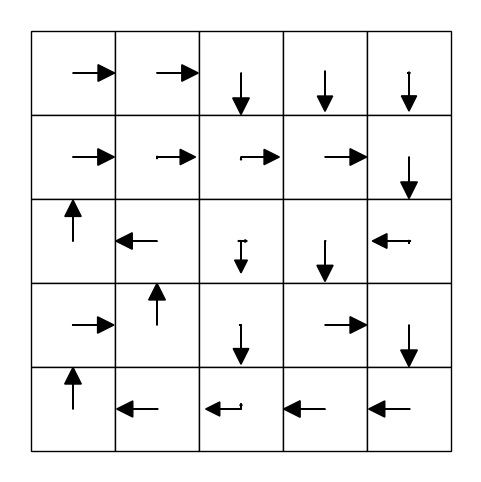

 60%|██████████████████████▏              | 30000/50000 [41:17<27:53, 11.95it/s]

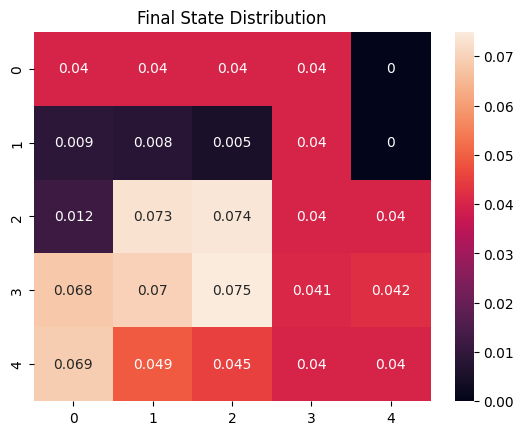

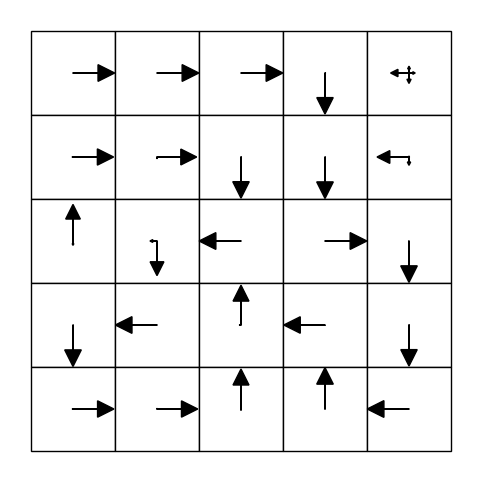

 80%|█████████████████████████████▌       | 40000/50000 [54:52<13:32, 12.31it/s]

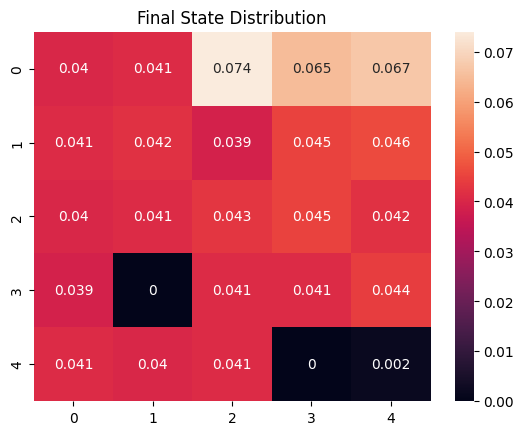

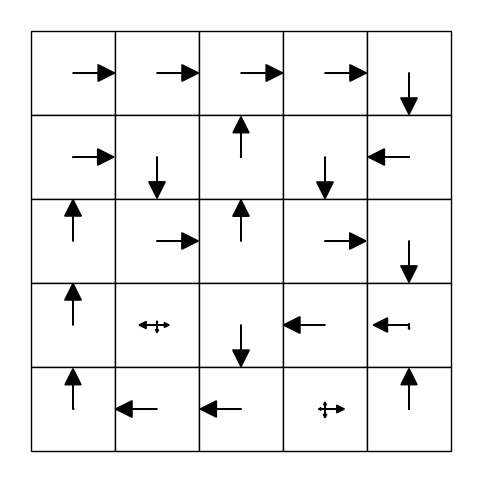

100%|███████████████████████████████████| 50000/50000 [1:08:28<00:00, 13.13it/s]

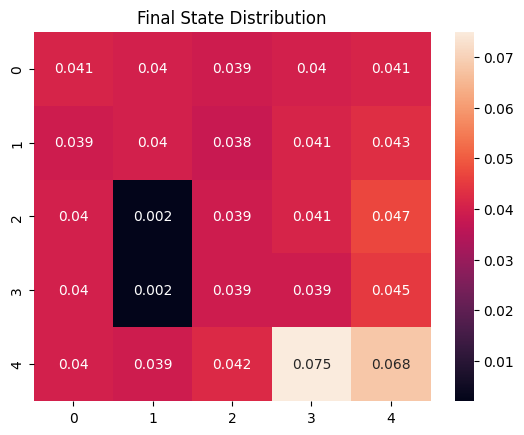

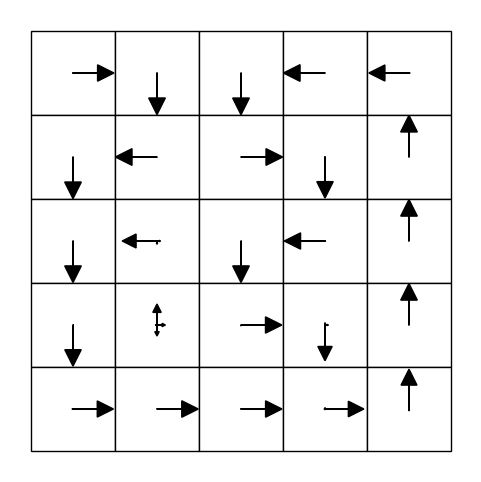

100%|███████████████████████████████████| 50000/50000 [1:08:28<00:00, 12.17it/s]


Stochastic Optimal mean: 2.870896222973462
Stochastic Learned mean: 3.0311712570506653


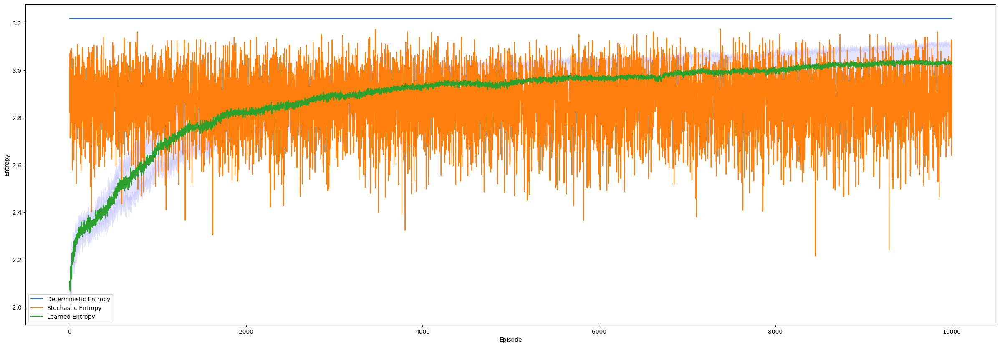

In [18]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
time_horizon = 25
env = environments.GridworldEnvGoalless(time_horizon = 25, prob=0)
# Number of runs per episode
n_run = 5
# Number of trajectories to print the visuals
n_traj = 40

with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    # Train the agent and plot the entropies
    list_true_entropies = []
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, alpha=0.15)
        # Initialize the average entropies array
        avg_entropies = []
        for i in range(n_episodes):
            # Play the environment
            episodes = agent.play(env, n_traj=n_traj)
            # Update the policy
            entropies = agent.update_multiple_sampling(episodes)
            # Save the average entropies over the episode
            avg_entropies.append(np.mean(entropies))
            pbar.update(1)
        # Print the policy and the expected state visitation
        agent.print_visuals(env, n_traj)
        # Save the entropies during the run
        list_true_entropies.append(avg_entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic Multiple Sampling')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9000:])))

In [19]:
plot_args = {}
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
deterministic_multiple_sampling_result = plot_args

**Test Entropy MDP multiple sampling stochastic**

 20%|███████                            | 10000/50000 [16:58<1:08:33,  9.73it/s]

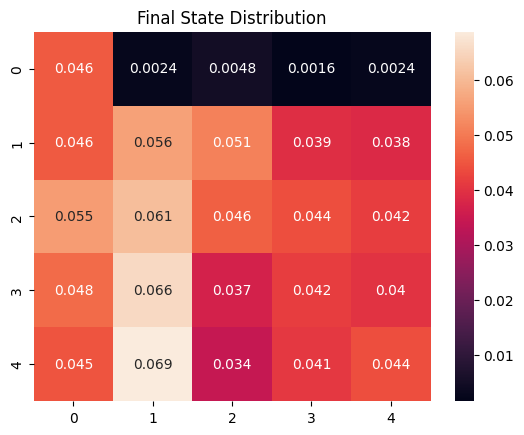

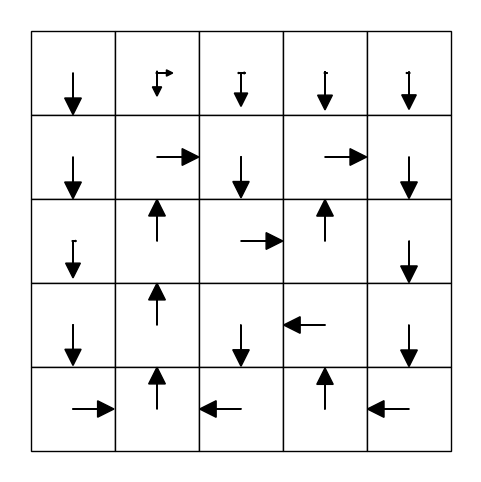

 40%|██████████████▊                      | 20000/50000 [34:09<47:22, 10.55it/s]

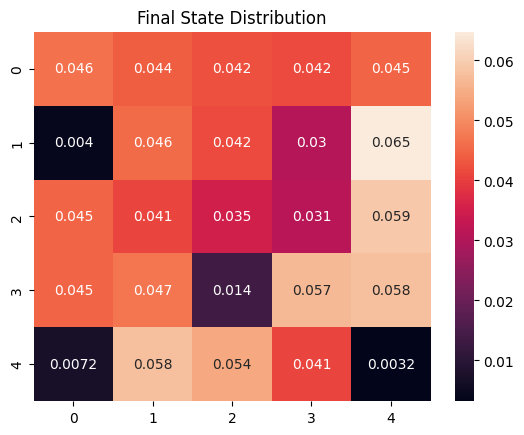

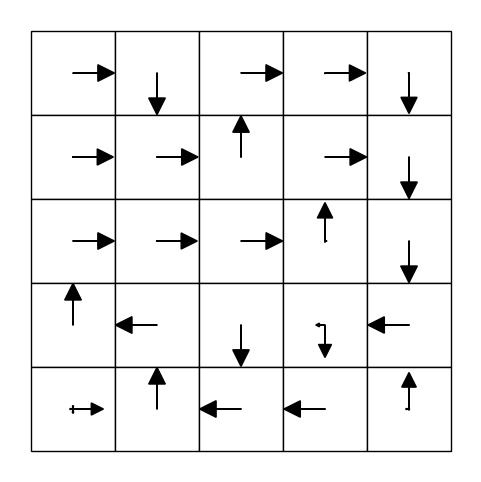

 60%|██████████████████████▏              | 30000/50000 [51:19<33:40,  9.90it/s]

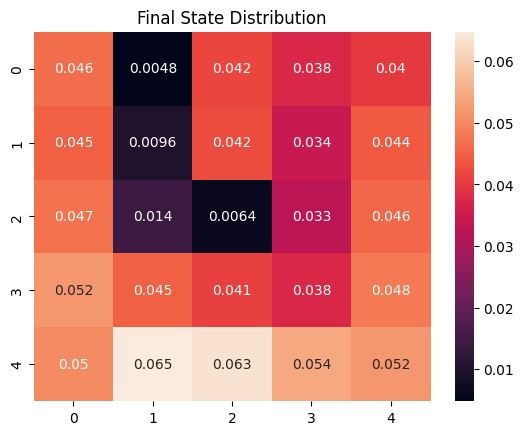

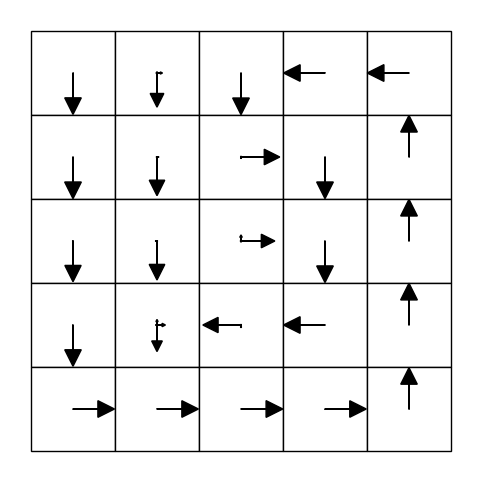

 80%|████████████████████████████       | 40000/50000 [1:08:22<17:26,  9.56it/s]

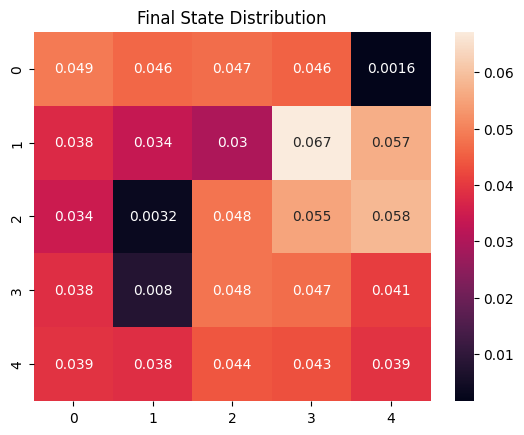

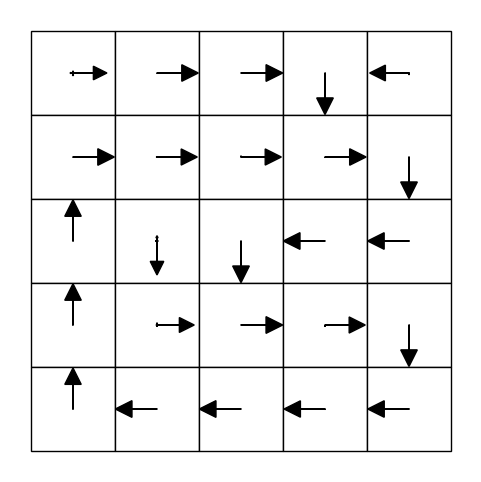

100%|██████████████████████████████████▉| 49999/50000 [1:25:18<00:00,  9.86it/s]

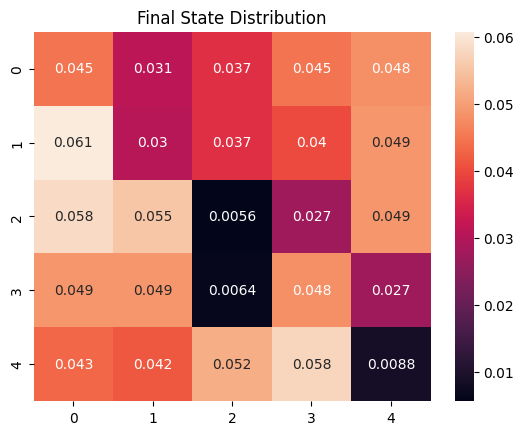

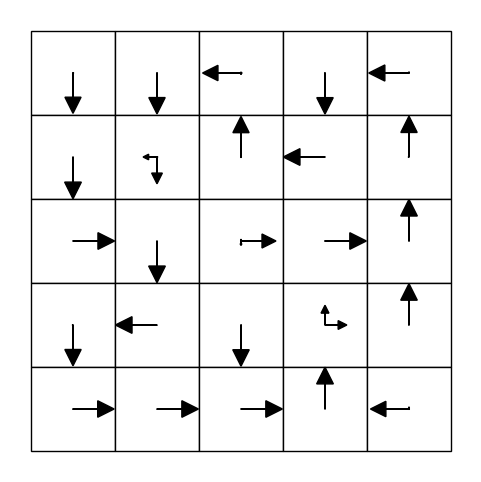

100%|███████████████████████████████████| 50000/50000 [1:25:19<00:00,  9.77it/s]


Stochastic Optimal mean: 2.870896222973462
Stochastic Learned mean: 2.899724378483428


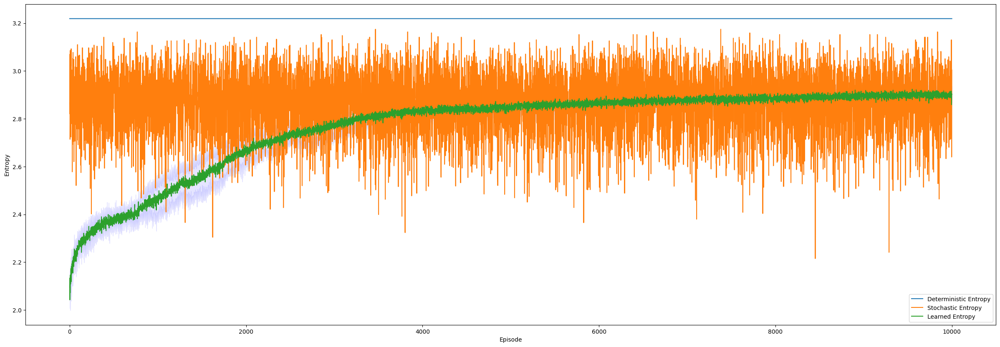

In [20]:
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
time_horizon = 25
env = environments.GridworldEnvGoalless(time_horizon = 25, prob=0.1)
# Number of runs per episode
n_run = 5
# Number of trajectories to print the visuals
n_traj = 50

with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    # Train the agent and plot the entropies
    list_true_entropies = []
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, alpha=0.15)
        # Initialize the average entropies array
        avg_entropies = []
        for i in range(n_episodes):
            # Play the environment
            episodes = agent.play(env, n_traj=n_traj)
            # Update the policy
            entropies = agent.update_multiple_sampling(episodes)
            # Save the average entropies over the episode
            avg_entropies.append(np.mean(entropies))
            pbar.update(1)
        # Print the policy and the expected state visitation
        agent.print_visuals(env, n_traj)
        # Save the entropies during the run
        list_true_entropies.append(avg_entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}
plot_args.update(optimal_deterministic_result)
plot_args.update(optimal_stochastic_result)

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic Multiple Sampling')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

In [21]:
plot_args = {}
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
stochastic_multiple_sampling_result = plot_args

**Test Entropy MDP Multiple Sampling bigger time horizon**

 20%|███████                            | 10000/50000 [18:22<1:13:22,  9.09it/s]

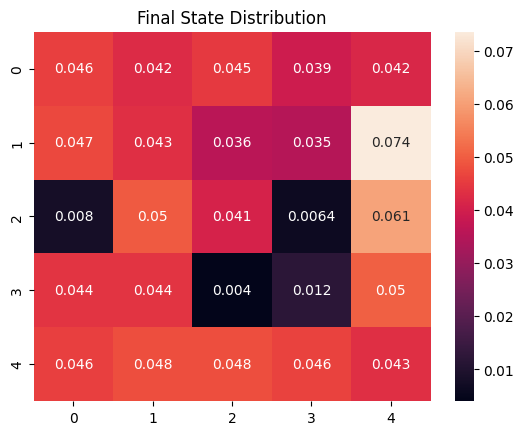

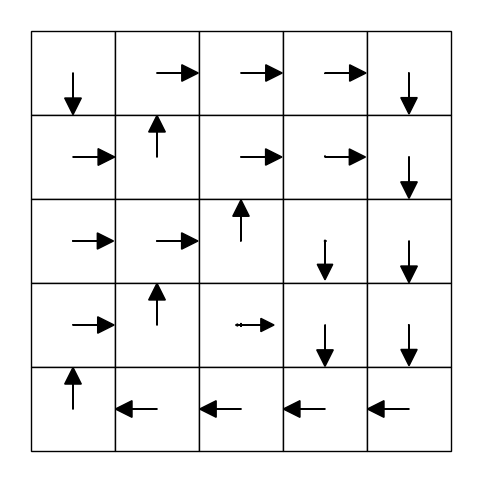

 40%|██████████████▊                      | 20000/50000 [36:44<54:21,  9.20it/s]

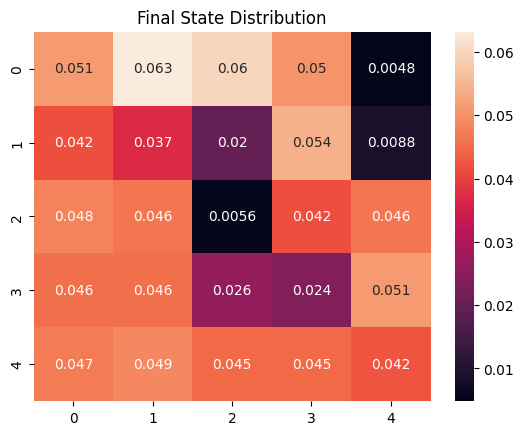

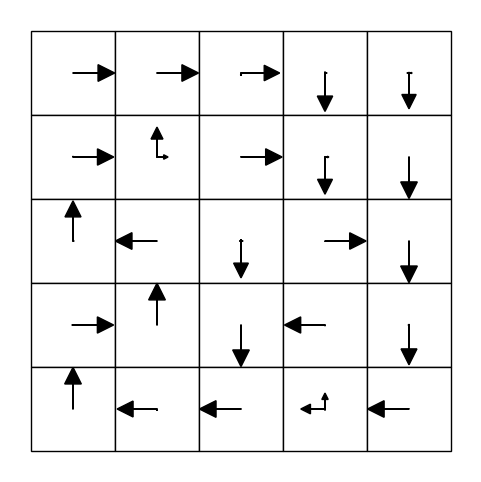

 60%|██████████████████████▏              | 30000/50000 [55:08<36:45,  9.07it/s]

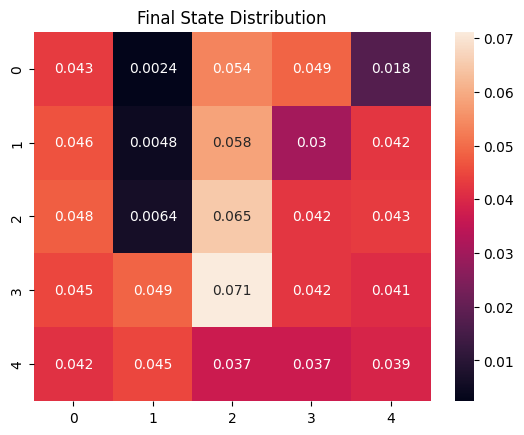

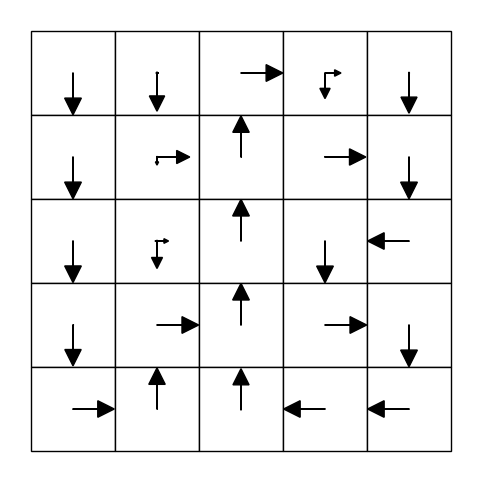

 80%|████████████████████████████       | 40000/50000 [1:13:33<18:38,  8.94it/s]

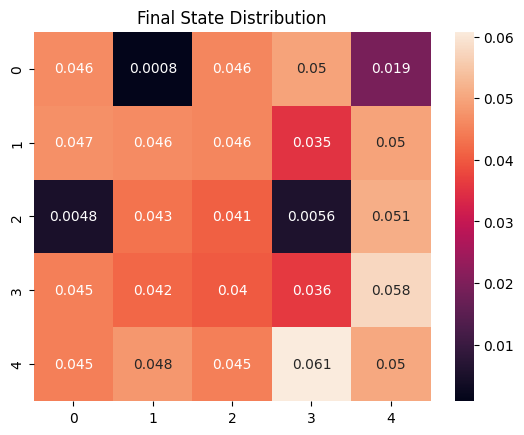

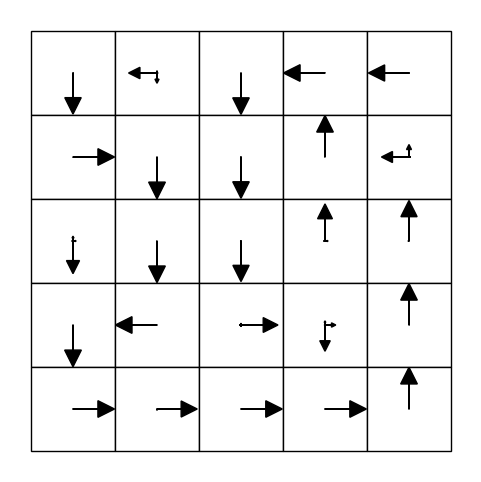

100%|███████████████████████████████████| 50000/50000 [1:31:56<00:00,  8.93it/s]

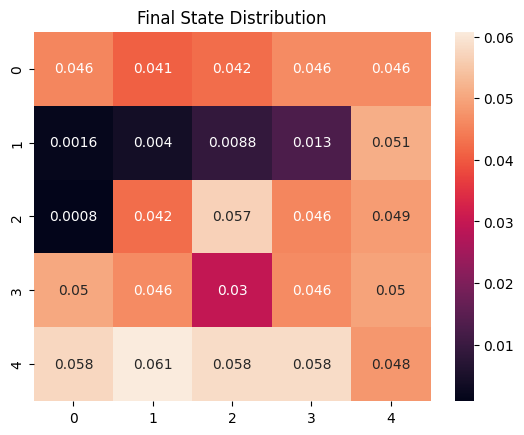

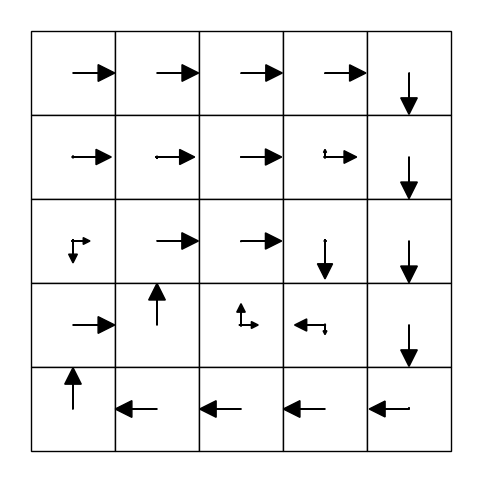

100%|███████████████████████████████████| 50000/50000 [1:31:57<00:00,  9.06it/s]


Stochastic Optimal mean: 2.869424510834507
Stochastic Learned mean: 2.8991541500719533


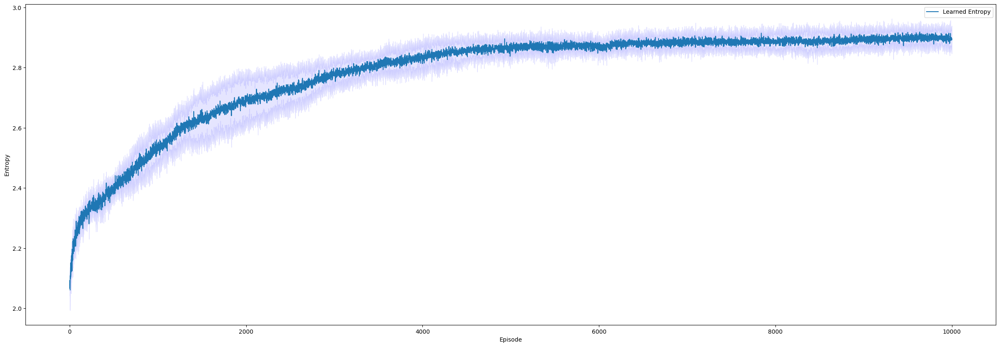

In [9]:
checkpoints = [0, 50, 250, 1000, 2000, 4000, 5000, 7500, 9000, 9999]
list_policies = []
# Number of episodes for the training
n_episodes = 10000
# Initialize the environment
time_horizon = 50
env = environments.GridworldEnvGoalless(time_horizon = 25, prob=0.1)
# Number of runs per episode
n_run = 5
# Number of trajectories to print the visuals
n_traj = 50

with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    # Train the agent and plot the entropies
    list_true_entropies = []
    for r in range(n_run):
        # Initialize the agent
        agent = agents.REINFORCEAgentE(env, alpha=0.15)
        # Initialize the average entropies array
        avg_entropies = []
        for i in range(n_episodes):
            if i in checkpoints:
                list_policies.append(np.copy(agent.policy_params))
            # Play the environment
            episodes = agent.play(env, n_traj=n_traj)
            # Update the policy
            entropies = agent.update_multiple_sampling(episodes)
            # Save the average entropies over the episode
            avg_entropies.append(np.mean(entropies))
            pbar.update(1)
        # Print the policy and the expected state visitation
        agent.print_visuals(env, n_traj)
        # Save the entropies during the run
        list_true_entropies.append(avg_entropies)
    # Adjust the representation of the entropies
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

# Prepare values to print
plot_args = {}

true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', 'Entropy Policy Deterministic/Stochastic Multiple Sampling')
print("Stochastic Optimal mean: " + str(np.mean(optimal_stochastic_result.get('Stochastic Entropy')[0])))
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

Checkpoint 0 policy:


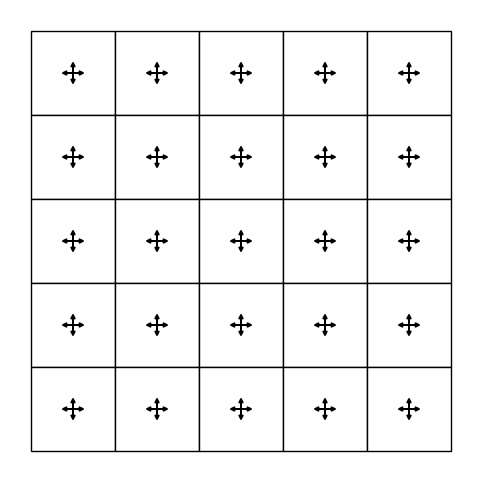

Checkpoint 50 policy:


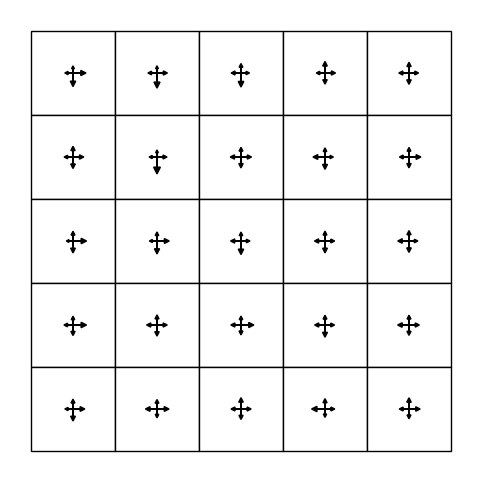

Checkpoint 250 policy:


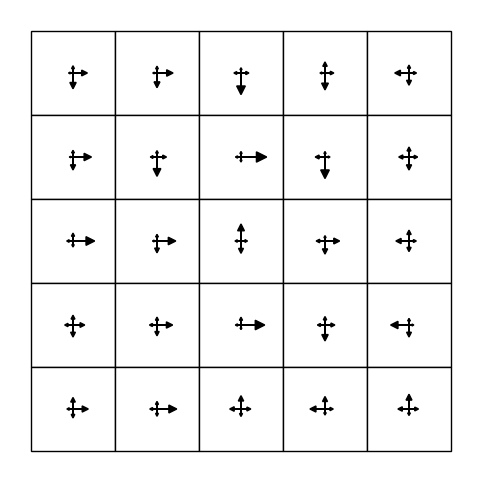

Checkpoint 1000 policy:


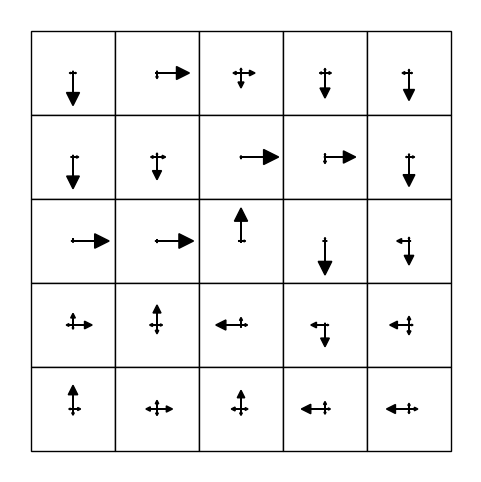

Checkpoint 2000 policy:


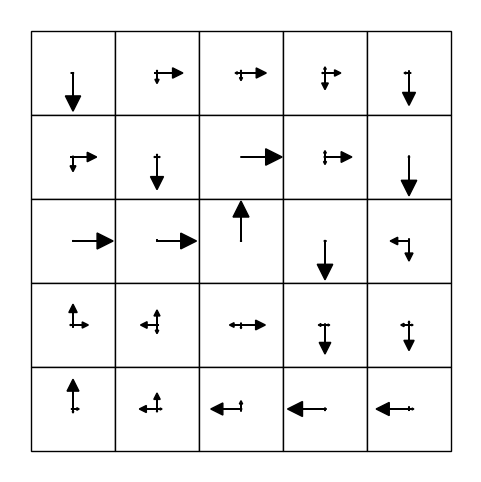

Checkpoint 4000 policy:


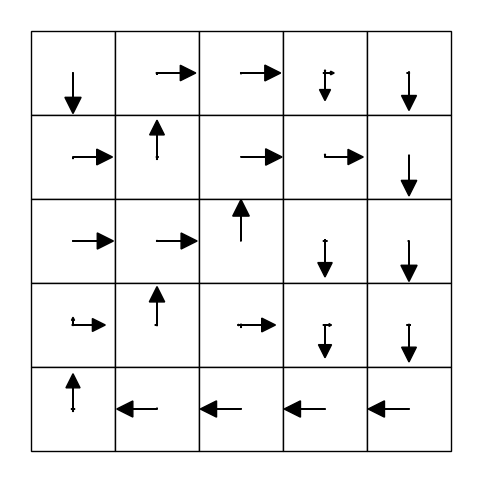

Checkpoint 5000 policy:


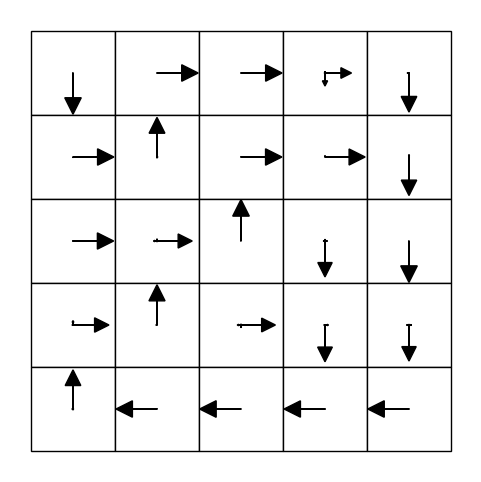

Checkpoint 7500 policy:


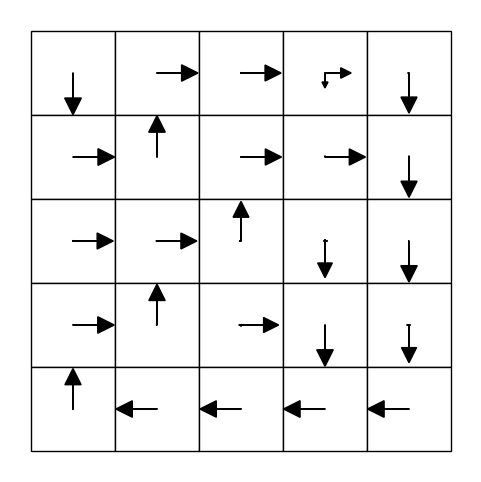

Checkpoint 9000 policy:


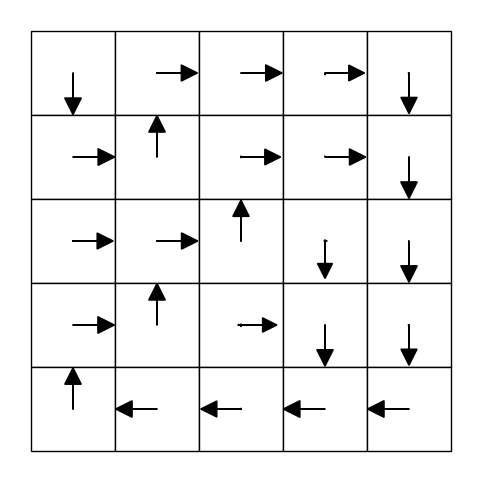

Checkpoint 9999 policy:


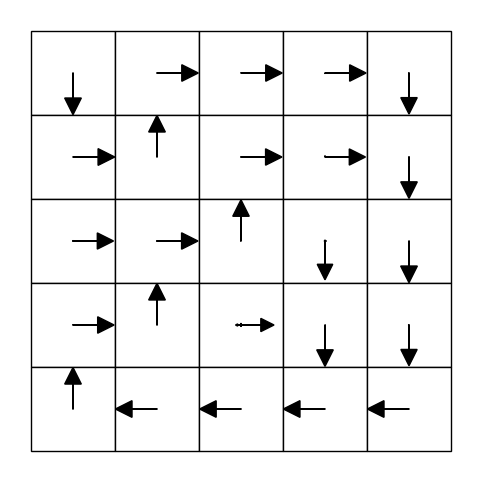

In [10]:
# Print the ending policy
for i in range(len(checkpoints)):
    print("Checkpoint %d policy:" %checkpoints[i])
    agent.policy_params = list_policies[i]
    print_gridworld_with_policy(agent, env)

# Gridworld POMDP

In [3]:
gym.envs.register(
    id='GridworldPOMDPEnv-v0',
    entry_point=environments.GridworldPOMDPEnv
)
env = gym.make('GridworldPOMDPEnv-v0', steepness=501)

## Test observation matrix


1.0
1.0


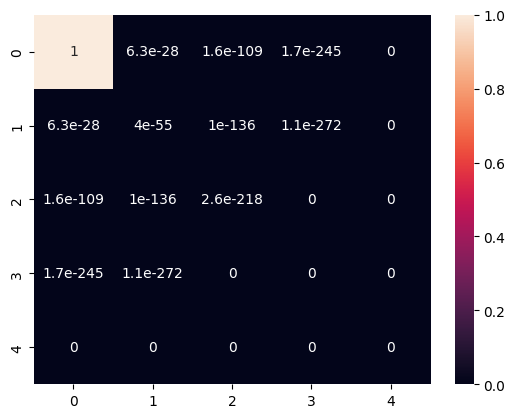

In [4]:
sns.heatmap(np.reshape(env.observation_matrix[0], (env.grid_size, env.grid_size)), annot=True)
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))

## Reward Reinforce POMDP

**Test Reward POMDP sampled state**

  0%|                                                   | 0/500 [00:00<?, ?it/s]

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:187: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the environment initialisation to be passed additional information.
  logger.warn(
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
 20%|████████▏                                | 100/500 [00:09<00:32, 12.49it/s]

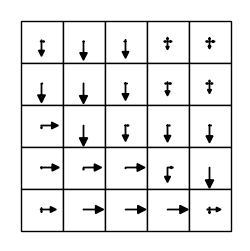

 40%|████████████████▎                        | 199/500 [00:19<00:23, 12.78it/s]

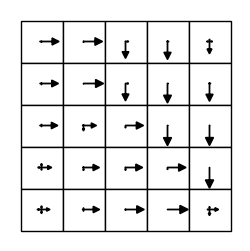

 60%|████████████████████████▌                | 300/500 [00:29<00:14, 13.59it/s]

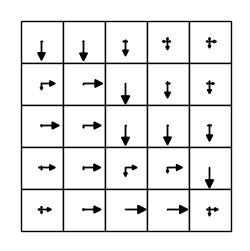

 80%|████████████████████████████████▊        | 400/500 [00:39<00:07, 12.59it/s]

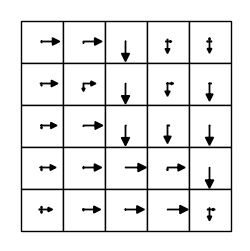

100%|████████████████████████████████████████▉| 499/500 [00:49<00:00, 12.35it/s]

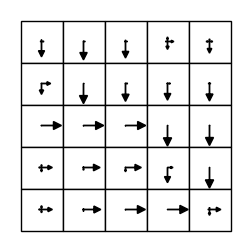

100%|█████████████████████████████████████████| 500/500 [00:49<00:00, 10.02it/s]


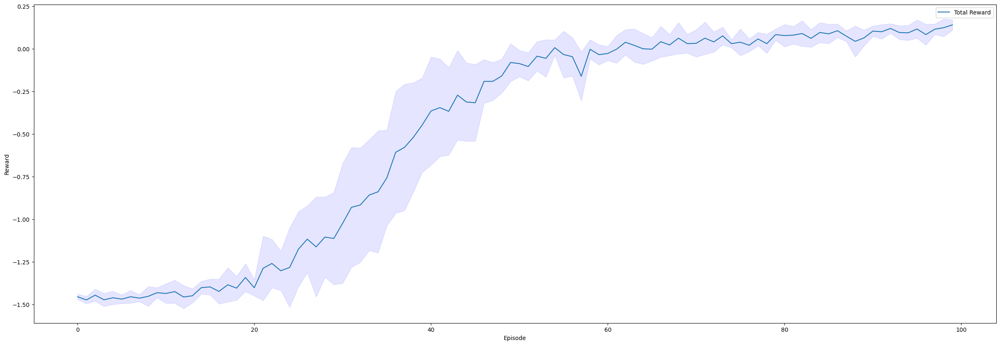

In [5]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
# Number of runs of training
n_run = 5
# Initialize environment
env = gym.make('GridworldPOMDPEnv-v0', time_horizon=15)

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = agents.REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes, total_rewards = agent.play(env, n_traj)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        # Print final policy
        print_gridworld_with_policy(agent, env, (3,3), "Final Policy run #" + str(r))
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Prepare values to print
plot_args = {}

total_rewards_means = np.mean(list_total_rewards, axis=1)
total_rewards_stds = np.std(list_total_rewards, axis=1)
plot_args["Total Reward"] = [total_rewards_means, total_rewards_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Reward', 'Reward POMDP')

In [6]:
reward_sampled_version = total_rewards_means
agent_sampled_version = agent

**Test Reward POMDP belief state**

In [ ]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
#number of run per episode
n_run = 5

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = agents.REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes = []
            total_rewards = []
            for k in range(n_traj):
                episode = []
                agent.belief_state = env.reset()
                done = False
                total_reward = 0
                while not done:
                    # Sample the action from the state
                    action, probs = agent.get_action(agent.belief_state)
                    # Compute the step
                    next_obs, reward, done, true_state = env.step(action)
                    # Save step in the episode
                    episode.append((agent.belief_state, action, probs, reward, true_state))
                    # Update belief
                    agent.belief_update(action, next_obs)
                    total_reward += reward
                episodes.append(episode)
                total_rewards.append(total_reward)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Print the ending policy
print("Ending Policy:")
print_gridworld_with_policy(agent, env)

# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
total_rewards_means = []
under_line = []
over_line = []
for i in range(n_episodes):
    total_rewards_mean = np.mean(list_total_rewards[i])
    total_rewards_std = np.std(list_total_rewards[i])
    freedom_deg = n_run - 1
    t_crit = np.abs(t.ppf((1 - confidence) / 2, freedom_deg))
    total_rewards_means.append(total_rewards_mean)
    under_line.append(total_rewards_mean - total_rewards_std * t_crit / np.sqrt(n_run))
    over_line.append(total_rewards_mean + total_rewards_std * t_crit / np.sqrt(n_run))
ax.clear()
ax.plot(total_rewards_means, label='Total Reward')
ax.fill_between(np.arange(n_episodes), under_line, over_line, color='b', alpha=0.1)
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

In [ ]:
reward_belief_version = total_rewards_means
agent_belief_version = agent

**Comparison between the two**

In [ ]:
# Print the ending policy
print("Ending Policy Sampled Version:")
print_gridworld_with_policy(agent_sampled_version, env)
# Print the ending policy
print("Ending Policy Belief Version:")
print_gridworld_with_policy(agent_belief_version, env)
# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
ax.clear()
ax.plot(reward_sampled_version[:3000], label='Total Reward Sampled Version')
ax.plot(reward_belief_version, label='Total Reward Belief Version')
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

**Random Initialization**

In [ ]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
#number of run per episode
n_run = 5
confidence = 0.95

env = GridworldPOMDPEnv(time_horizon=15, randomize=1)

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes = []
            total_rewards = []
            for k in range(n_traj):
                episode = []
                agent.belief_state = env.reset()
                done = False
                total_reward = 0
                while not done:
                    # Sample state
                    sampled_state = agent.get_state(1)
                    # Get the index of the state
                    state_index = agent.env.state_to_index(sampled_state)
                    # Get the one hot encoding
                    ohe_state = agent.ohe_states[state_index, :]
                    # Sample the action from the state
                    action, probs = agent.get_action(ohe_state)
                    # Compute the step
                    next_obs, reward, done, true_state = env.step(action)
                    # Save step in the episode
                    episode.append((ohe_state, action, probs, reward, true_state))
                    # Update belief
                    agent.belief_update(action, next_obs)
                    total_reward += reward
                episodes.append(episode)
                total_rewards.append(total_reward)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1,0))

# Print the ending policy
print("Ending Policy:")
print_gridworld_with_policy(agent, env)

# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
total_rewards_means = []
under_line = []
over_line = []
for i in range(n_episodes):
    total_rewards_mean = np.mean(list_total_rewards[i])
    total_rewards_std = np.std(list_total_rewards[i])
    freedom_deg = n_run - 1
    t_crit = np.abs(t.ppf((1 - confidence) / 2, freedom_deg))
    total_rewards_means.append(total_rewards_mean)
    under_line.append(total_rewards_mean - total_rewards_std * t_crit / np.sqrt(n_run))
    over_line.append(total_rewards_mean + total_rewards_std * t_crit / np.sqrt(n_run))
ax.clear()
ax.plot(total_rewards_means, label='Total Reward')
ax.fill_between(np.arange(n_episodes), under_line, over_line, color='b', alpha=0.1)
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

In [ ]:
reward_sampled_version = total_rewards_means
agent_sampled_version = agent

In [ ]:
# Create the Gridworld environment and the REINFORCE agent
n_episodes = 100
# Number of sampled trajectories per episode
n_traj = 50
#number of run per episode
n_run = 5
confidence = 0.95

env = GridworldPOMDPEnv(time_horizon=15, randomize=1)

# Train the agent and plot the rewards
list_total_rewards = []
with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    for r in range(n_run):
        #print("Run %d" %r)
        agent = REINFORCEAgentPOMDP(env, alpha=3)
        total_avg_rewards = []
        for i in range(n_episodes):
            episodes = []
            total_rewards = []
            for k in range(n_traj):
                episode = []
                agent.belief_state = env.reset()
                done = False
                total_reward = 0
                while not done:
                    # Sample the action from the state
                    action, probs = agent.get_action(agent.belief_state)
                    # Compute the step
                    next_obs, reward, done, true_state = env.step(action)
                    # Save step in the episode
                    episode.append((agent.belief_state, action, probs, reward, true_state))
                    # Update belief
                    agent.belief_update(action, next_obs)
                    total_reward += reward
                episodes.append(episode)
                total_rewards.append(total_reward)
            agent.update_multiple_sampling(episodes)
            total_avg_rewards.append(np.mean(total_rewards))
            pbar.update(1)
        list_total_rewards.append(total_avg_rewards)
list_total_rewards = np.transpose(np.array(list_total_rewards), (1, 0))

# Print the ending policy
print("Ending Policy:")
print_gridworld_with_policy(agent, env)

# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
total_rewards_means = []
under_line = []
over_line = []
for i in range(n_episodes):
    total_rewards_mean = np.mean(list_total_rewards[i])
    total_rewards_std = np.std(list_total_rewards[i])
    freedom_deg = n_run - 1
    t_crit = np.abs(t.ppf((1 - confidence) / 2, freedom_deg))
    total_rewards_means.append(total_rewards_mean)
    under_line.append(total_rewards_mean - total_rewards_std * t_crit / np.sqrt(n_run))
    over_line.append(total_rewards_mean + total_rewards_std * t_crit / np.sqrt(n_run))
ax.clear()
ax.plot(total_rewards_means, label='Total Reward')
ax.fill_between(np.arange(n_episodes), under_line, over_line, color='b', alpha=0.1)
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

In [ ]:
reward_belief_version = total_rewards_means
agent_belief_version = agent

**Comparison between the two**

In [ ]:
# Print the ending policy
print("Ending Policy Sampled Version:")
print_gridworld_with_policy(agent_sampled_version, env)
# Print the ending policy
print("Ending Policy Belief Version:")
print_gridworld_with_policy(agent_belief_version, env)
# Initialize the plotting vectors
fig, ax = plt.subplots(figsize=(40, 10))
ax.clear()
ax.plot(reward_sampled_version[:3000], label='Total Reward Sampled Version')
ax.plot(reward_belief_version, label='Total Reward Belief Version')
ax.set_xlabel('Episode')
ax.set_ylabel('Reward')
ax.legend()
fig.canvas.draw()

## Entropy Reinforce POMDP

**Test belief Update**

In [ ]:
time_horizon = 25
env = GridworldPOMDPEnvGoalless(time_horizon = time_horizon, steepness=501, prob=0)
agent = REINFORCEAgentEPOMDP(env, alpha = 0.5)

agent.belief_state = env.reset()
done = False
d_t = np.zeros((env.grid_size, env.grid_size))
true_d_t = np.zeros((env.grid_size, env.grid_size))
while not done:
    # Sample action and get probabilities from the belief
    action, probs = agent.get_action(agent.belief_state)
    # Sample state
    sampled_state = agent.get_state(agent.belief_state, 1)
    # Get the index of the state
    state_index = agent.env.state_to_index(sampled_state)
    # Get the one hot encoding
    ohe_state = agent.ohe_states[state_index, :]
    # Take a step of the environment
    next_obs, reward, done, true_state = env.step(action)
    # Update state visitation
    d_t[sampled_state[0]][sampled_state[1]] += 1
    # Update state visitation
    true_d_t[true_state[0]][true_state[1]] += 1
    episode.append((agent.belief_state, action, probs, reward, true_state))
    print(action, probs, reward, true_state)
    print(np.sum(agent.belief_state))
    agent.belief_update(action, next_obs)

# Gridworld Env Goalless POMDP

In [3]:
gym.envs.register(
    id='GridworldPOMDPEnvGoalless-v0',
    entry_point=environments.GridworldPOMDPEnvGoalless
)

**Training method to allow parallel runs**

In [4]:
# Define a function to perform the training for a single run
def train_agent(args):
    run_idx, alpha, n_traj, n_episodes, steepness, prob, randomize = args
    env = gym.make("GridworldPOMDPEnvGoalless-v0", time_horizon=time_horizon, steepness=steepness, prob=prob, randomize=randomize)  # Create a new environment for each run
    agent = agents.REINFORCEAgentEPOMDP(env, alpha=alpha)
    avg_entropies = []
    avg_true_entropies = []

    if run_idx == 0:
        with tqdm(total=n_episodes, position=run_idx, ncols=80, desc=f'Run {run_idx}') as pbar:
            for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
                pbar.update(1)
    else:
        for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
    agent.print_visuals(env, n_traj)
    return avg_entropies, avg_true_entropies

## Deterministic Entropy POMDP

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

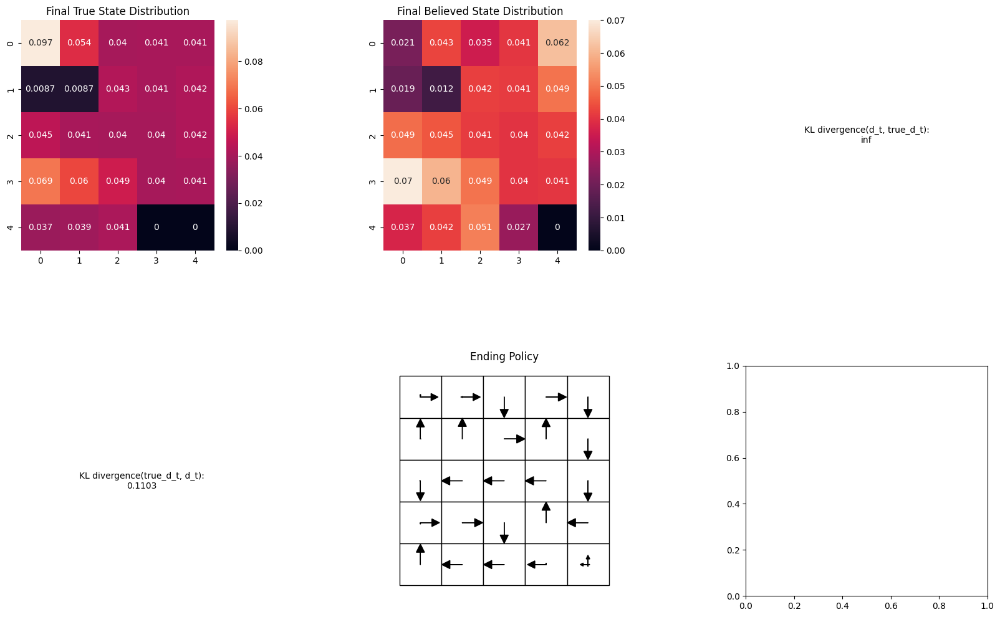

Run 0:  90%|██████████████████████████▏  | 9043/10000 [1:14:34<08:55,  1.79it/s]

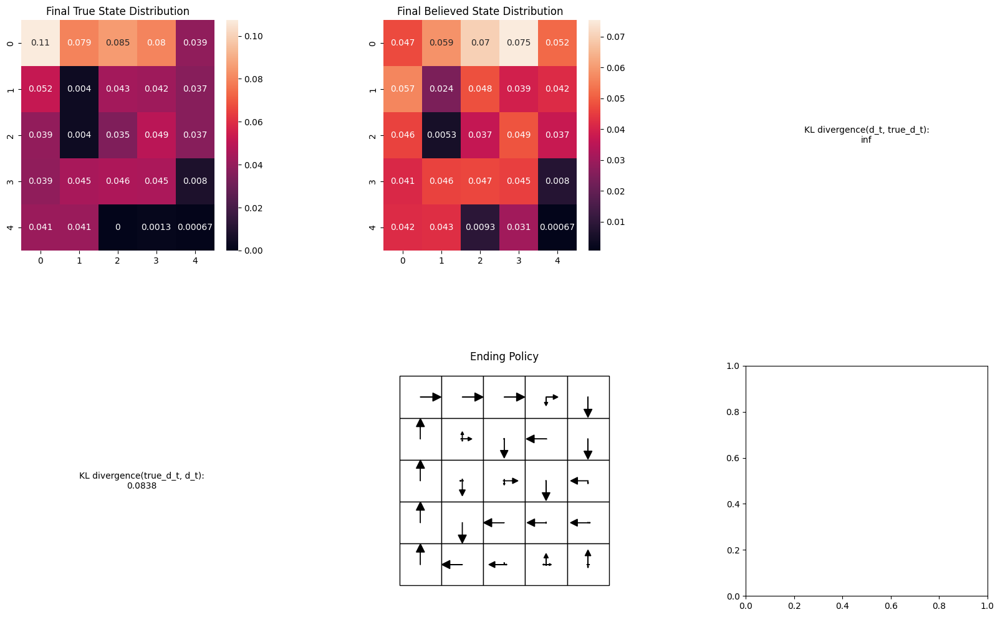

Run 0:  90%|██████████████████████████▏  | 9049/10000 [1:14:37<07:43,  2.05it/s]

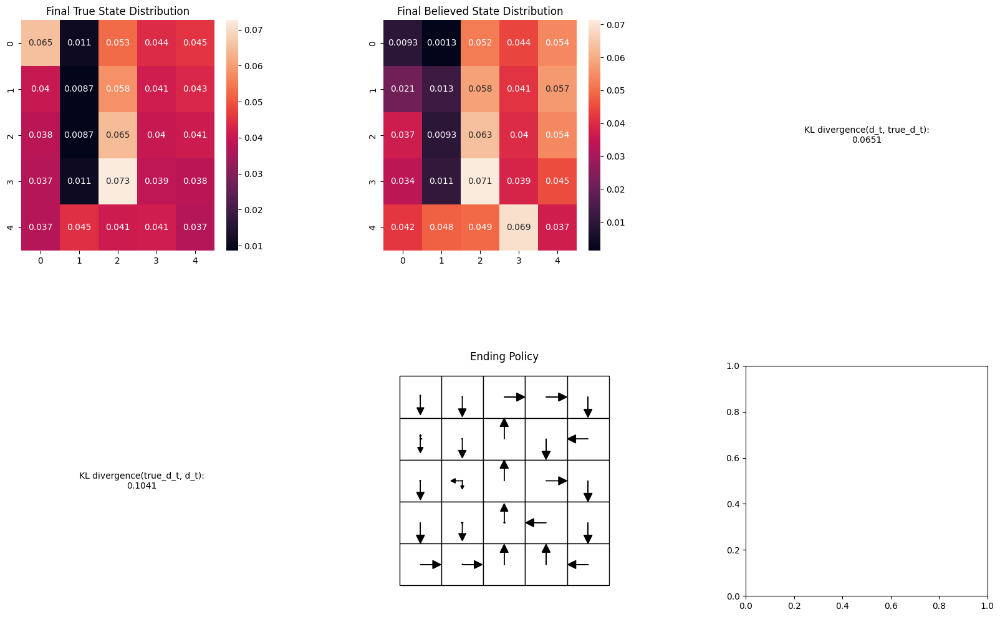

Run 0:  91%|██████████████████████████▎  | 9052/10000 [1:14:39<06:56,  2.28it/s]

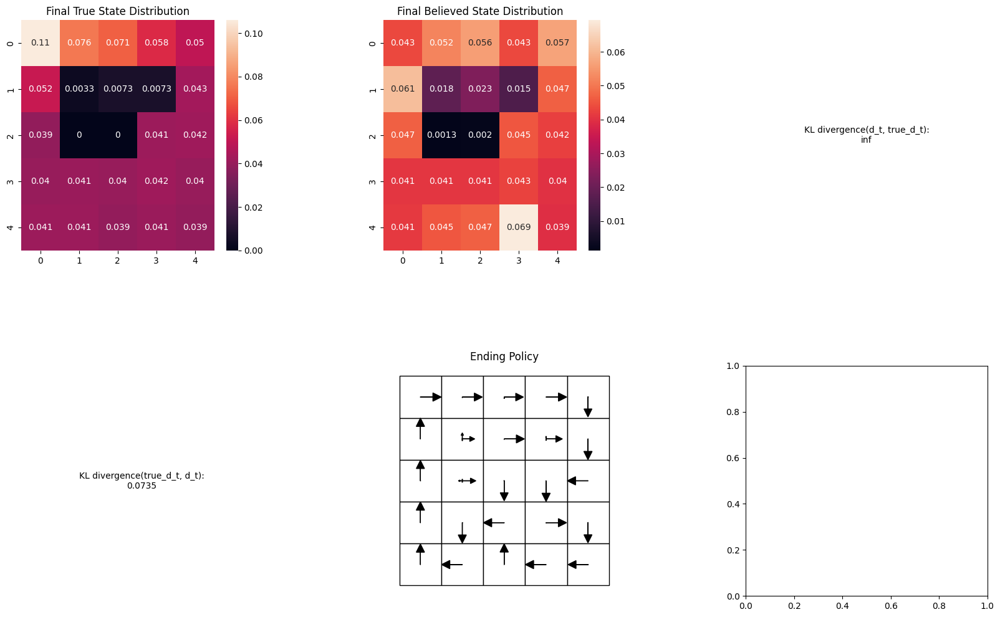

Run 0:  91%|██████████████████████████▎  | 9061/10000 [1:14:43<07:19,  2.14it/s]

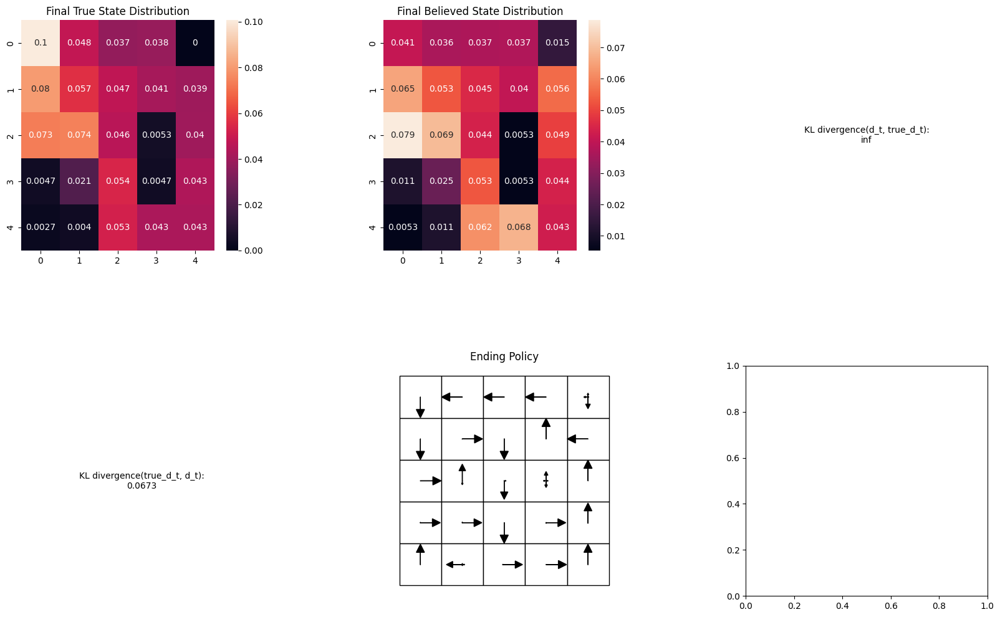

Run 0:  91%|██████████████████████████▎  | 9073/10000 [1:14:48<07:15,  2.13it/s]

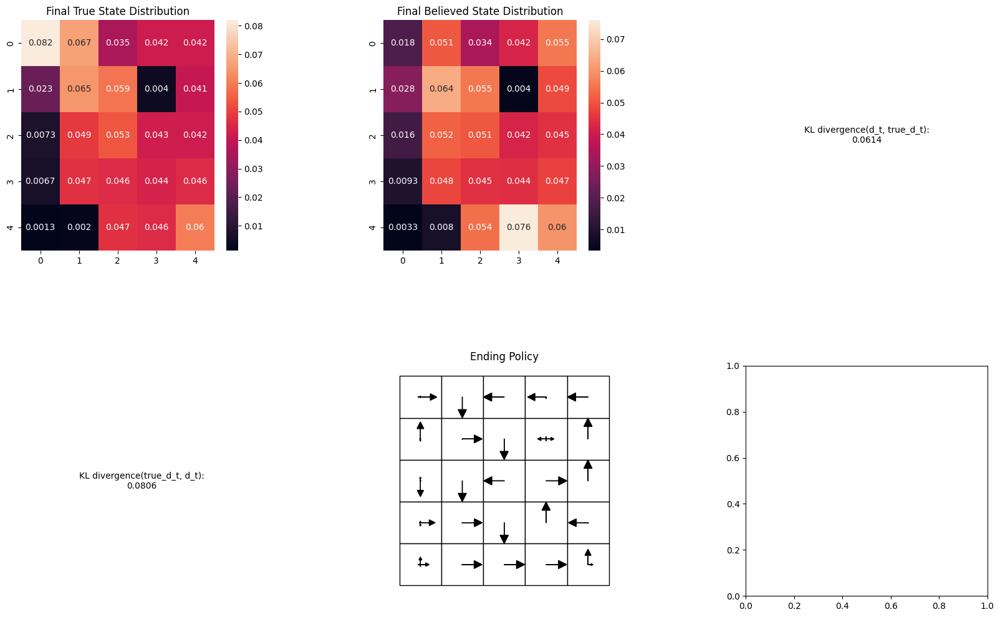

Run 0:  91%|██████████████████████████▎  | 9074/10000 [1:14:49<07:06,  2.17it/s]

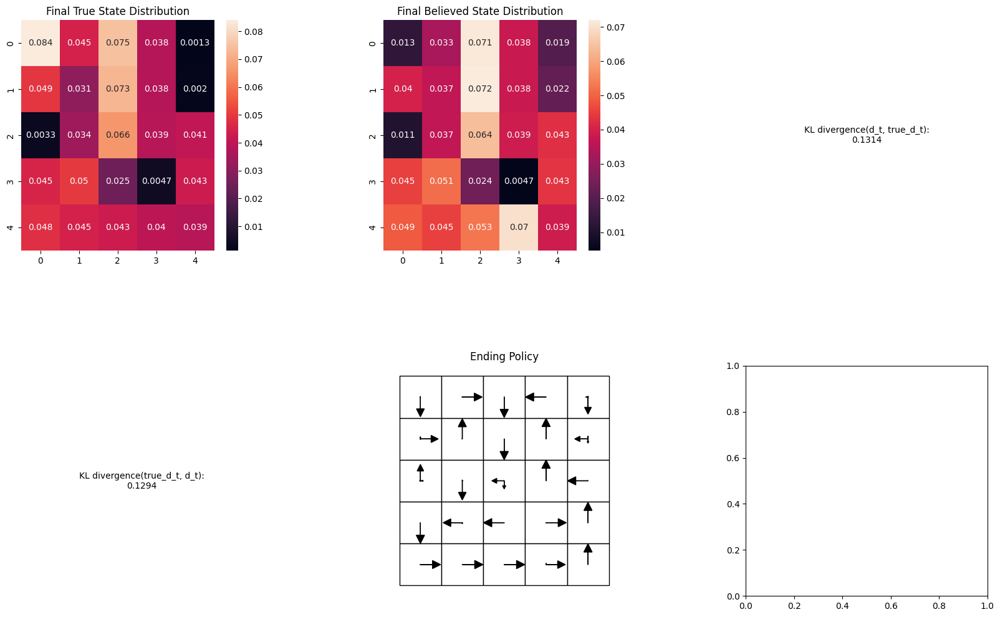

Run 0:  91%|██████████████████████████▎  | 9092/10000 [1:14:57<06:55,  2.18it/s]

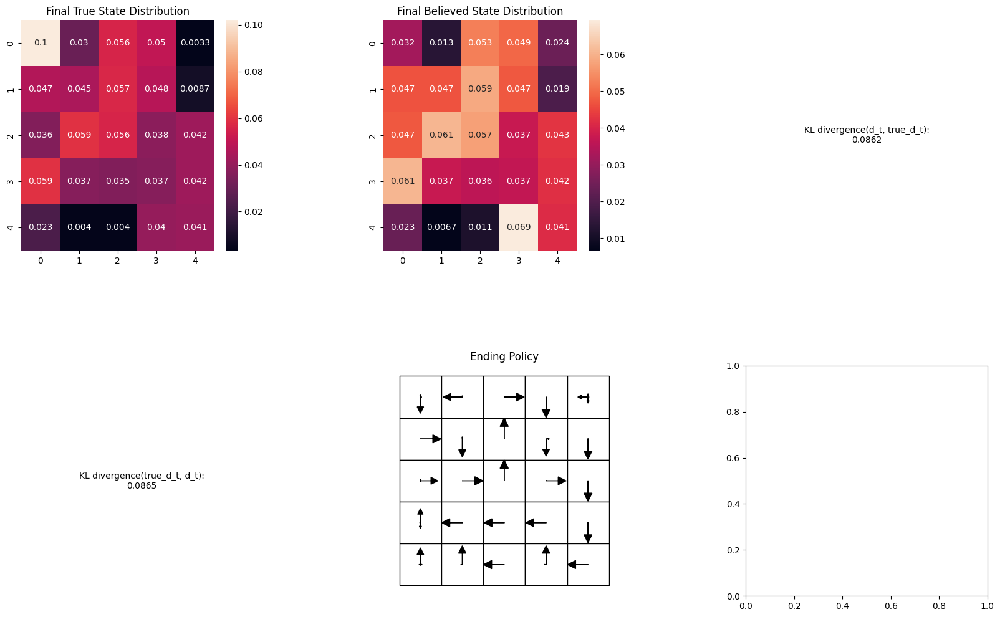

Run 0:  91%|██████████████████████████▍  | 9101/10000 [1:15:01<06:39,  2.25it/s]

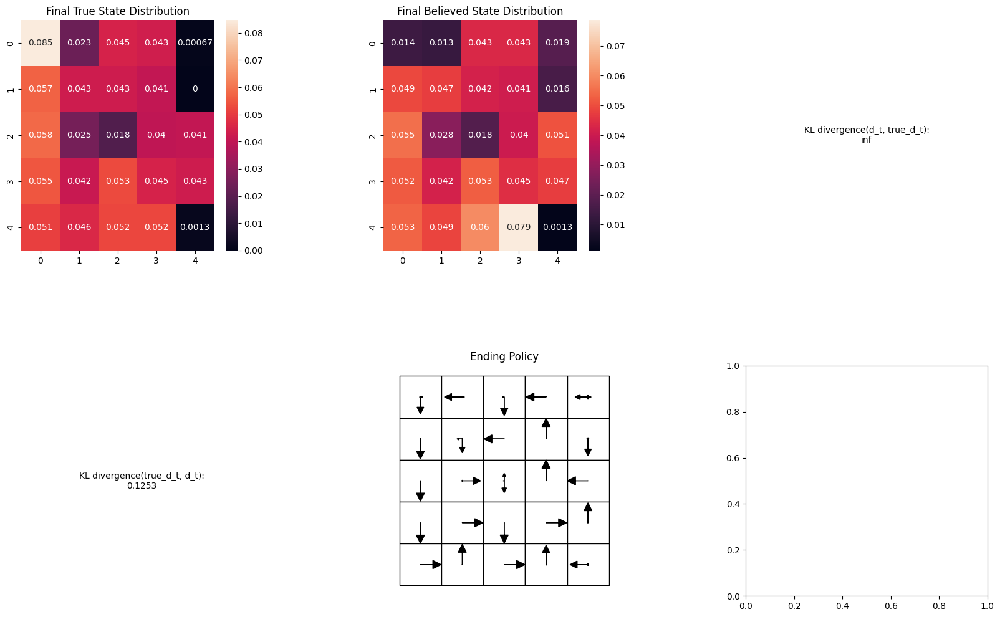

Run 0: 100%|████████████████████████████| 10000/10000 [1:21:02<00:00,  2.06it/s]


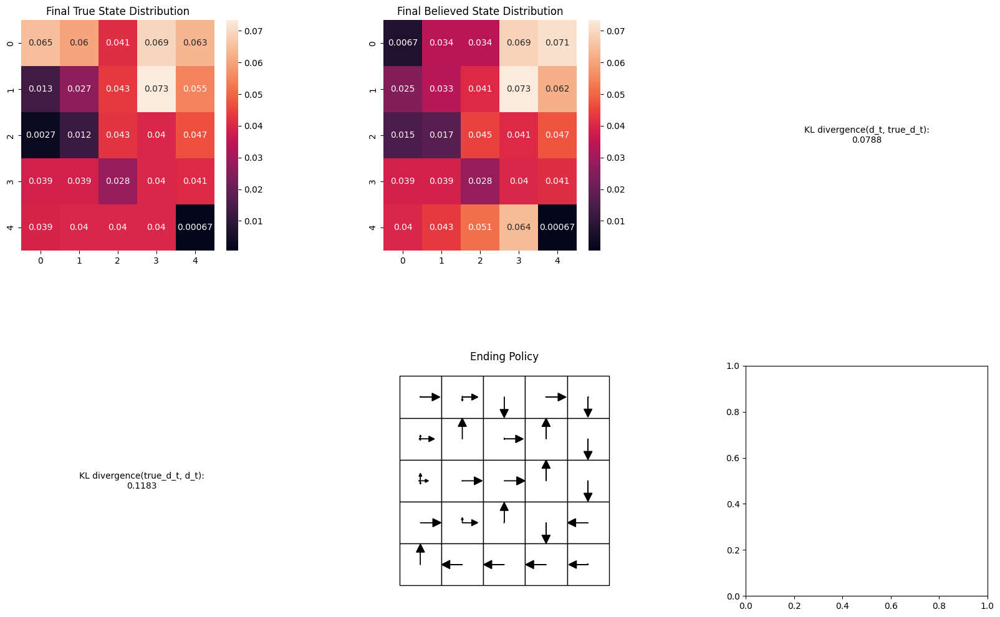

Stochastic Learned mean: 2.7694968521730754


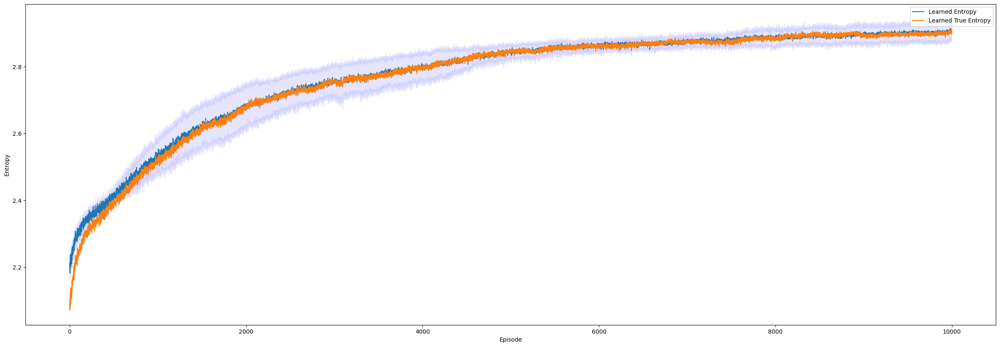

In [23]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0
randomize=0
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP")
tail = n_episodes*0.95
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

## Deterministic Entropy POMDP Random Initial Position

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:  98%|████████████████████████████▎| 9751/10000 [1:06:32<01:55,  2.16it/s]

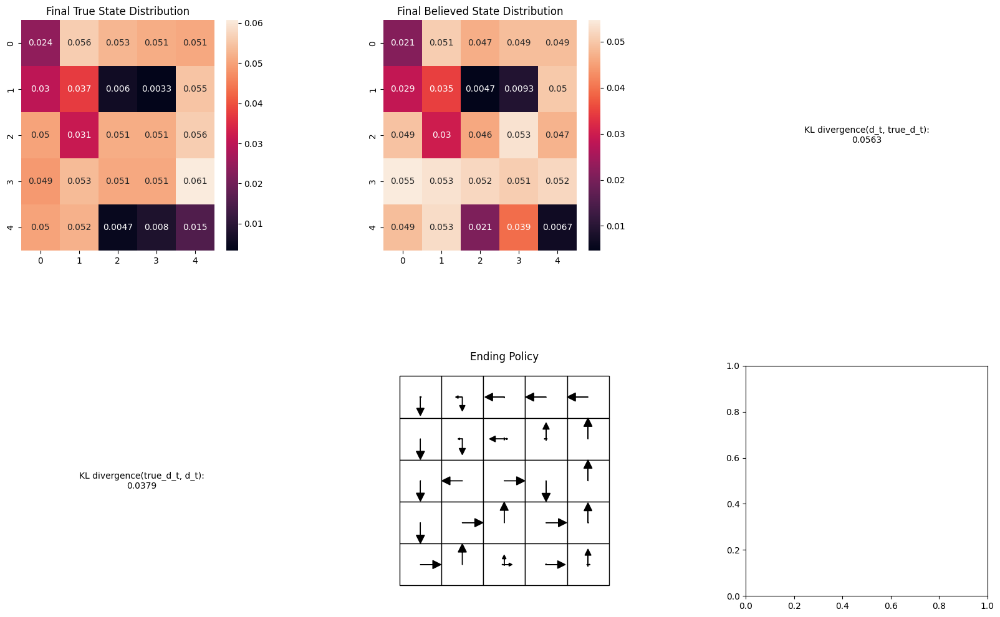

Run 0:  98%|████████████████████████████▎| 9754/10000 [1:06:34<01:48,  2.26it/s]

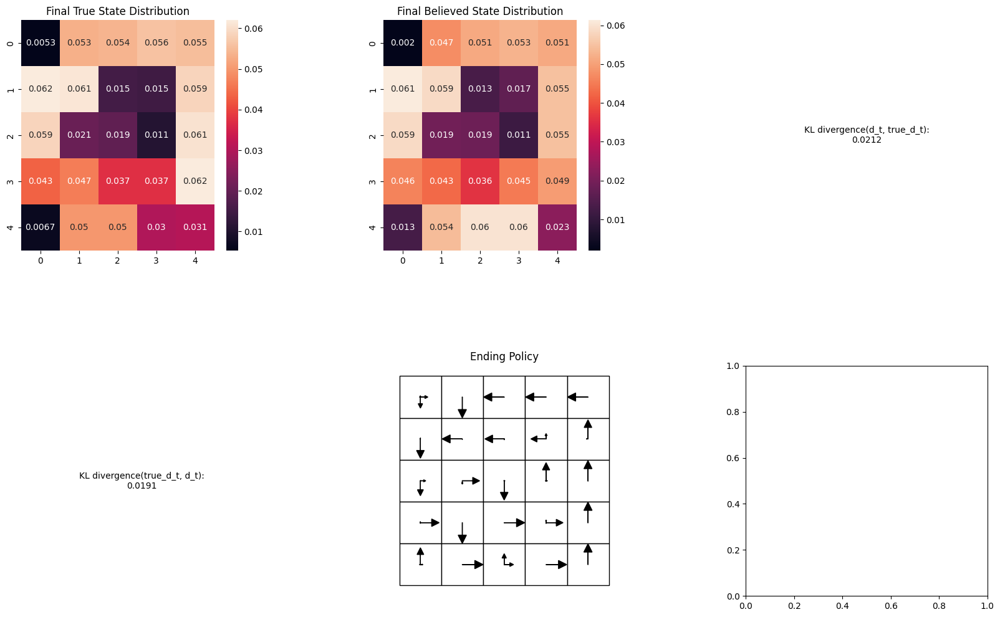

Run 0:  98%|████████████████████████████▎| 9774/10000 [1:06:42<01:36,  2.34it/s]

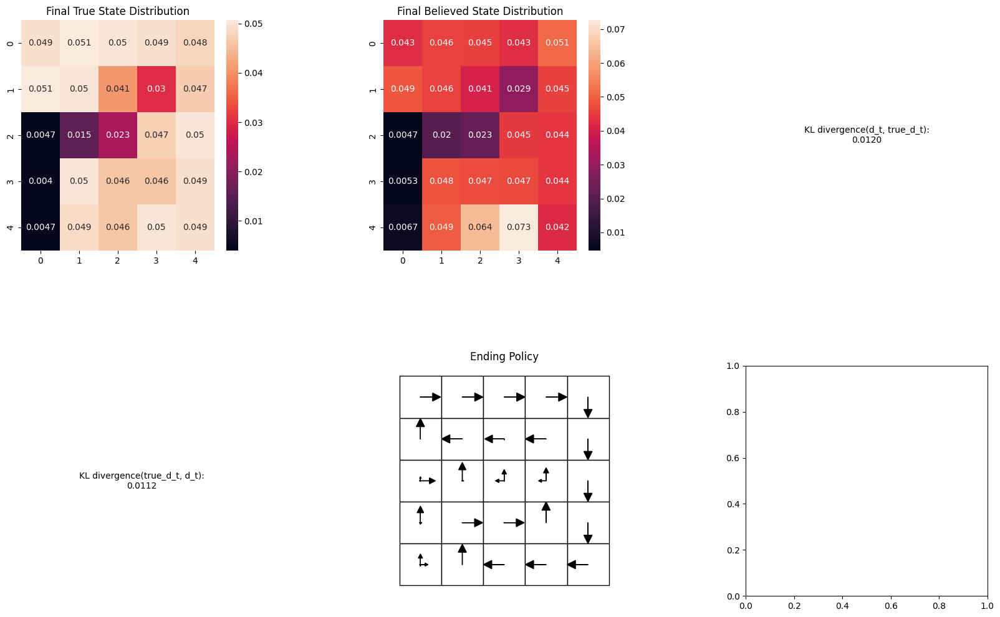

Run 0:  98%|████████████████████████████▎| 9780/10000 [1:06:45<01:32,  2.39it/s]

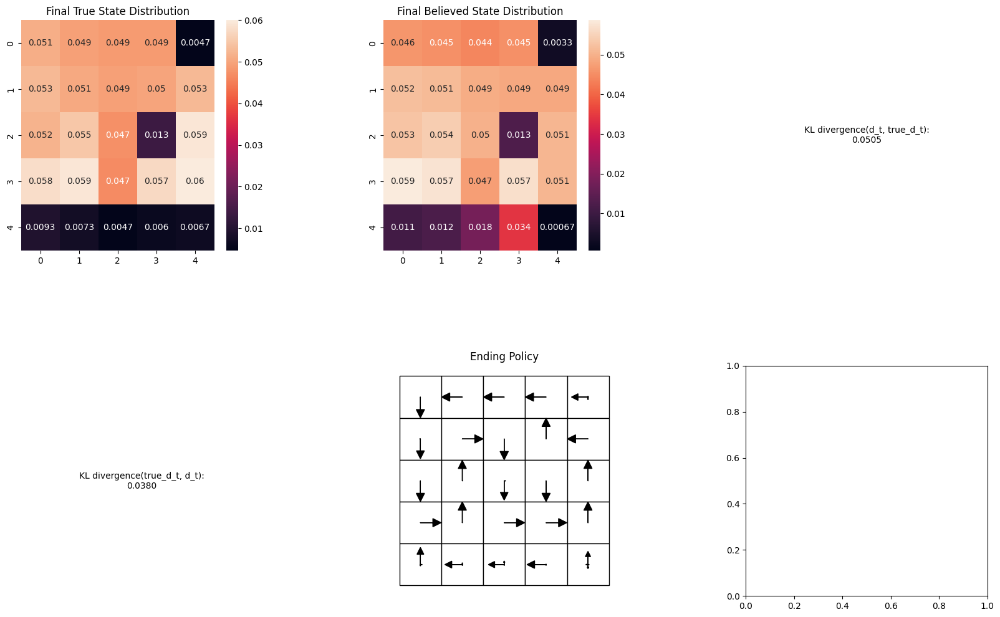

Run 0:  98%|████████████████████████████▍| 9797/10000 [1:06:52<01:32,  2.19it/s]

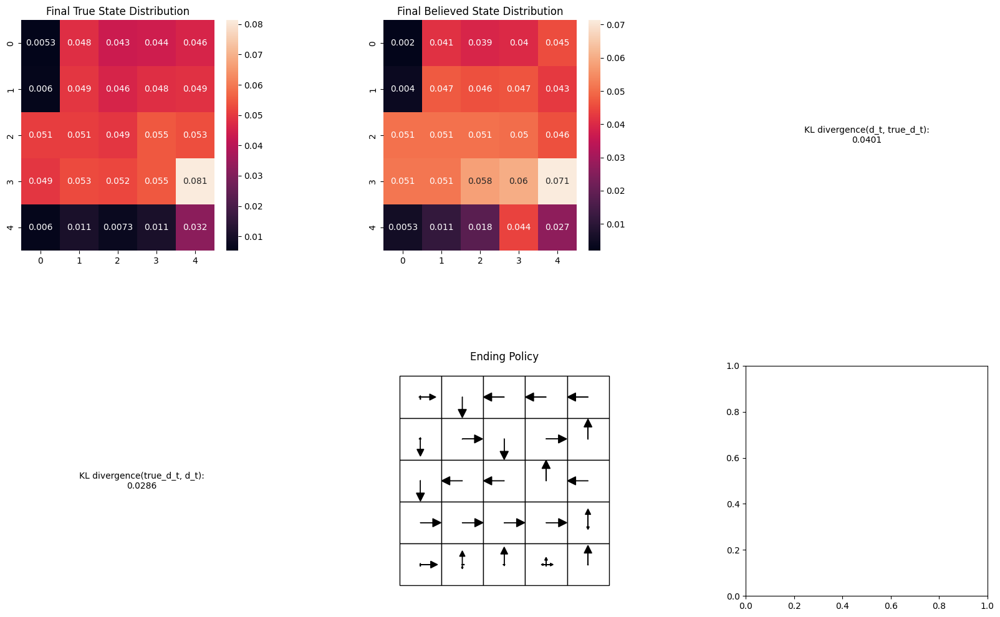

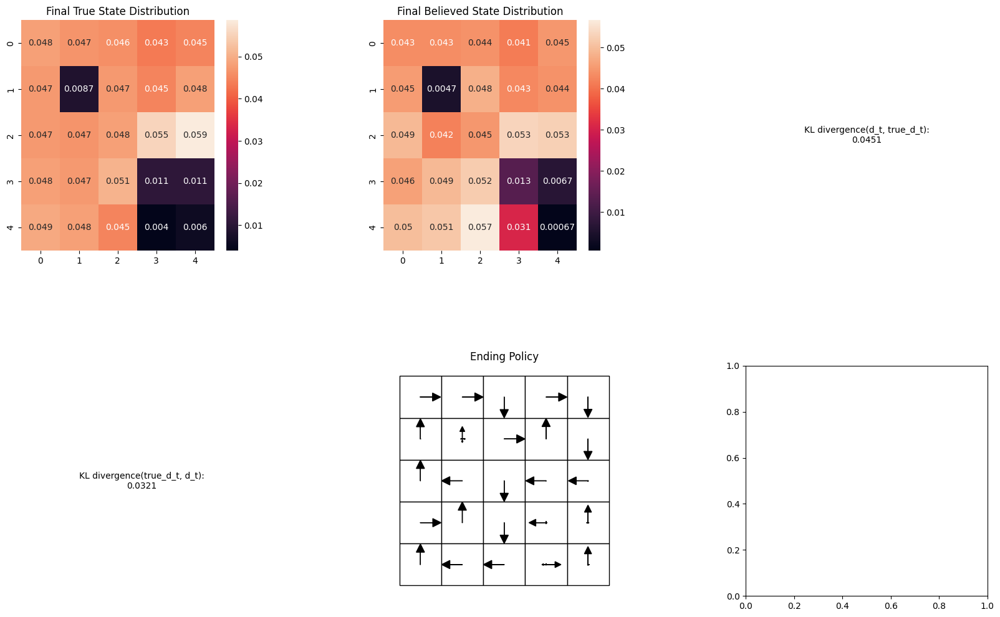

Run 0:  98%|████████████████████████████▍| 9819/10000 [1:07:02<01:16,  2.35it/s]

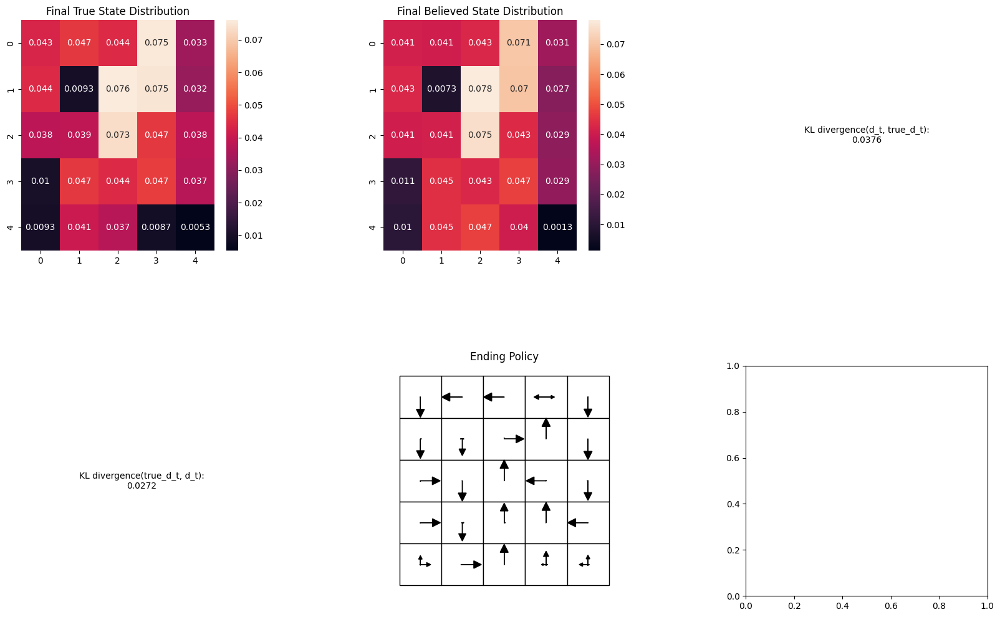

Run 0:  98%|████████████████████████████▍| 9821/10000 [1:07:03<01:14,  2.40it/s]

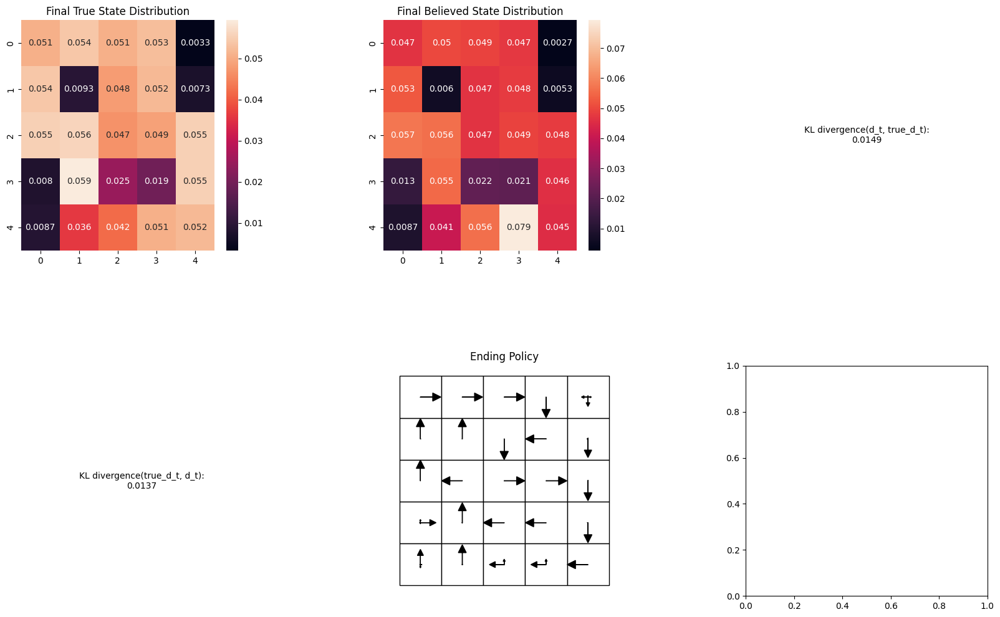

Run 0:  98%|████████████████████████████▍| 9827/10000 [1:07:05<01:09,  2.48it/s]

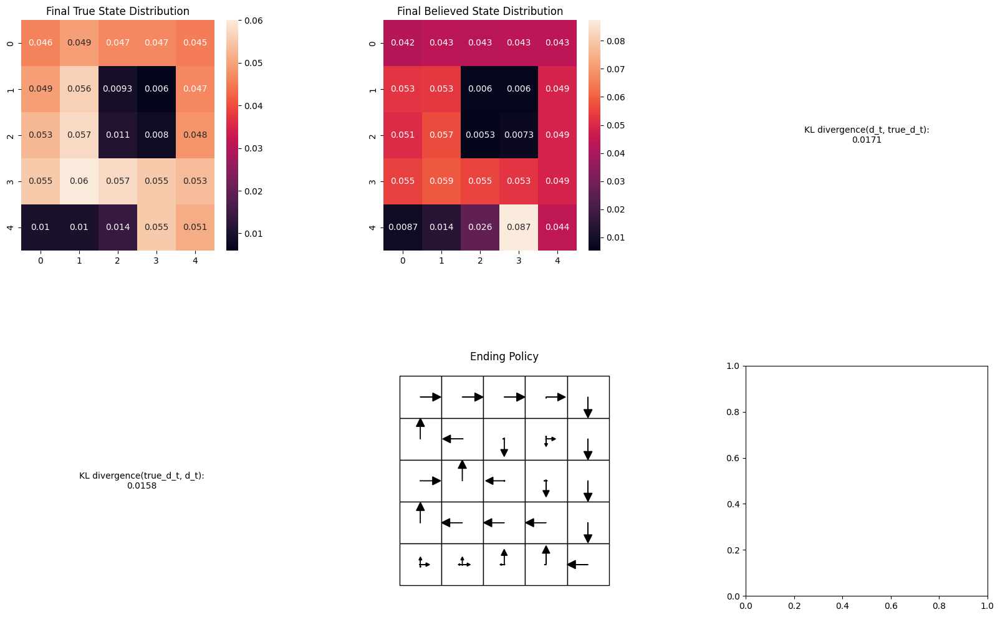

Run 0: 100%|████████████████████████████| 10000/10000 [1:08:13<00:00,  2.44it/s]


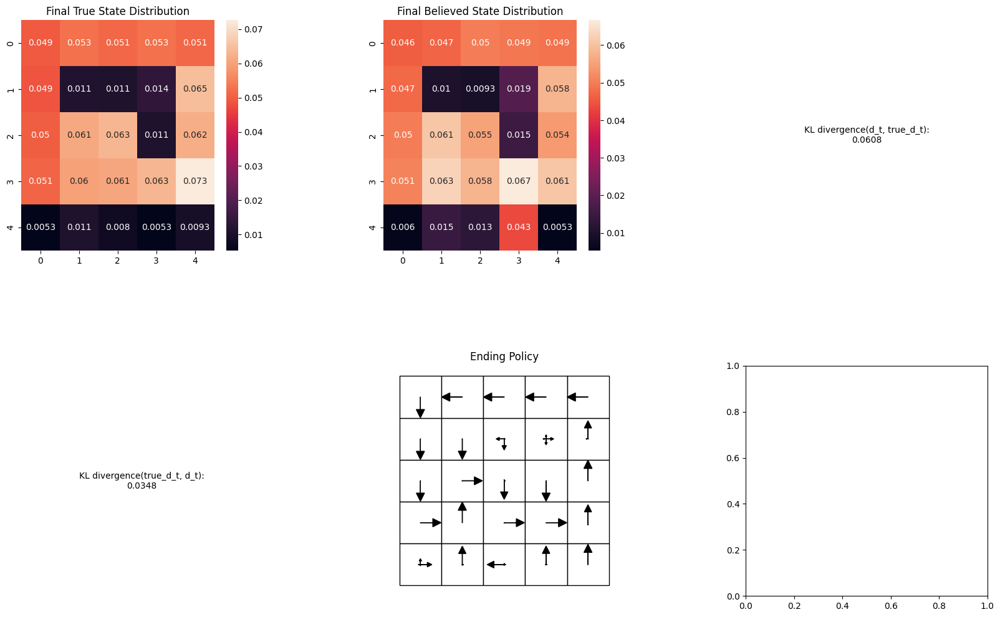

TypeError: slice indices must be integers or None or have an __index__ method

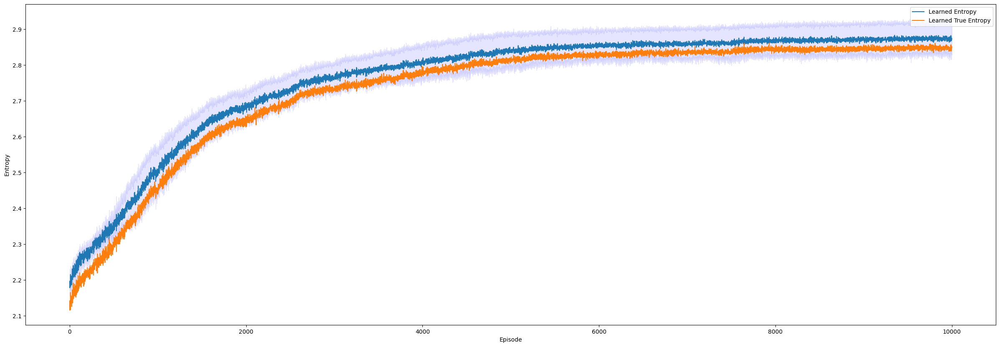

In [24]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 4
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0
randomize=1
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP random initial position")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

In [25]:
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

Stochastic Learned mean: 2.847840447849765


## Deterministic Entropy POMDP, Longer Time Horizon

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0: 100%|█████████████████████████████▉| 5984/6000 [1:17:26<00:12,  1.31it/s]

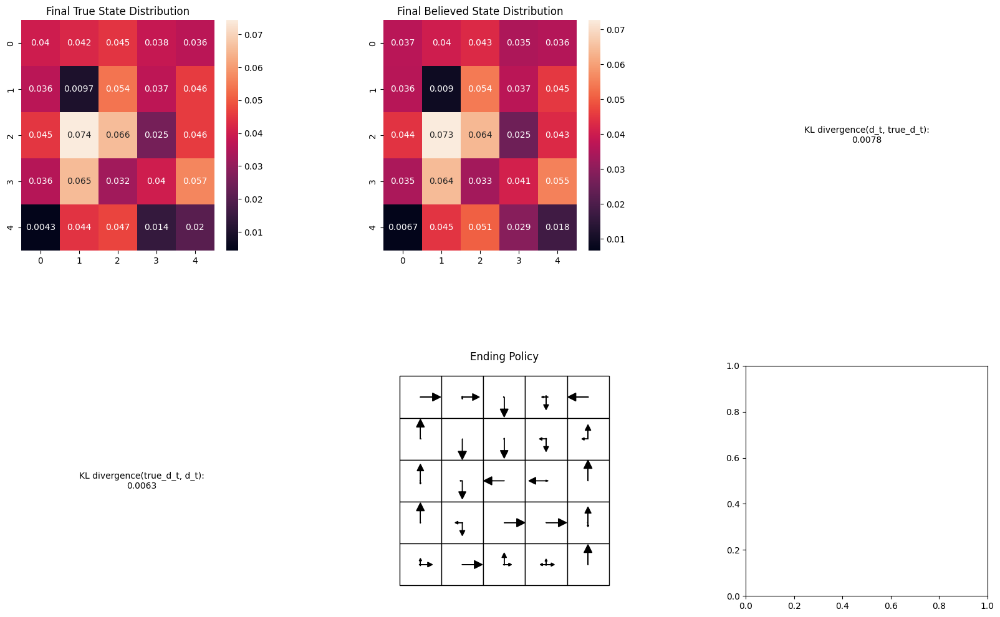

Run 0: 100%|██████████████████████████████| 6000/6000 [1:17:38<00:00,  1.29it/s]


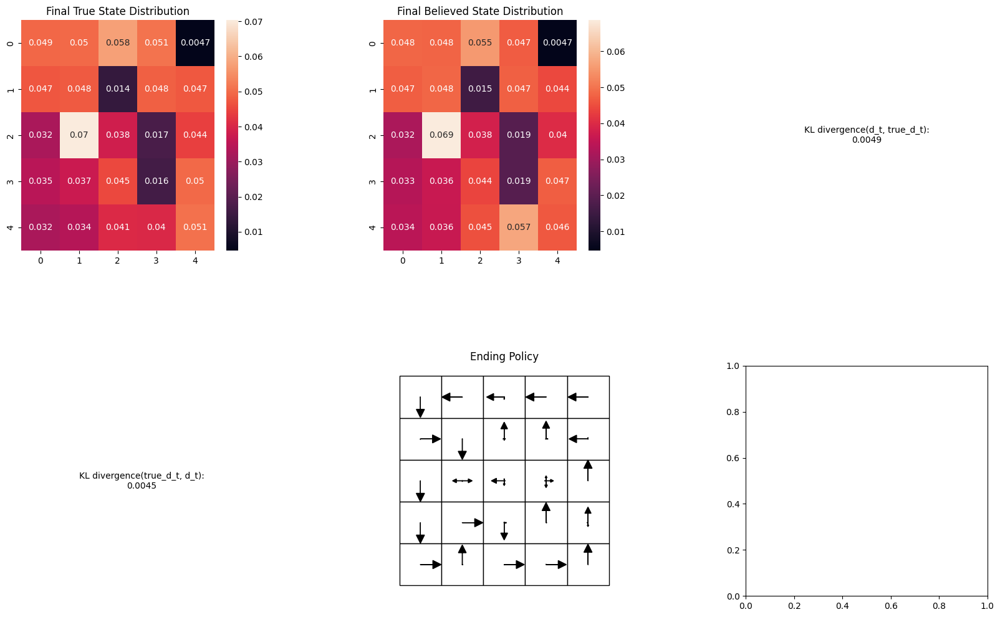

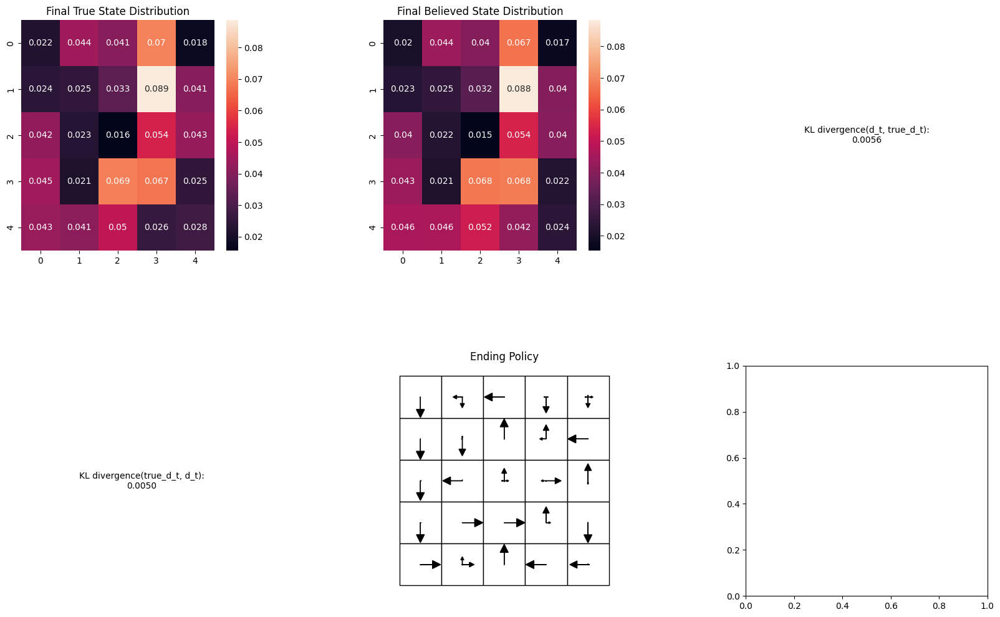

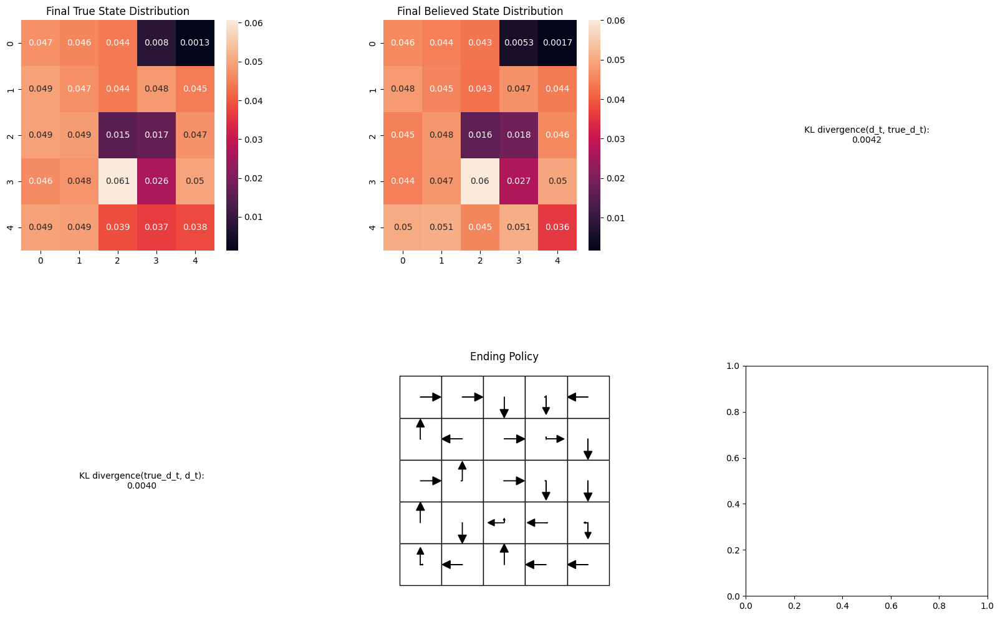

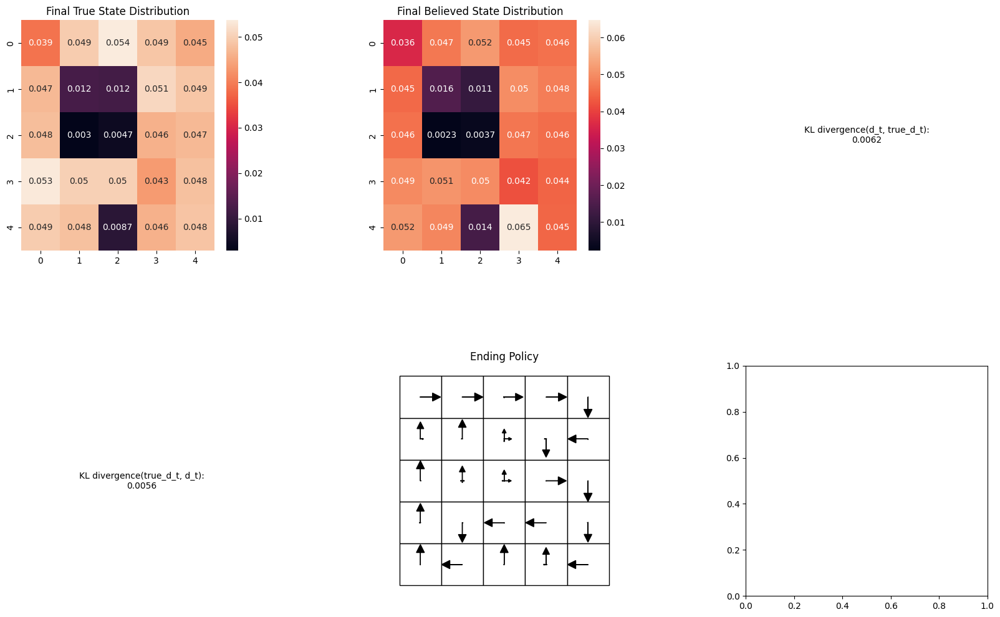

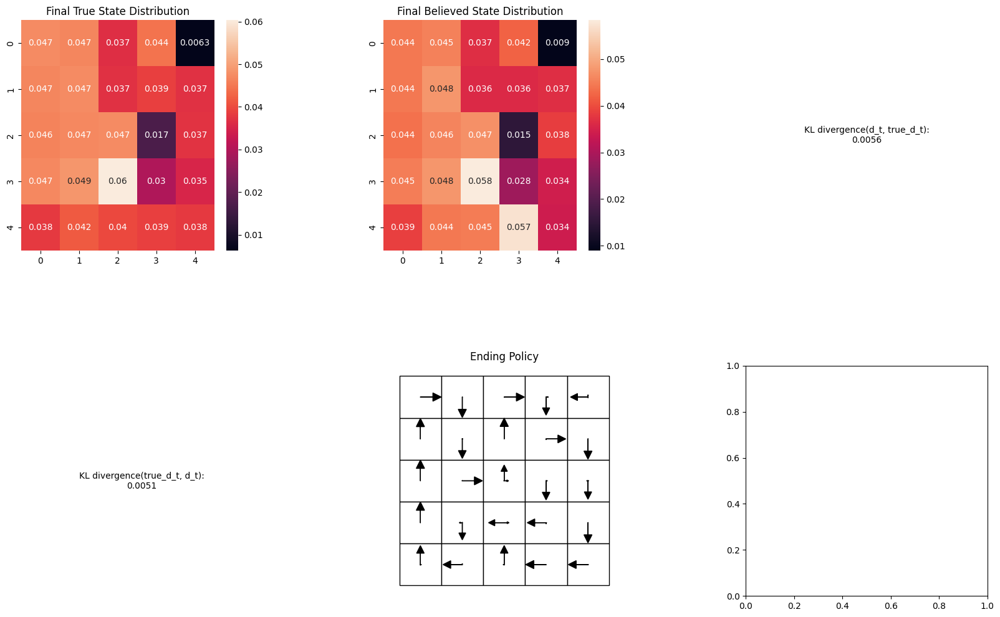

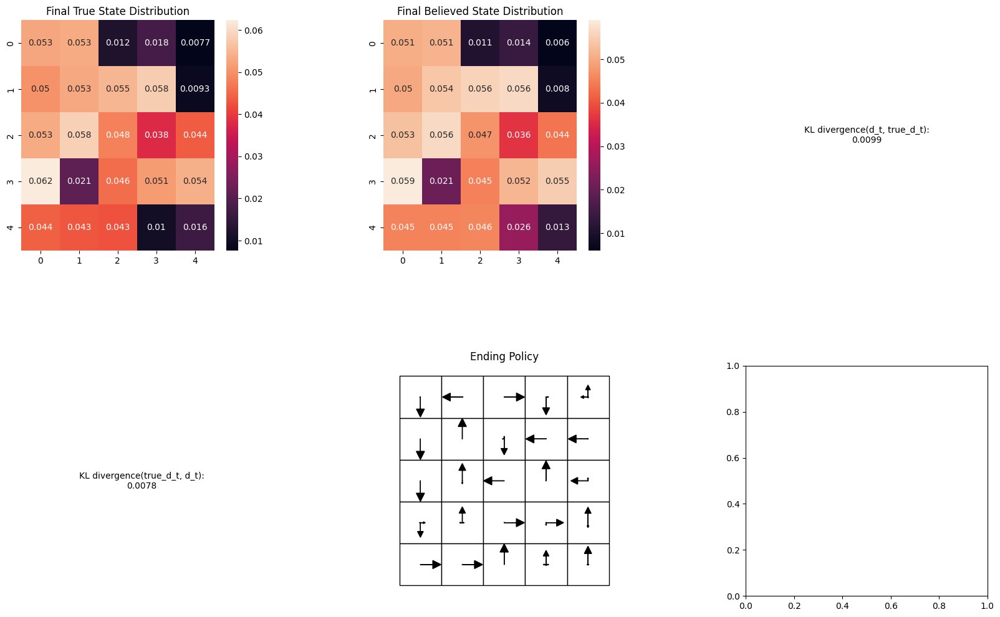

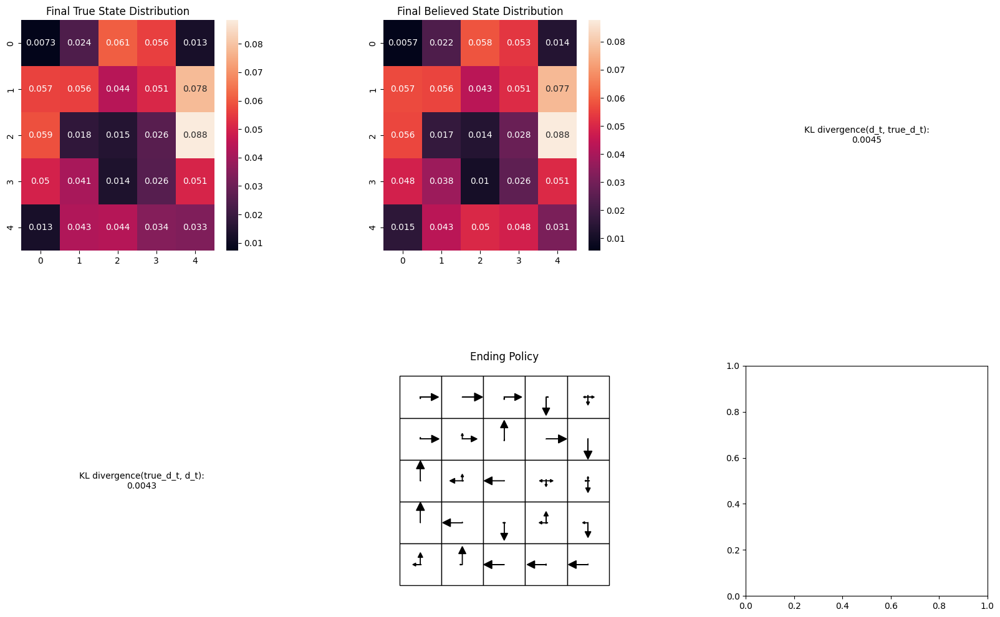

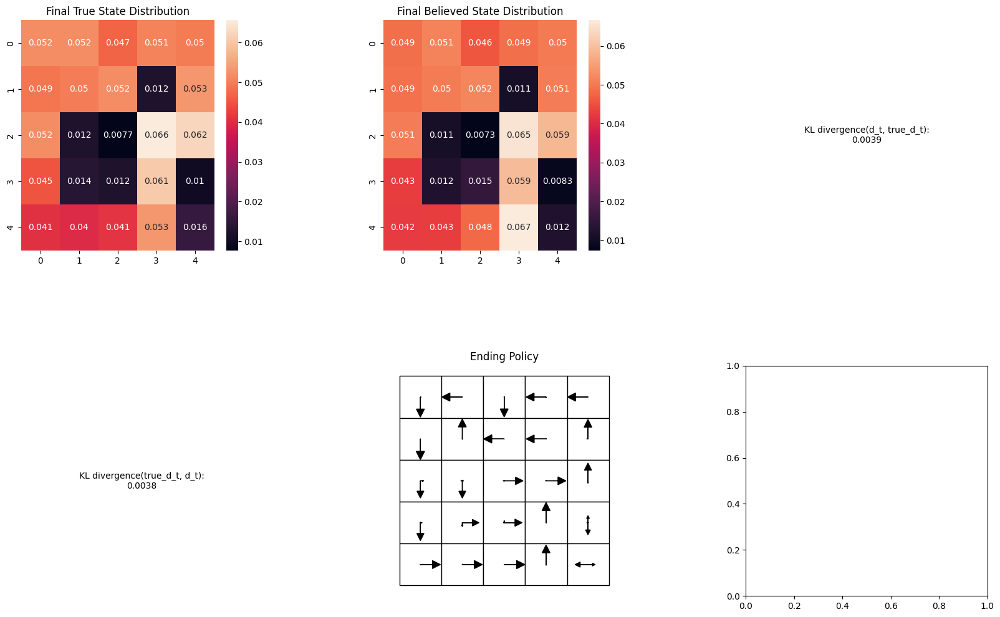

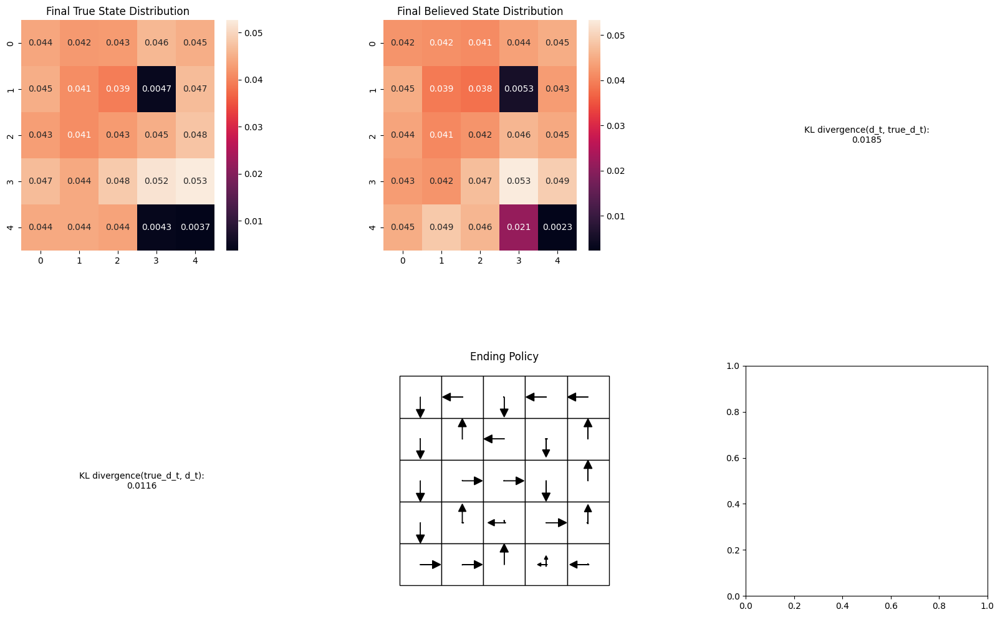

Stochastic Learned mean: 2.9814663404878066


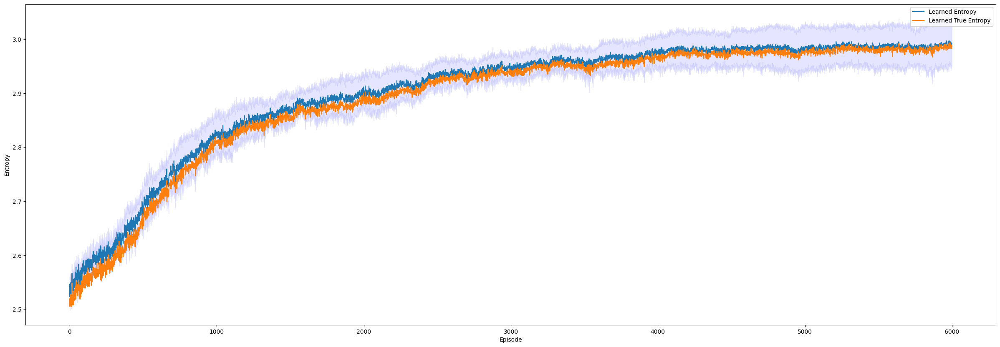

In [5]:
# Number of episodes for the training
n_episodes = 6000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 50
steepness=15
prob=0
randomize=1
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP longer time_horizon")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[5500:])))

## Stochastic Entropy POMDP

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                           | 0/8000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

Run 0: 100%|███████████████████████████████▊| 7965/8000 [51:43<00:13,  2.59it/s]

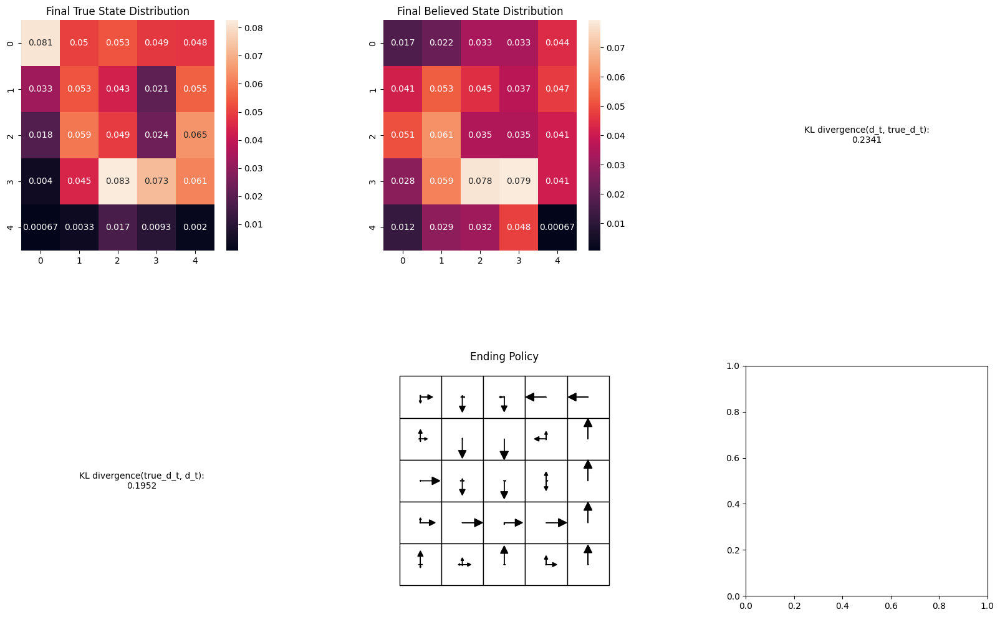

Run 0: 100%|████████████████████████████████| 8000/8000 [51:56<00:00,  2.57it/s]


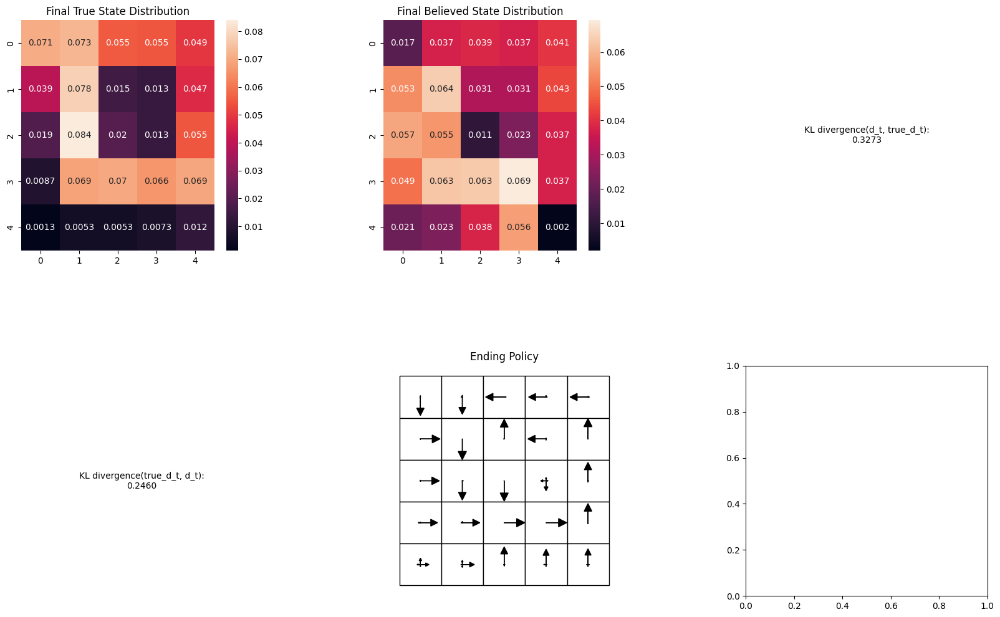

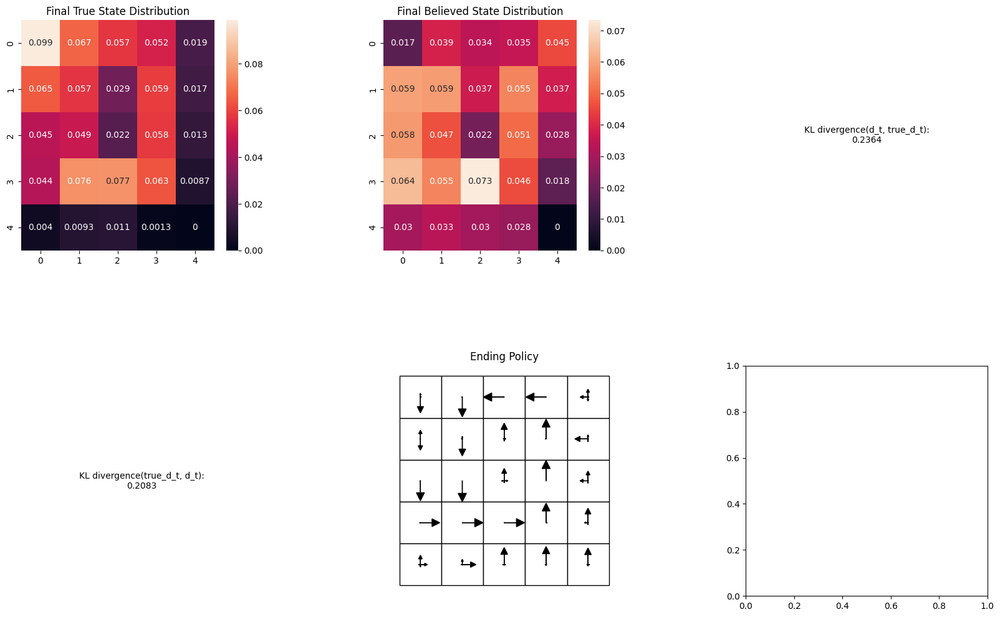

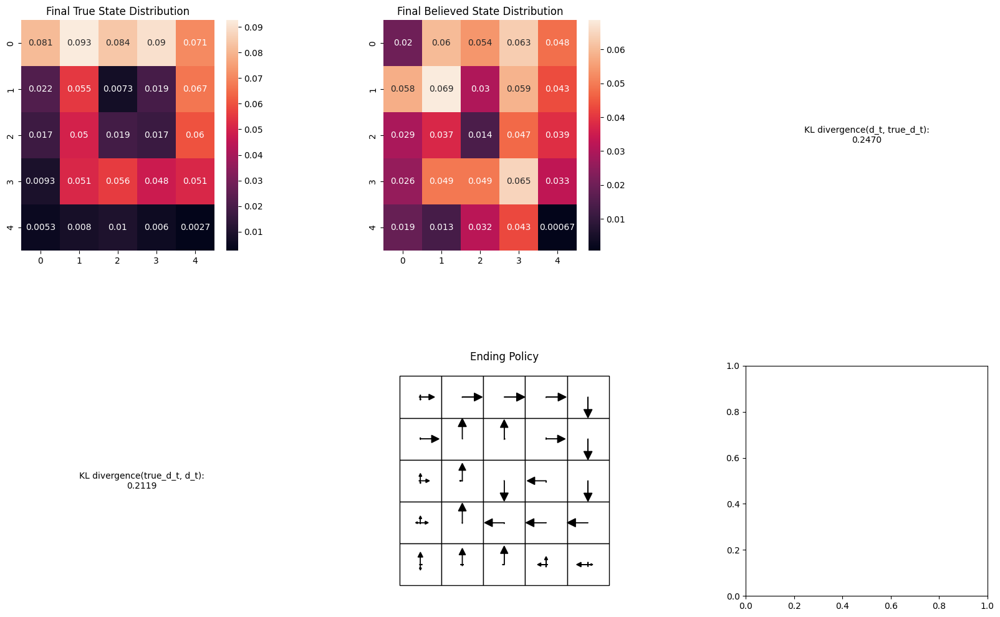

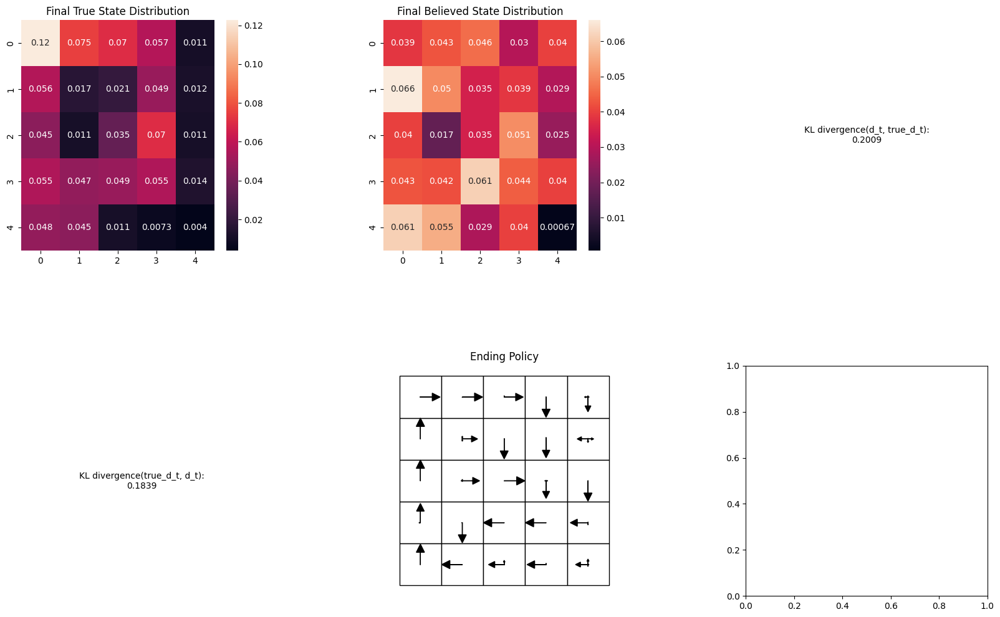

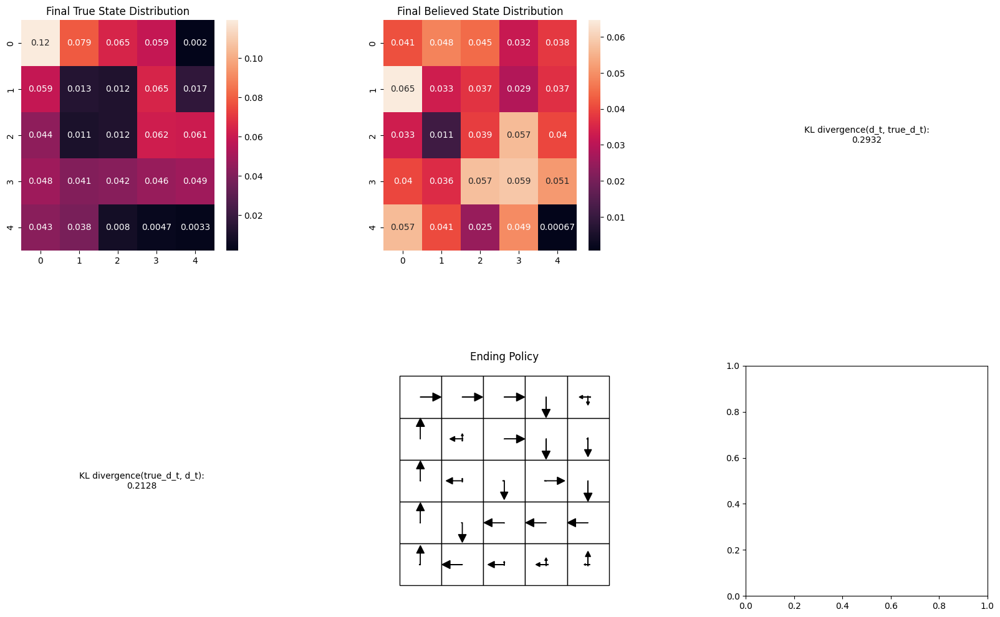

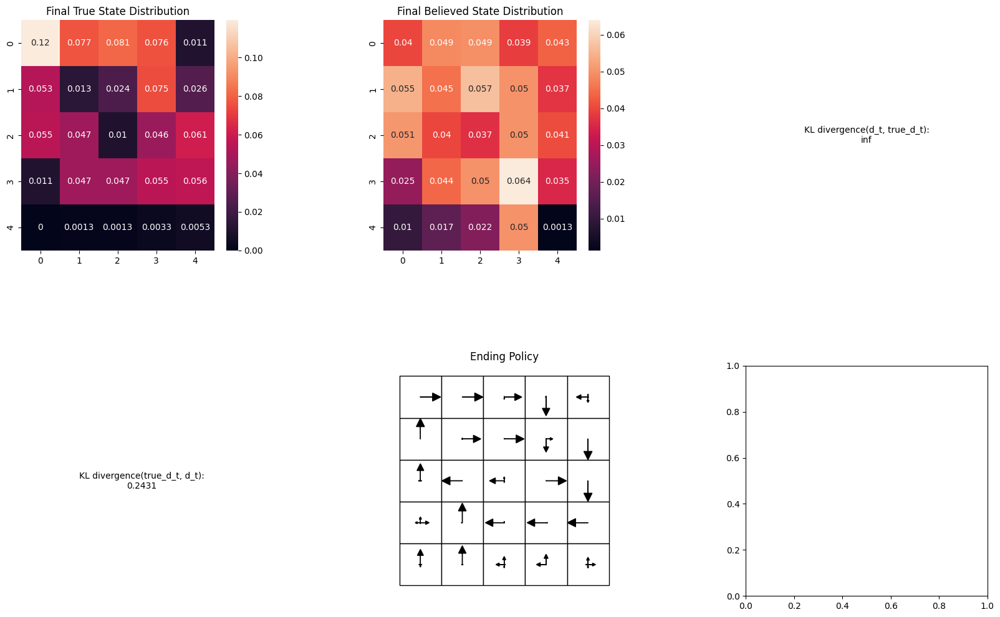

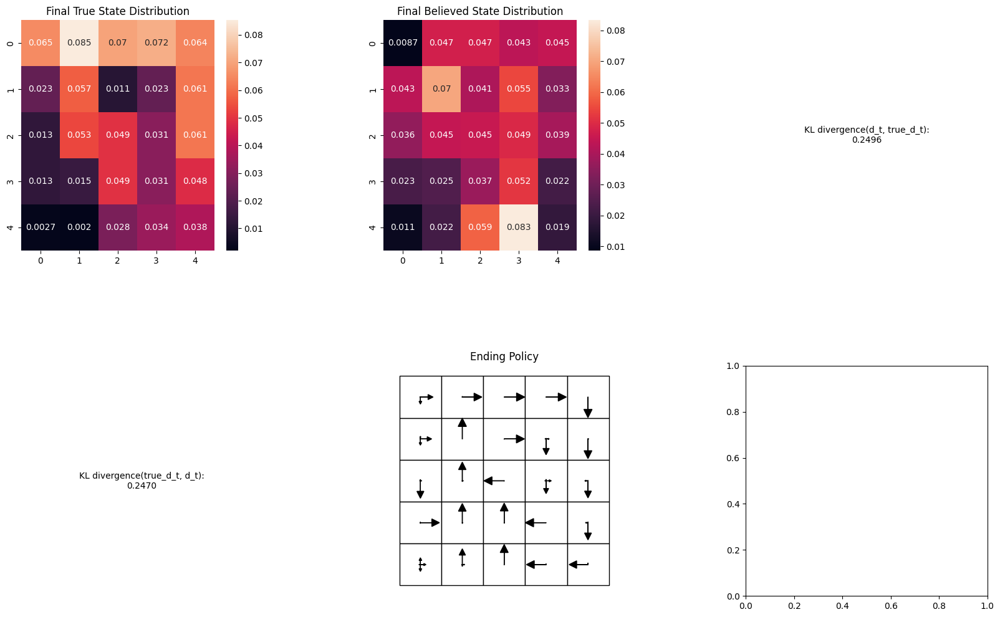

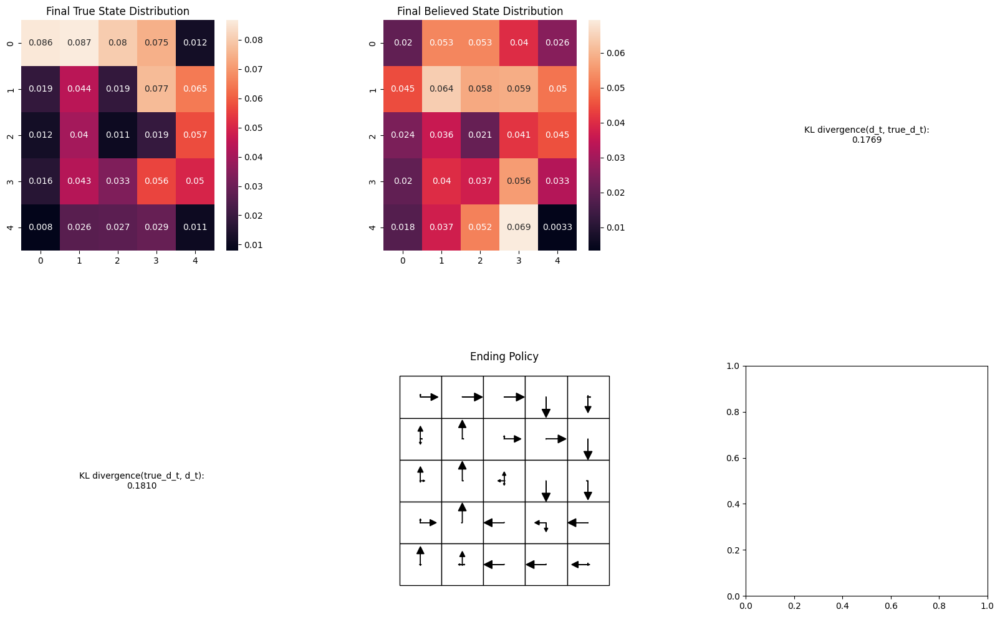

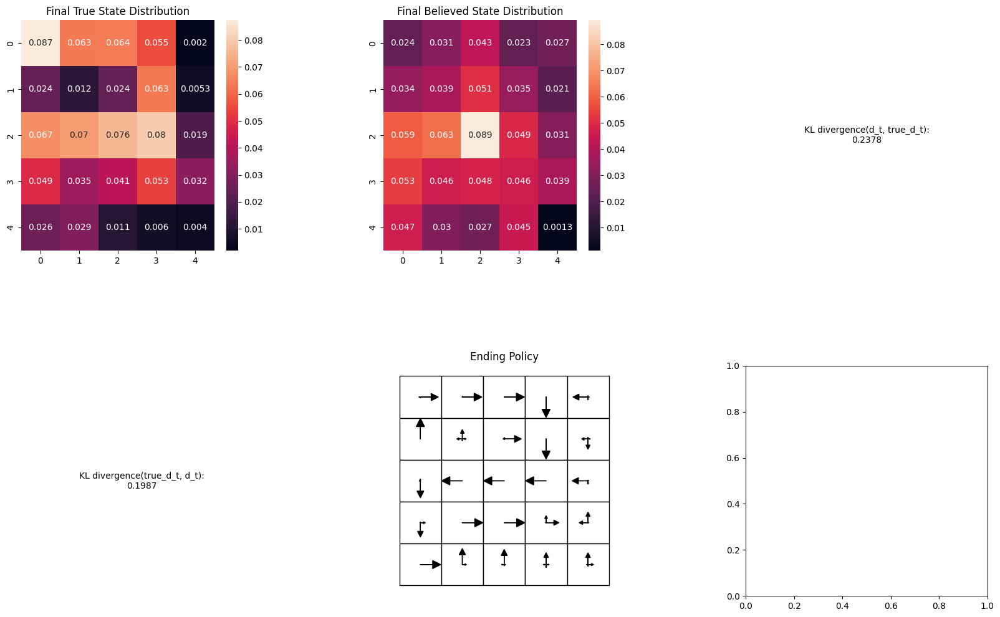

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Stochastic Learned mean: nan


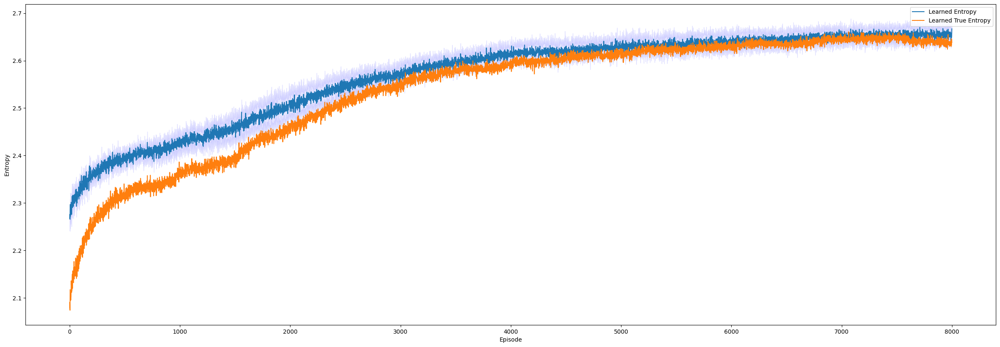

In [6]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0.1
randomize=0
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

## Stochastic Entropy POMDP with Random Initial Position

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

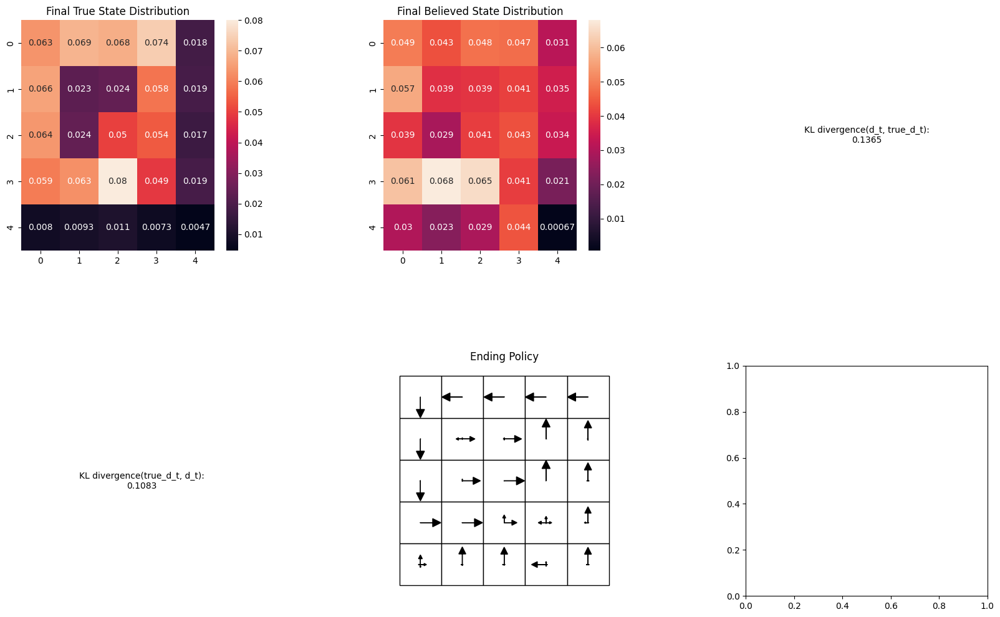

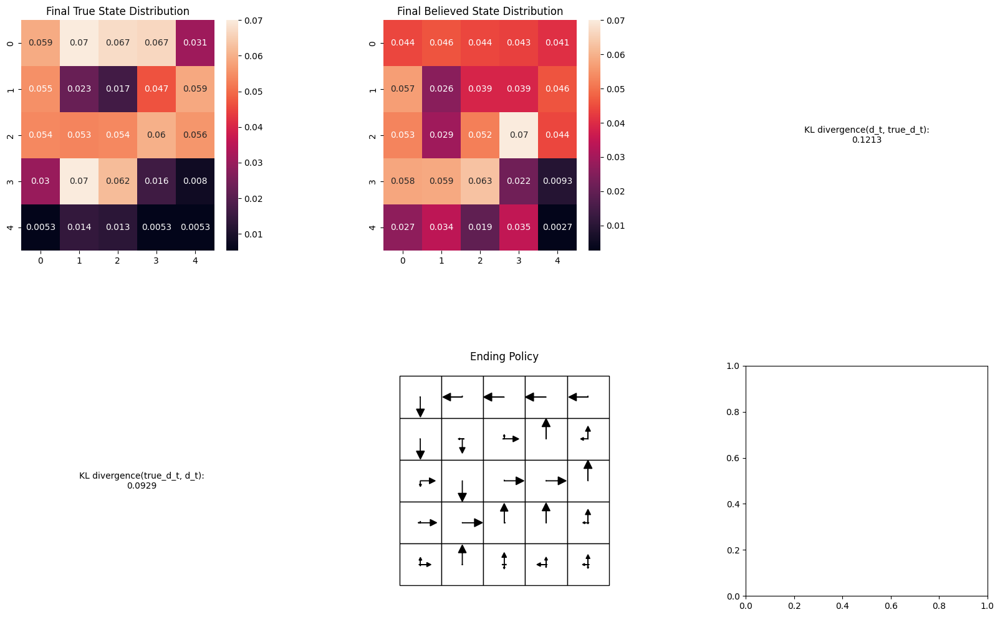

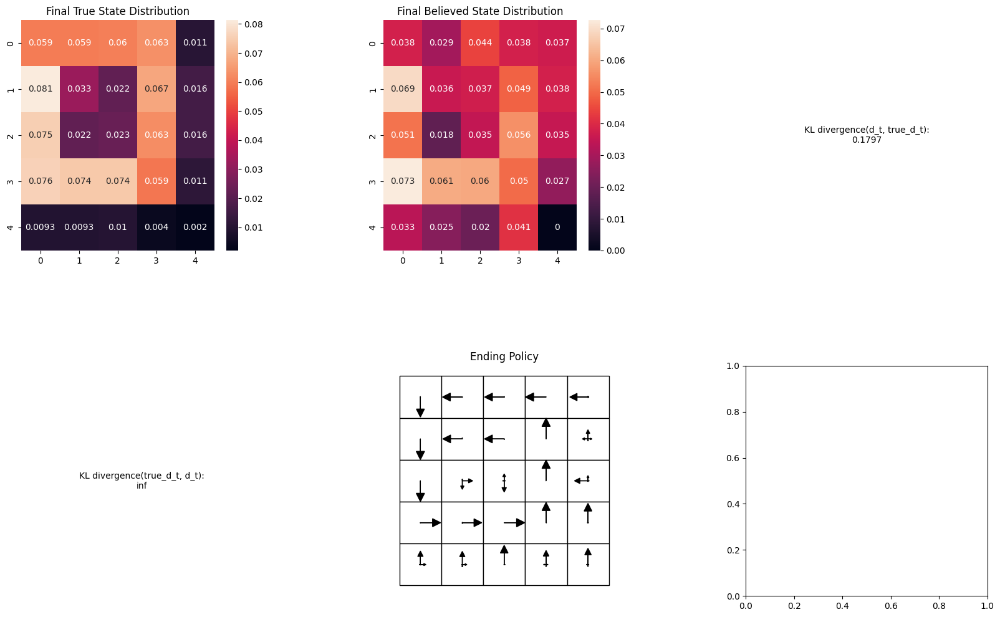

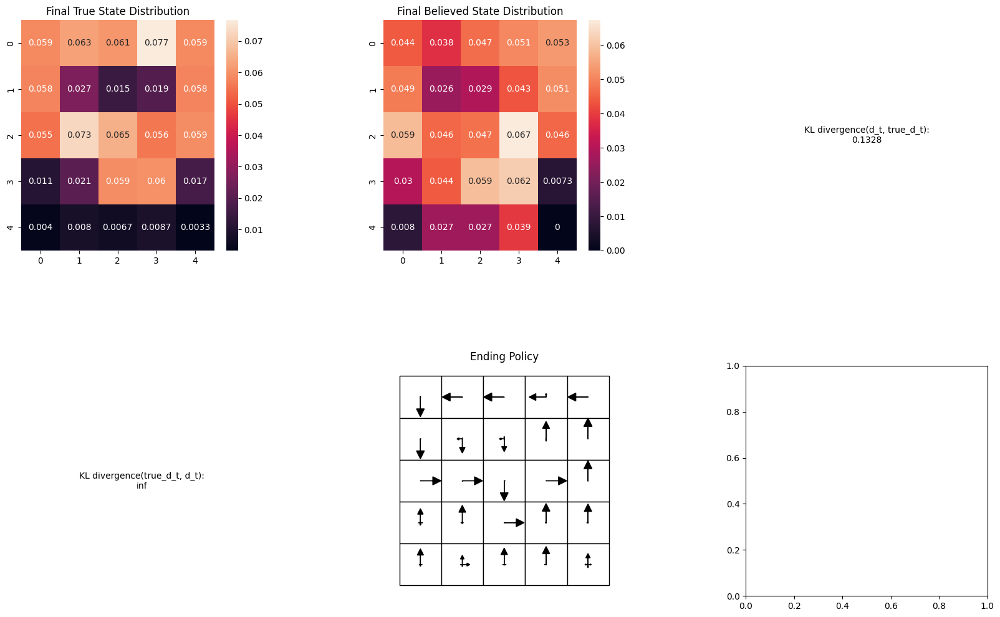

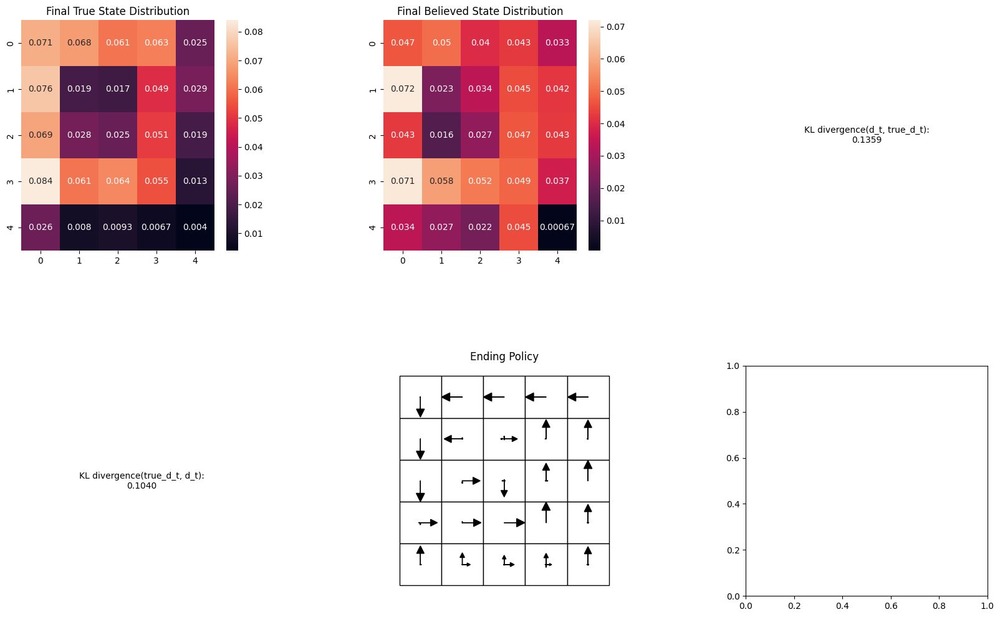

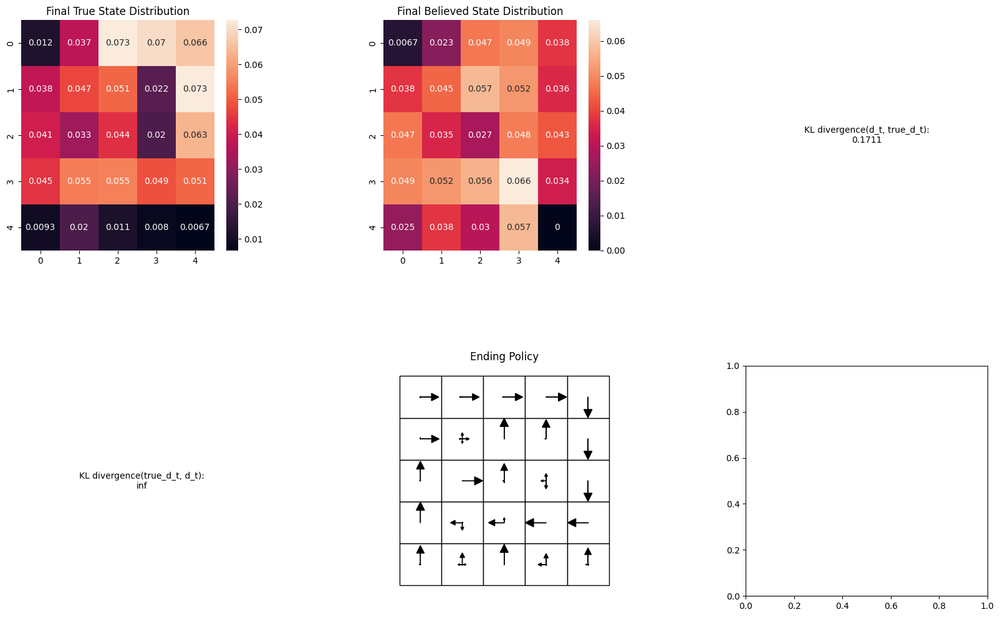

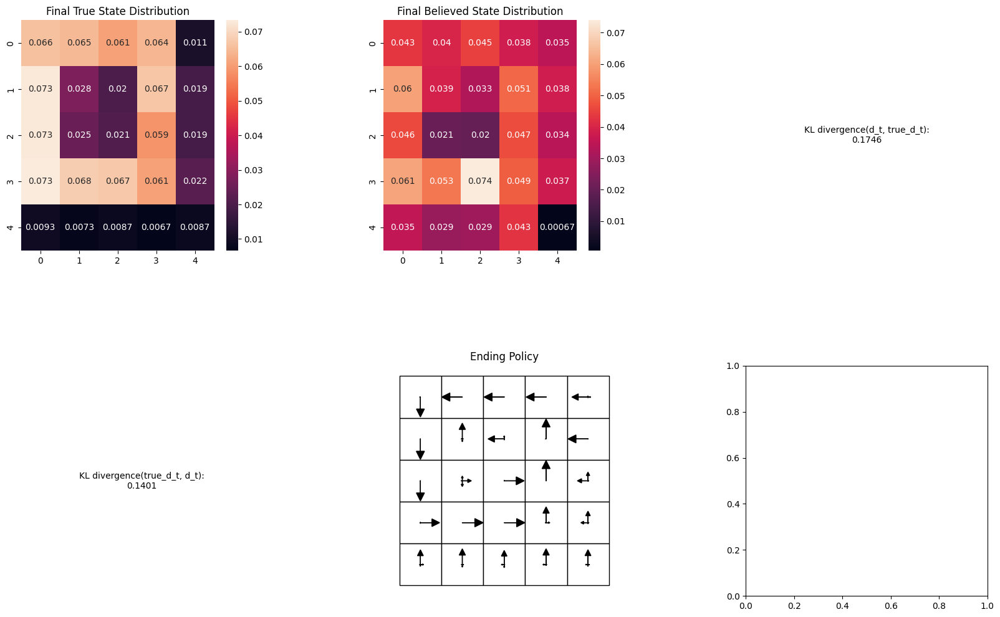

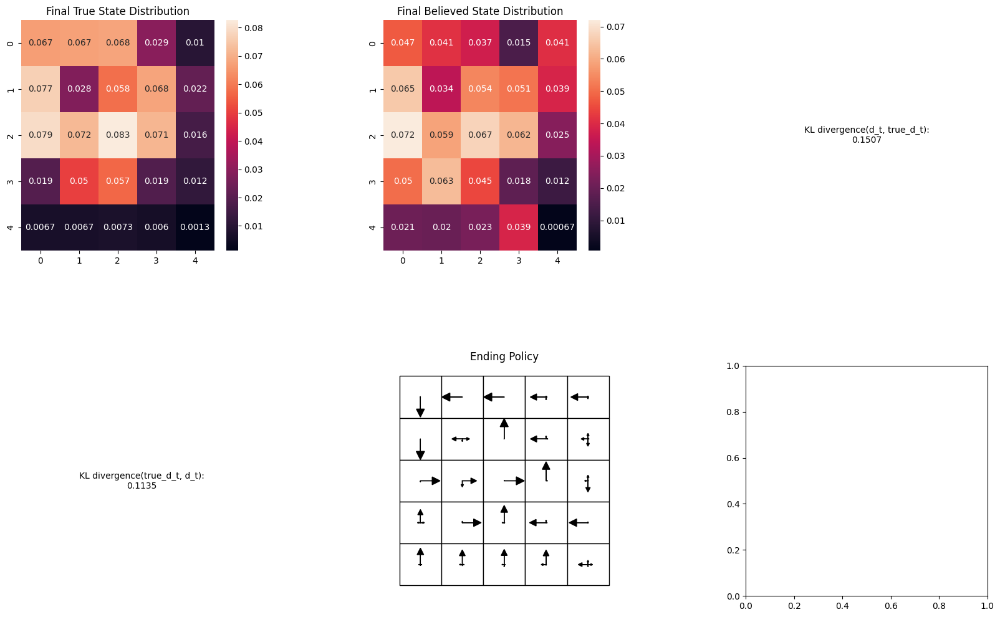

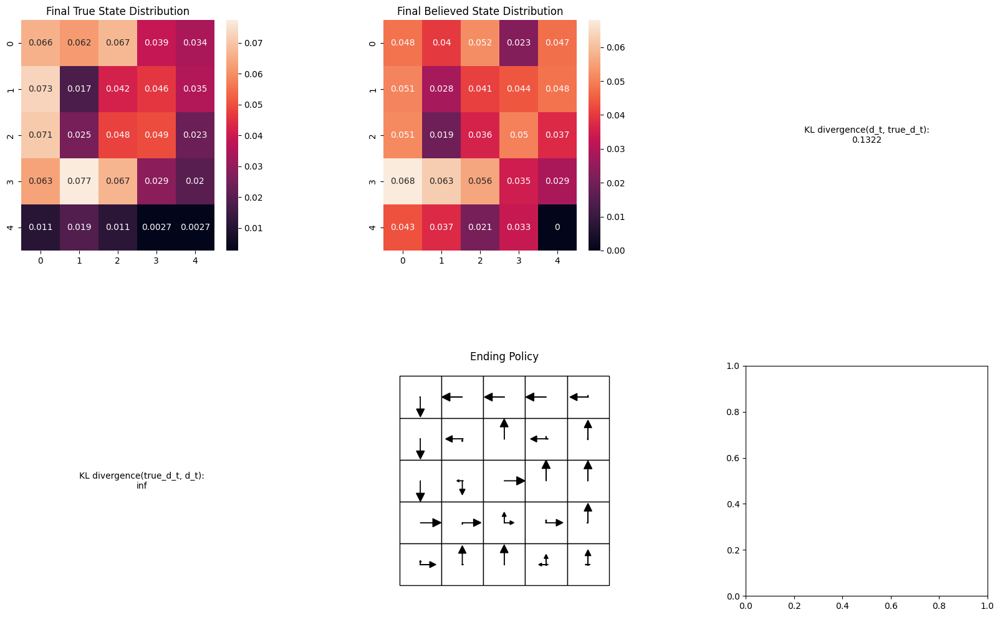

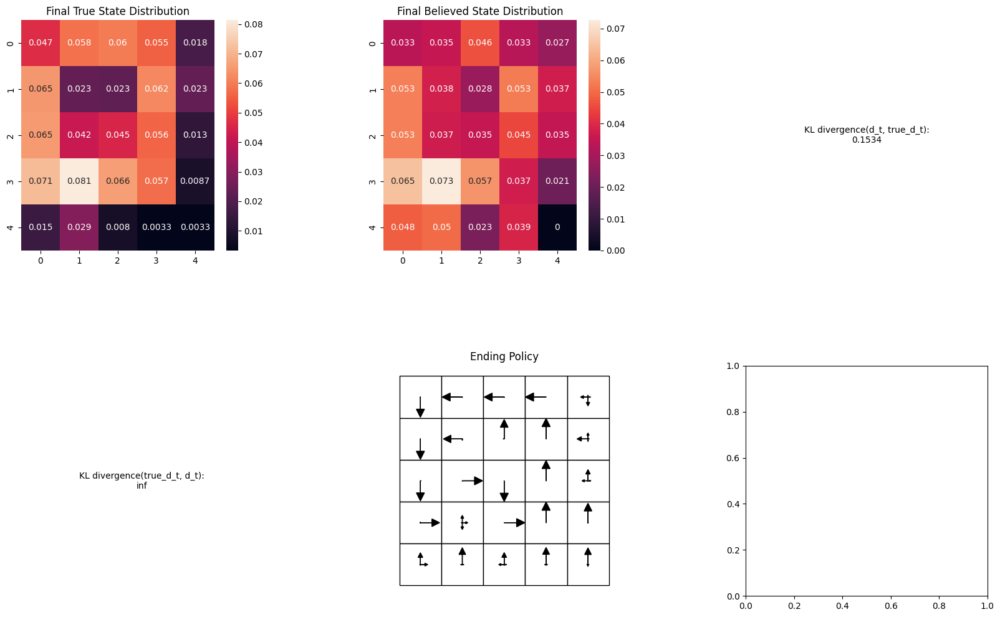

Stochastic Learned mean: nan


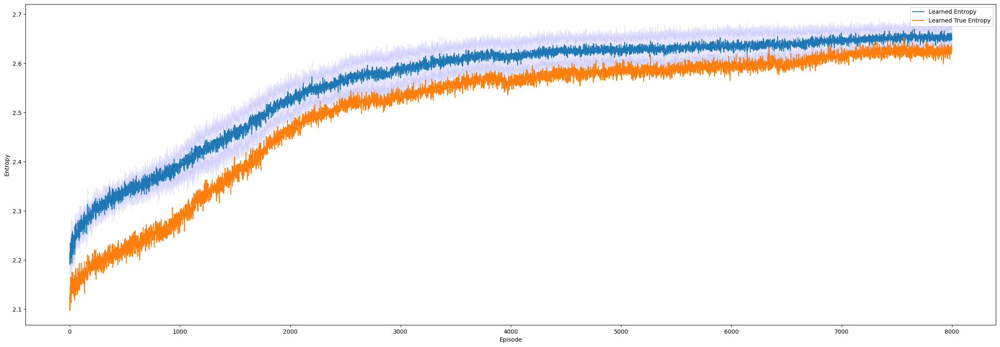

In [7]:
# Number of episodes for the training
n_episodes = 8000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0.1
randomize=1
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Strochastic Entropy POMDP random initial position")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

# Bimodal Env

In [3]:
gym.envs.register(
    id='GridworldPOMDPEnvBiModal-v0',
    entry_point=environments.GridworldPOMDPEnvBiModal
)
env = gym.make('GridworldPOMDPEnvBiModal-v0')

In [4]:
# Define a function to perform the training for a single run
def train_agent(args):
    run_idx, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount = args
    env = gym.make("GridworldPOMDPEnvBiModal-v0", time_horizon=time_horizon, steepness=steepness, prob=prob, randomize=randomize, shift_amount=shift_amount)  # Create a new environment for each run
    agent = agents.REINFORCEAgentEPOMDP(env, alpha=alpha)
    avg_entropies = []
    avg_true_entropies = []

    if run_idx == 0:
        with tqdm(total=n_episodes, position=run_idx, ncols=80, desc=f'Run {run_idx}') as pbar:
            for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
                pbar.update(1)
    else:
        for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
    agent.print_visuals(env, n_traj)
    return avg_entropies, avg_true_entropies

1.0
0.19230176730481


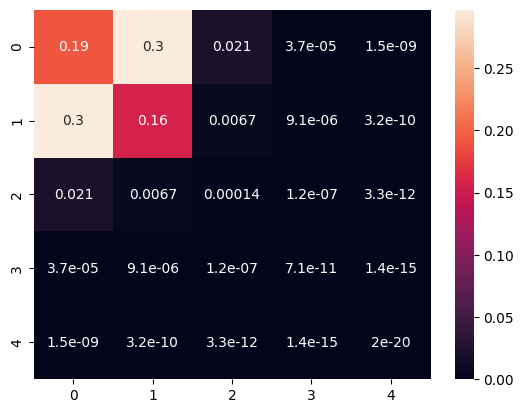

In [5]:
# Test observation matrix
sns.heatmap(np.reshape(env.observation_matrix[0], (env.grid_size, env.grid_size)), annot=True)
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))


**Deterministic BiModal**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

Run 0:  98%|████████████████████████████▌| 9831/10000 [1:07:22<01:19,  2.12it/s]

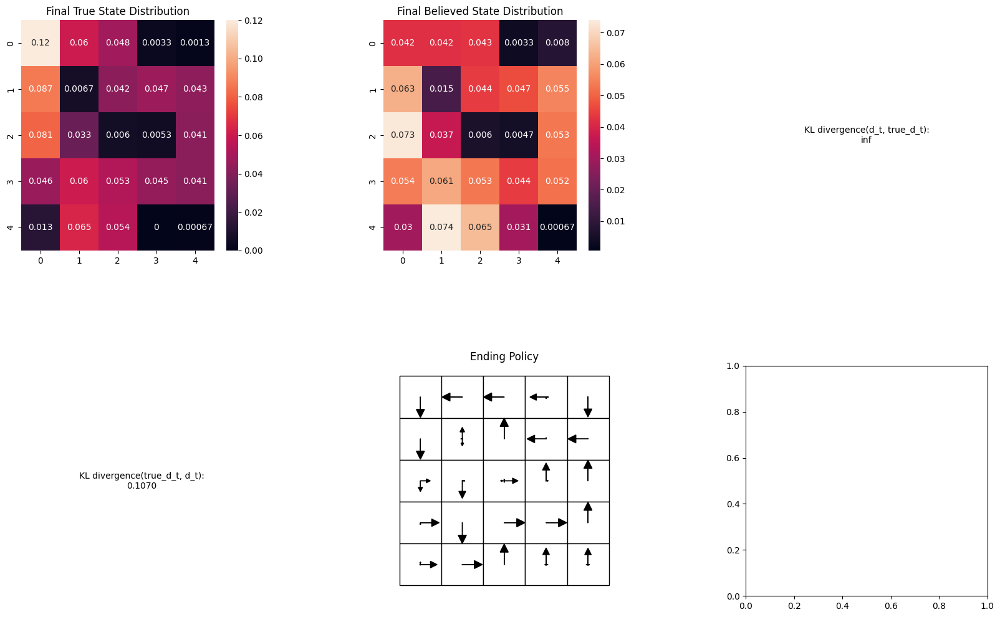

Run 0:  98%|████████████████████████████▌| 9849/10000 [1:07:31<01:14,  2.03it/s]

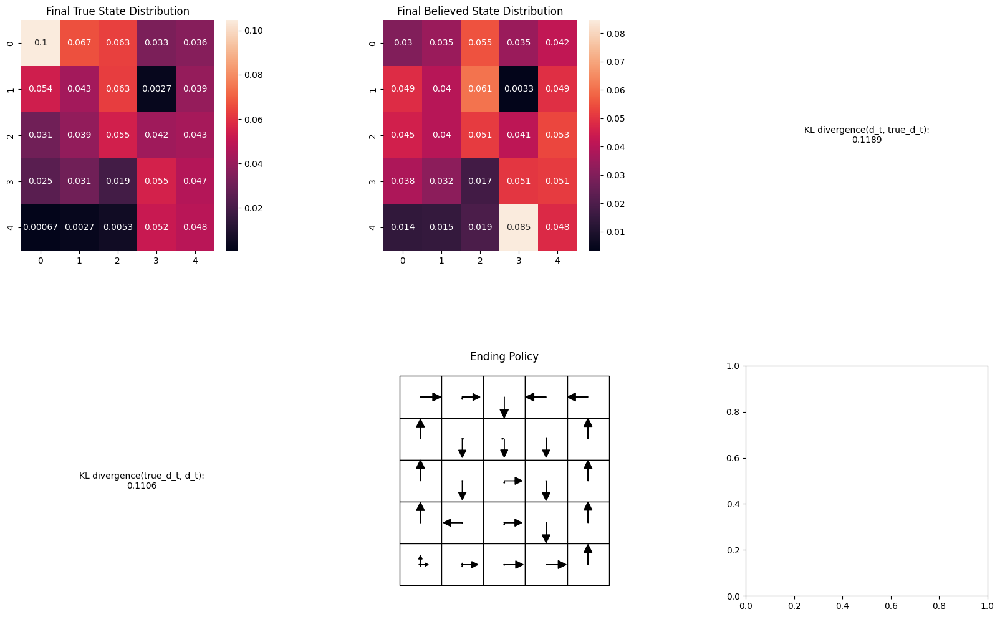

Run 0: 100%|████████████████████████████▉| 9980/10000 [1:08:22<00:08,  2.46it/s]

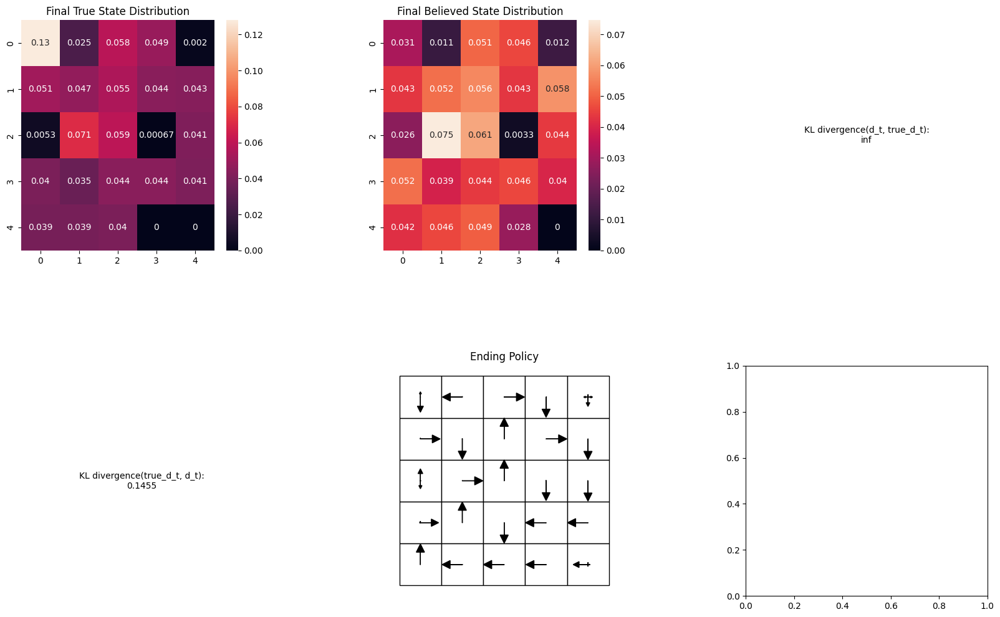

Run 0: 100%|████████████████████████████| 10000/10000 [1:08:31<00:00,  2.43it/s]


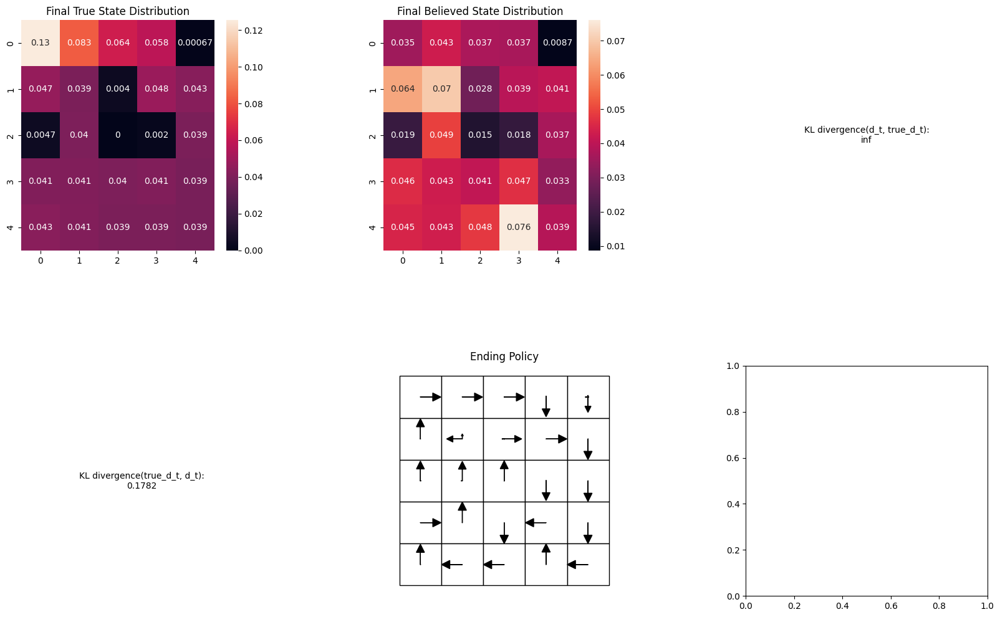

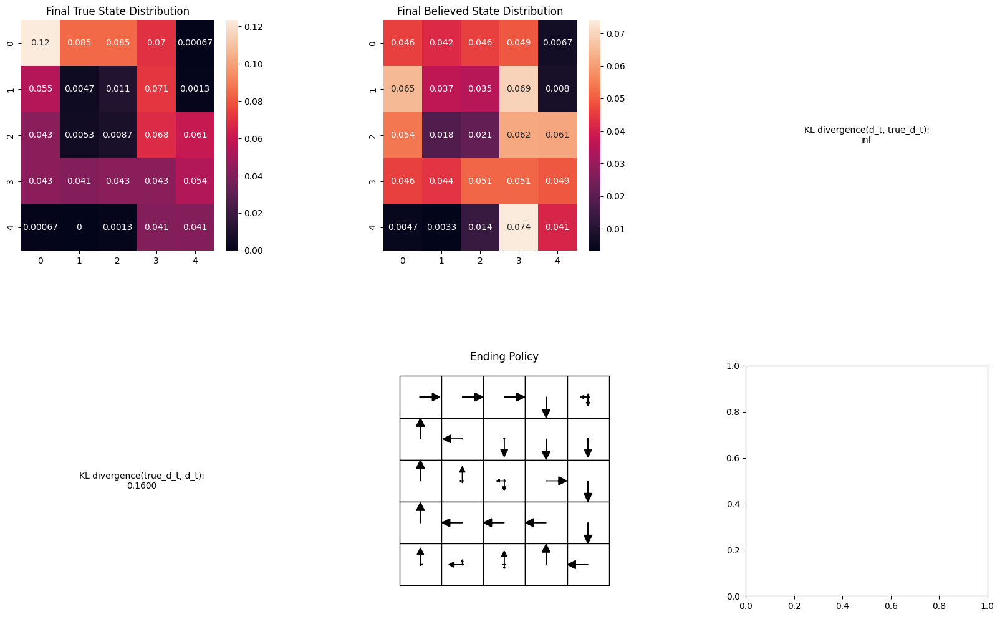

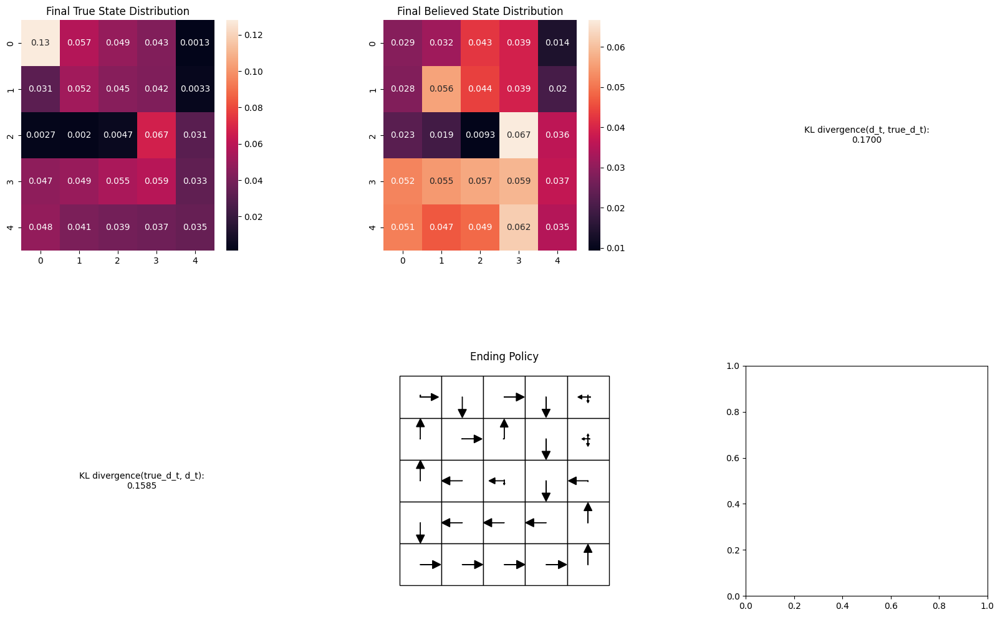

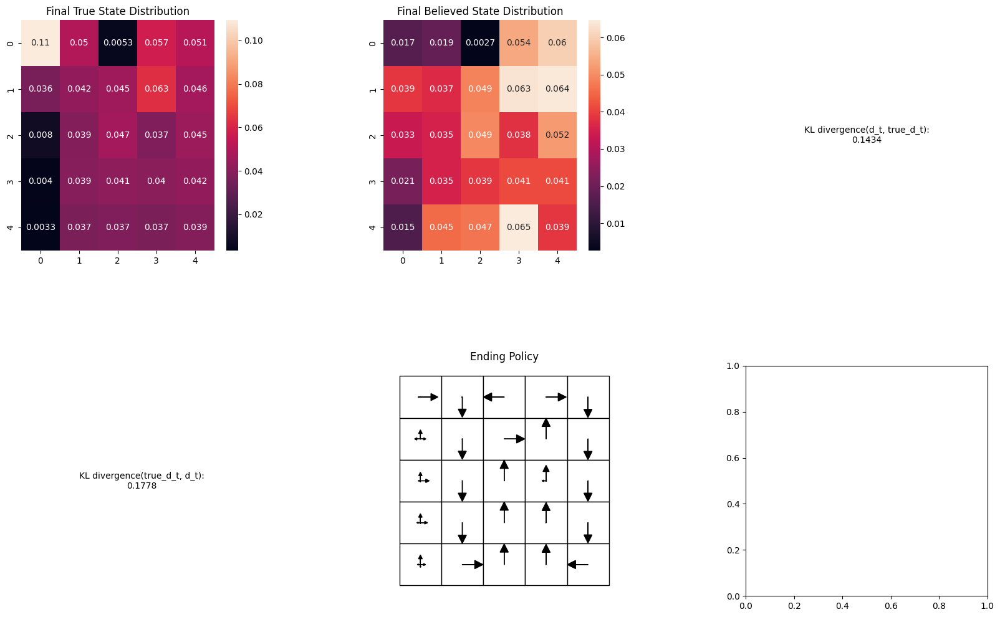

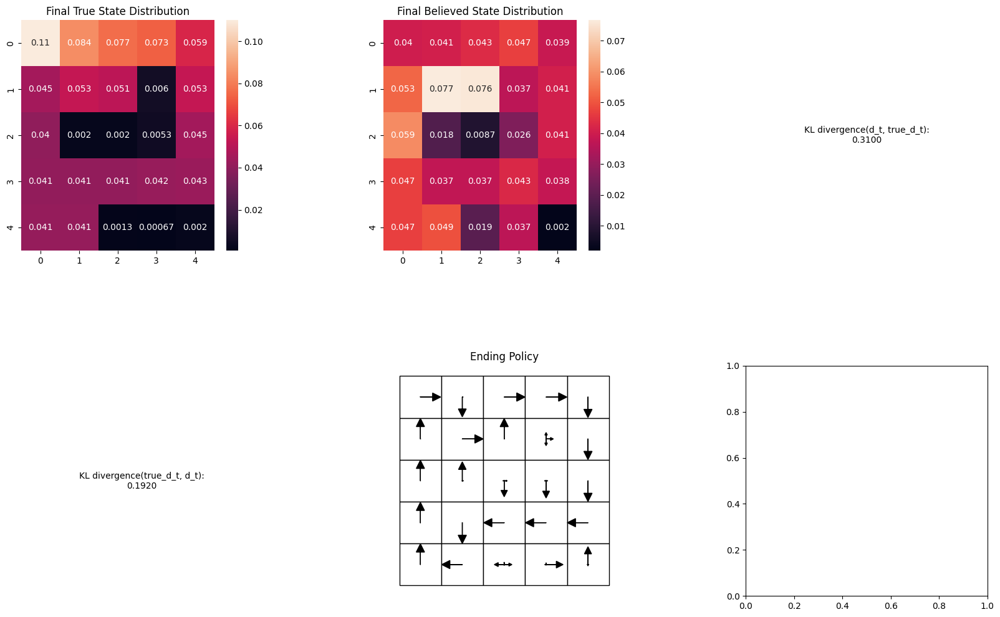

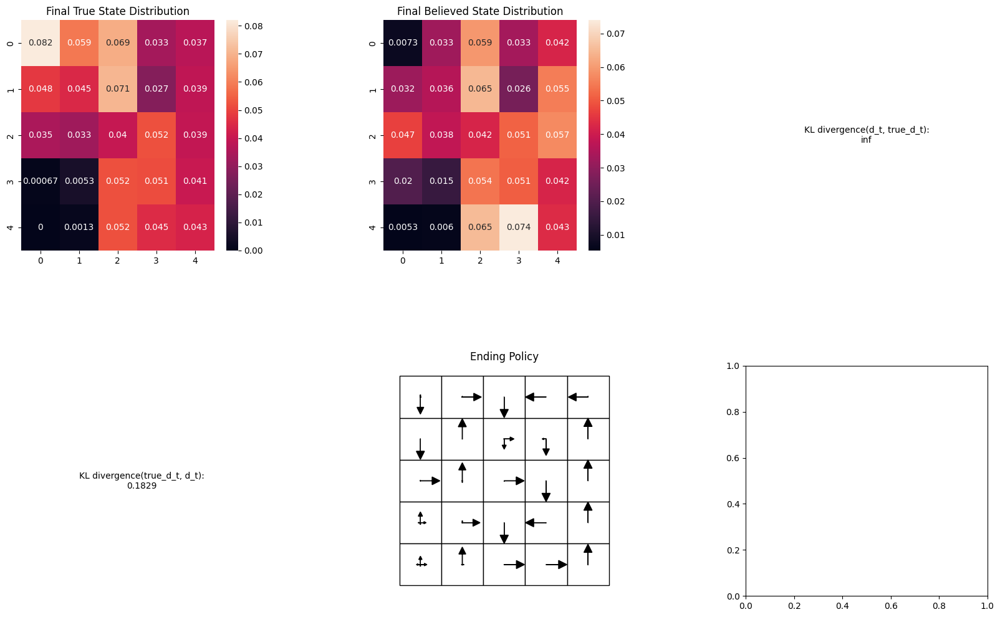

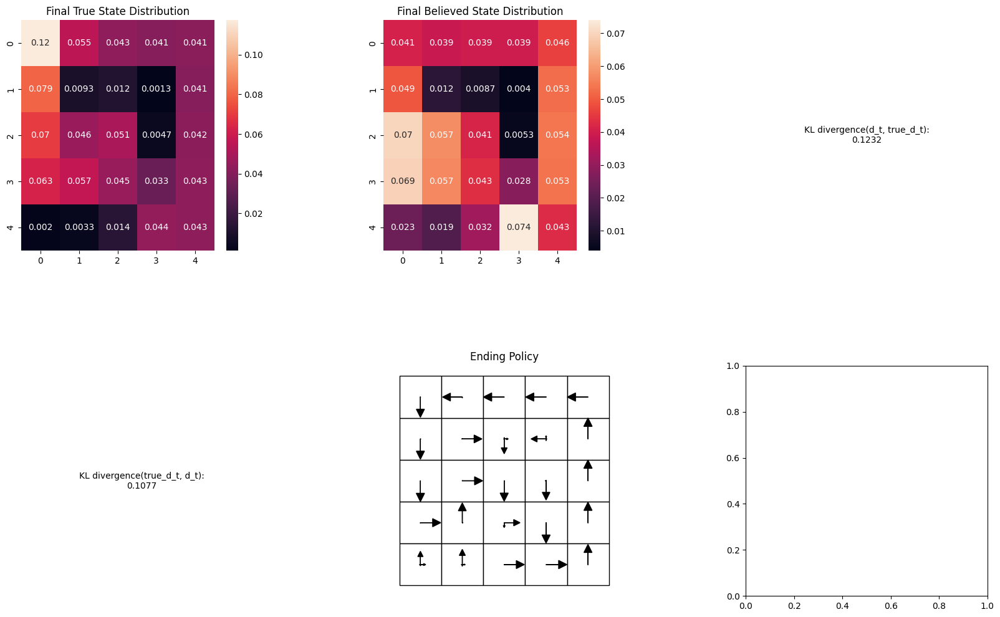

Stochastic Learned mean: 2.8074362228990655


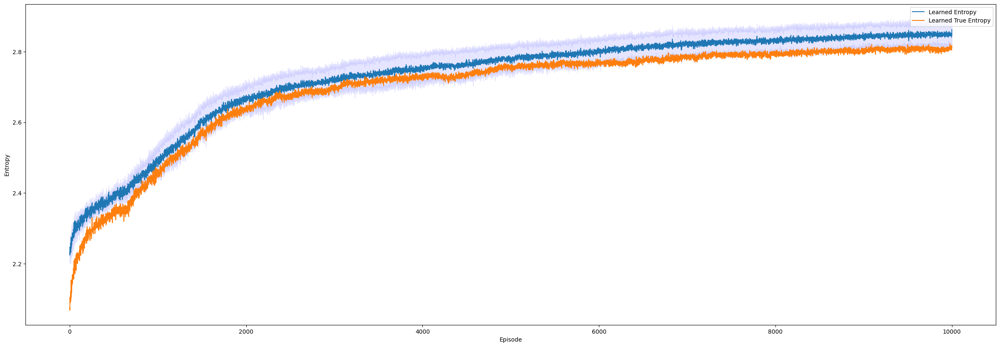

In [6]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0
randomize=0
shift_amount=0.8
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP BiModal")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Deterministic BiModal Random Initial Position**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                          | 0/10000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

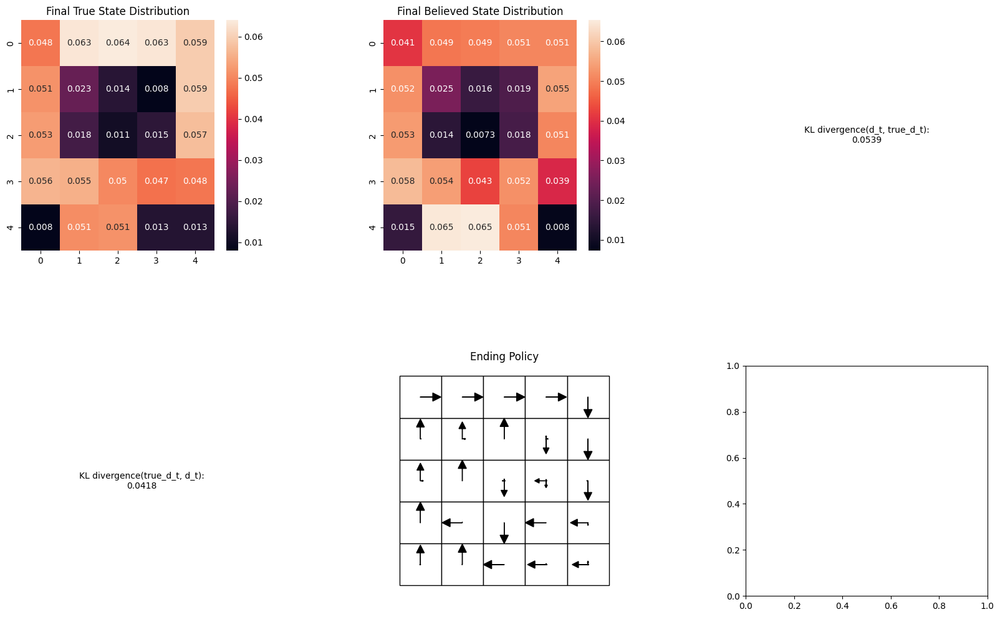

Run 0:  98%|████████████████████████████▍| 9815/10000 [1:08:27<01:25,  2.16it/s]

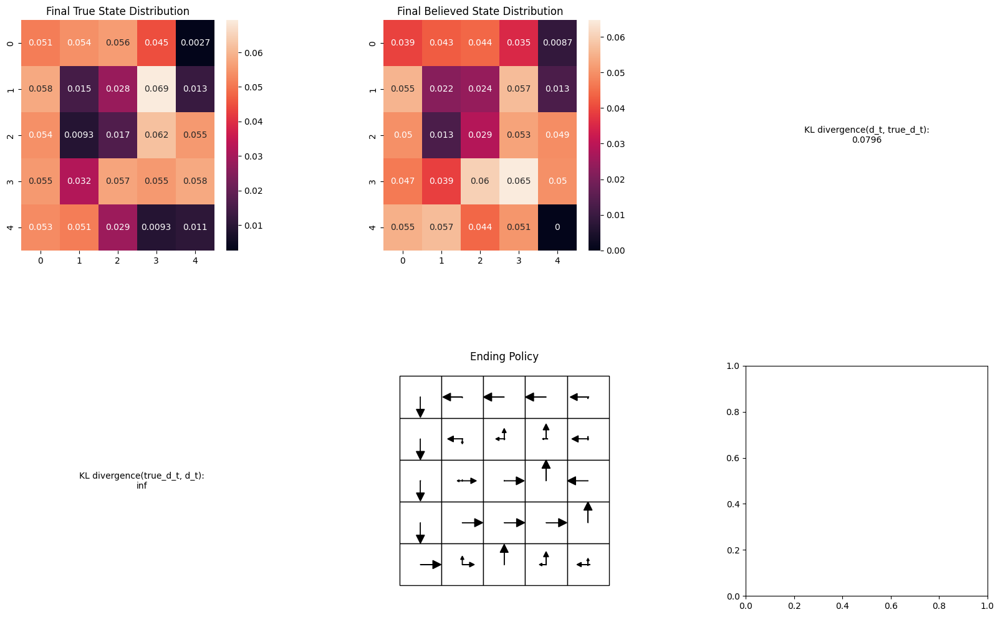

Run 0:  98%|████████████████████████████▌| 9833/10000 [1:08:35<01:06,  2.51it/s]

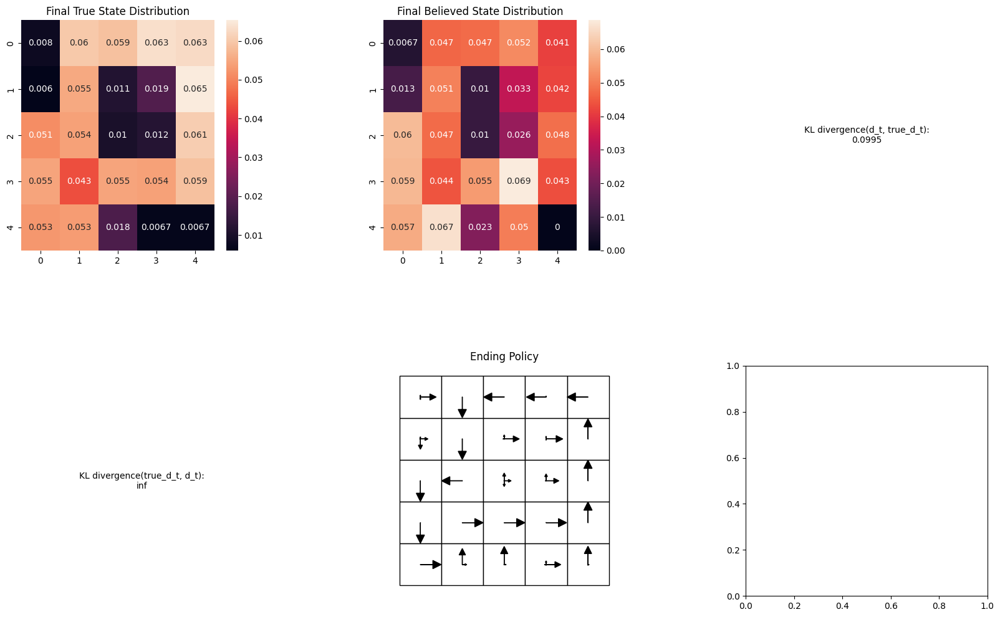

Run 0:  99%|████████████████████████████▋| 9874/10000 [1:08:50<00:48,  2.62it/s]

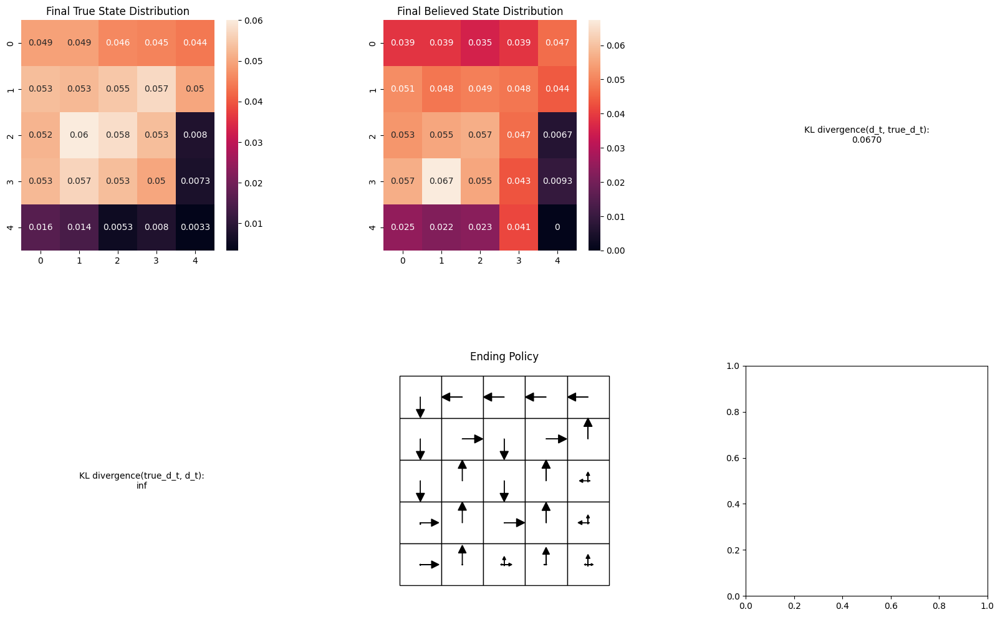

Run 0:  99%|████████████████████████████▋| 9883/10000 [1:08:55<00:53,  2.17it/s]

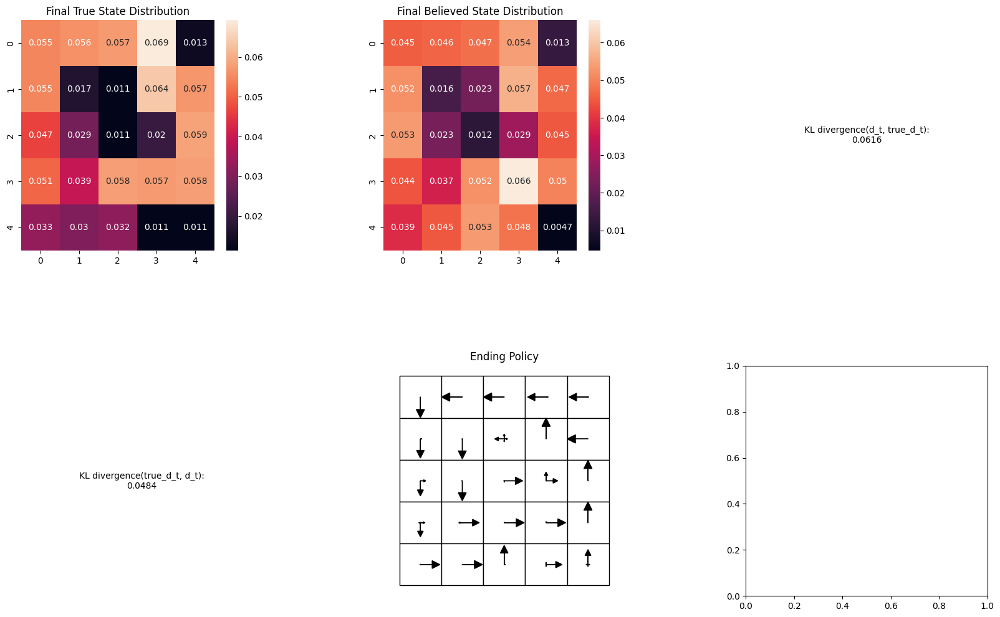

Run 0:  99%|████████████████████████████▊| 9919/10000 [1:09:10<00:34,  2.32it/s]

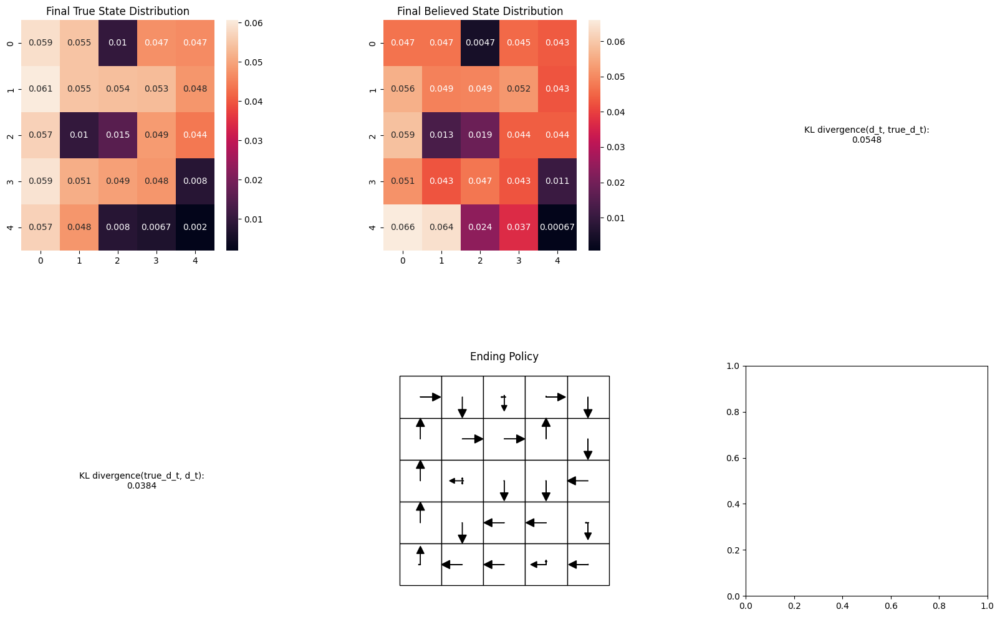

Run 0: 100%|████████████████████████████▉| 9962/10000 [1:09:28<00:14,  2.68it/s]

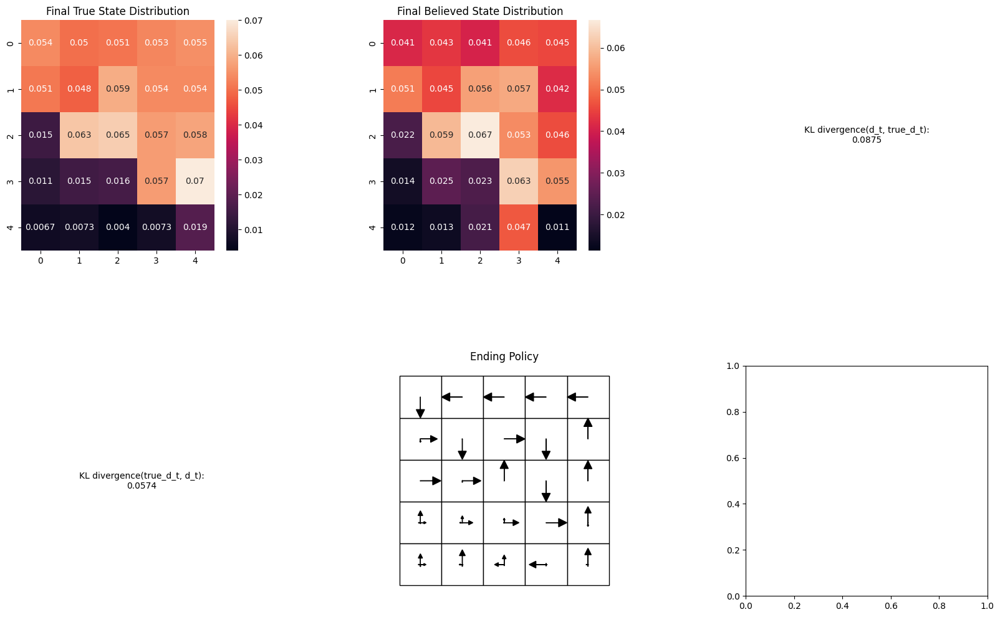

Run 0: 100%|████████████████████████████| 10000/10000 [1:09:42<00:00,  2.39it/s]


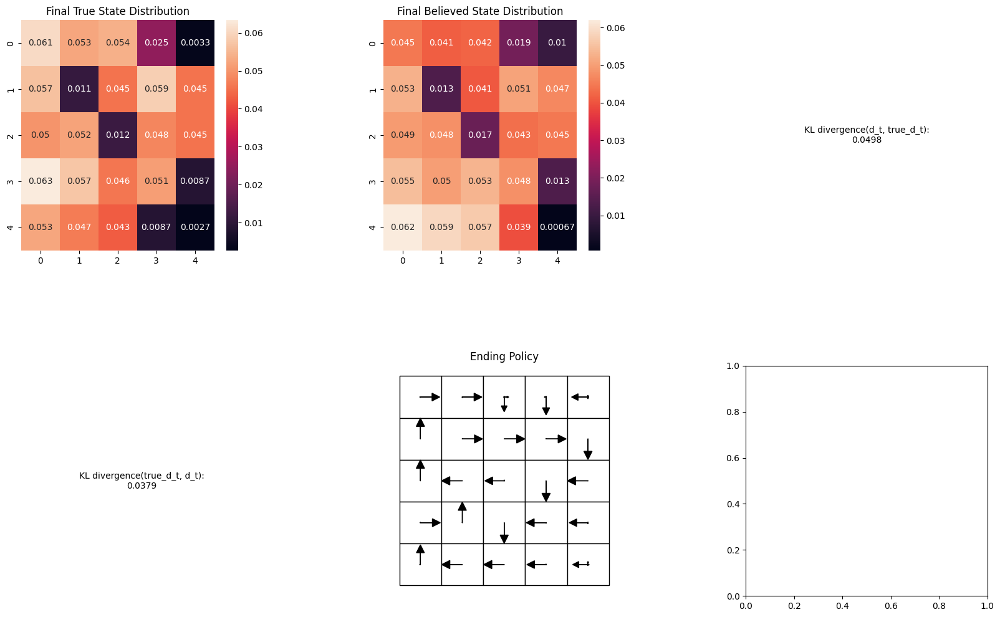

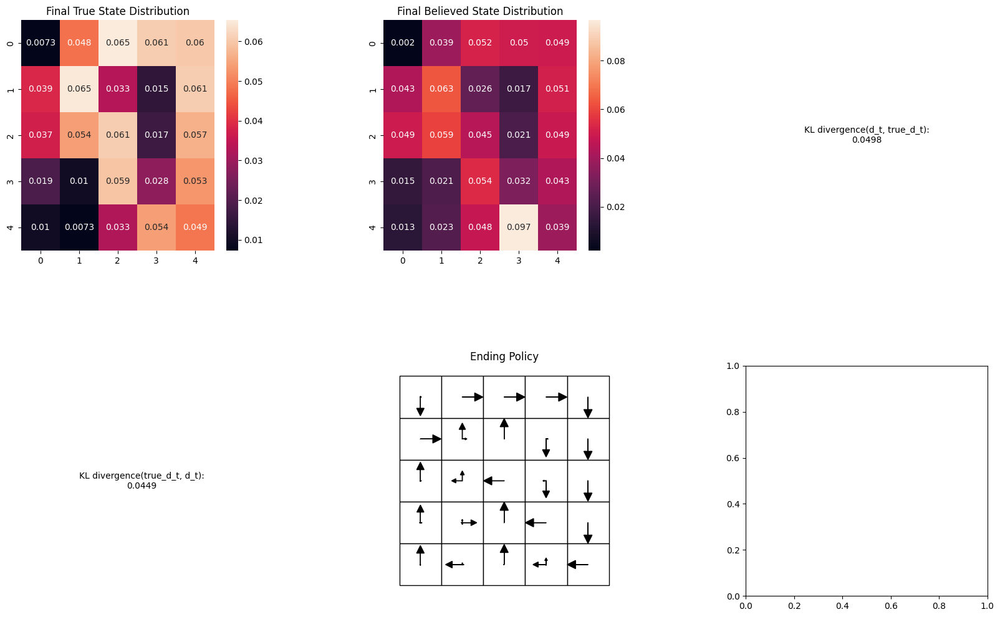

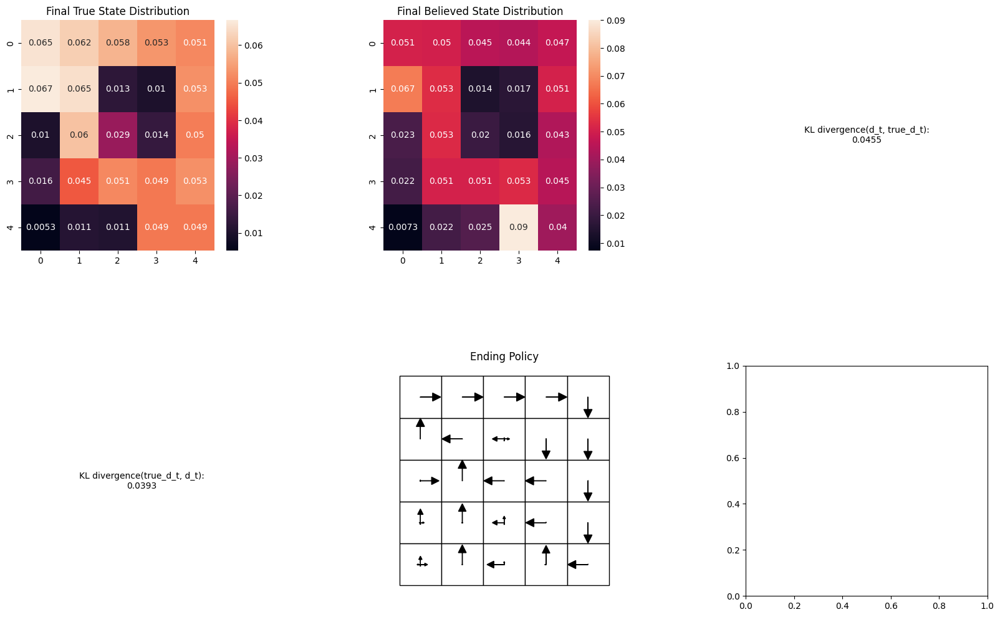

Stochastic Learned mean: 2.8013888456269203


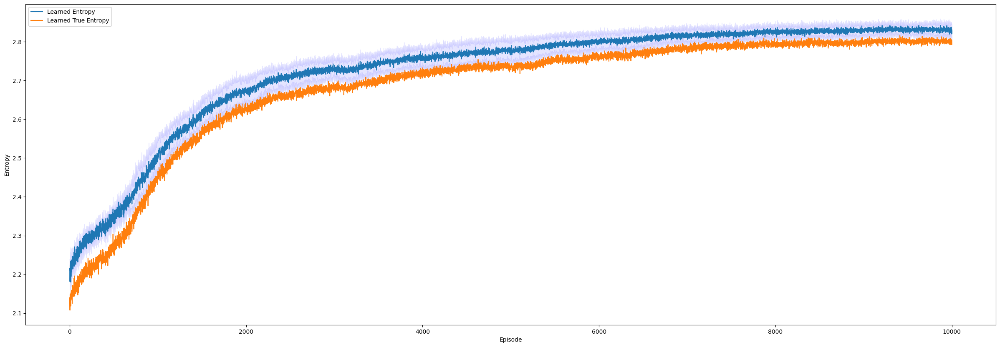

In [7]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0
randomize=1
shift_amount=0.8
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP BiModal Random Initial Position")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Deterministic BiModal Random Initial Position Prior Correct**

In [8]:
'''# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0
randomize=0
shift_amount=0.8
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP BiModal")
tail = n_episodes*0.95
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[tail:])))'''

'# Number of episodes for the training\nn_episodes = 10000\nn_traj = 60\n# Number of runs per episode\nn_run = 10\n# Environment variables\ntime_horizon = 25\nsteepness=15\nprob=0\nrandomize=0\nshift_amount=0.8\n# Agent variables\nalpha = 0.15\n\n# Create a list of arguments to pass to train_agent\nargs_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]\n\n# Use multiprocessing.Pool to parallelize the runs\nwith Pool() as pool:\n    results = pool.map(train_agent, args_list)\n\n# Collect the results\nlist_entropies = []\nlist_true_entropies = []\nfor result in results:\n    entropies, true_entropies = result\n    list_entropies.append(entropies)\n    list_true_entropies.append(true_entropies)\n\n# Transpose the lists to get the desired format\nlist_entropies = np.transpose(np.array(list_entropies), (1, 0))\nlist_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))\n\n# Prepare values to print\nplot_args = {}\nentropie

**Stochastic BiModal**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                          | 0/10000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

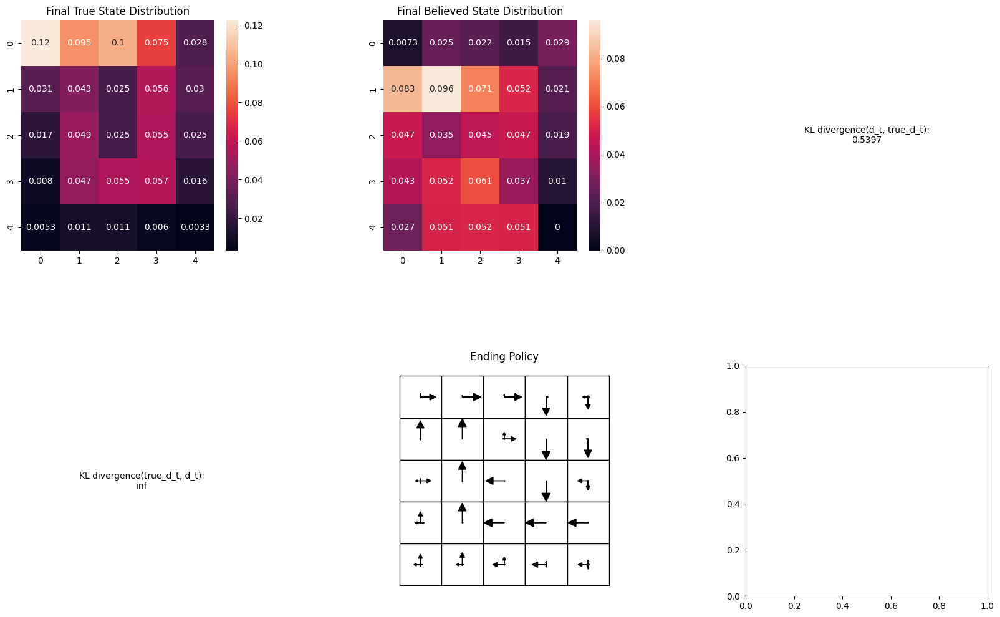

Run 0:  98%|████████████████████████████▍| 9807/10000 [1:07:27<01:18,  2.46it/s]

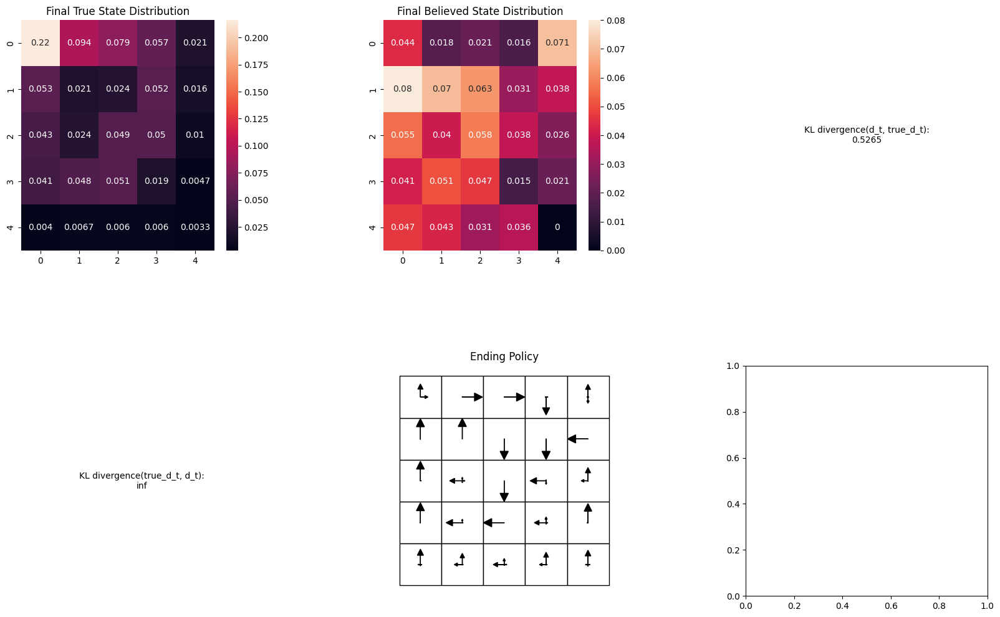

Run 0:  98%|████████████████████████████▌| 9832/10000 [1:07:37<01:15,  2.23it/s]

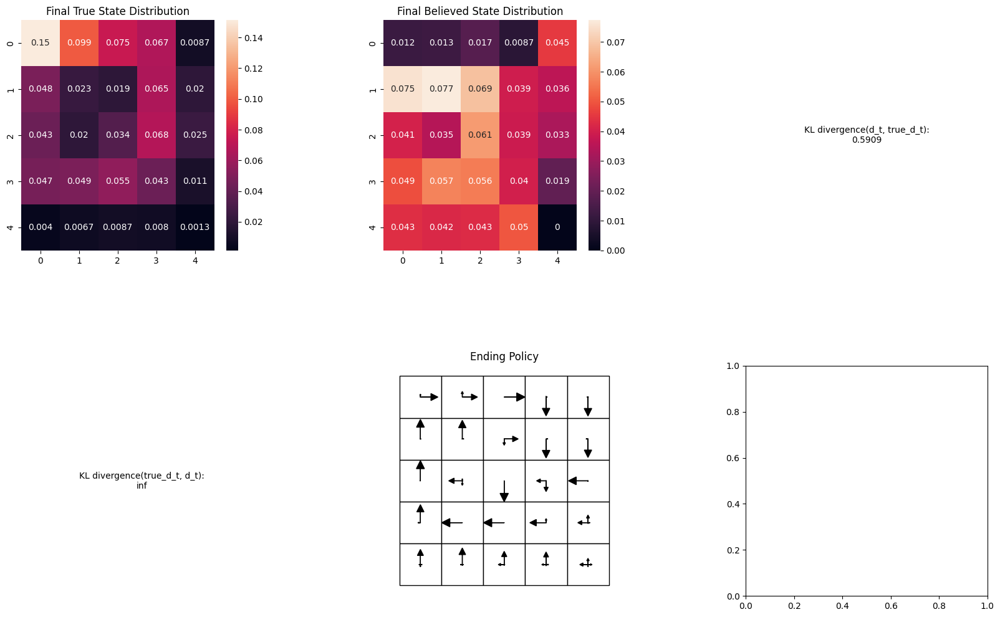

Run 0: 100%|████████████████████████████| 10000/10000 [1:08:42<00:00,  2.43it/s]


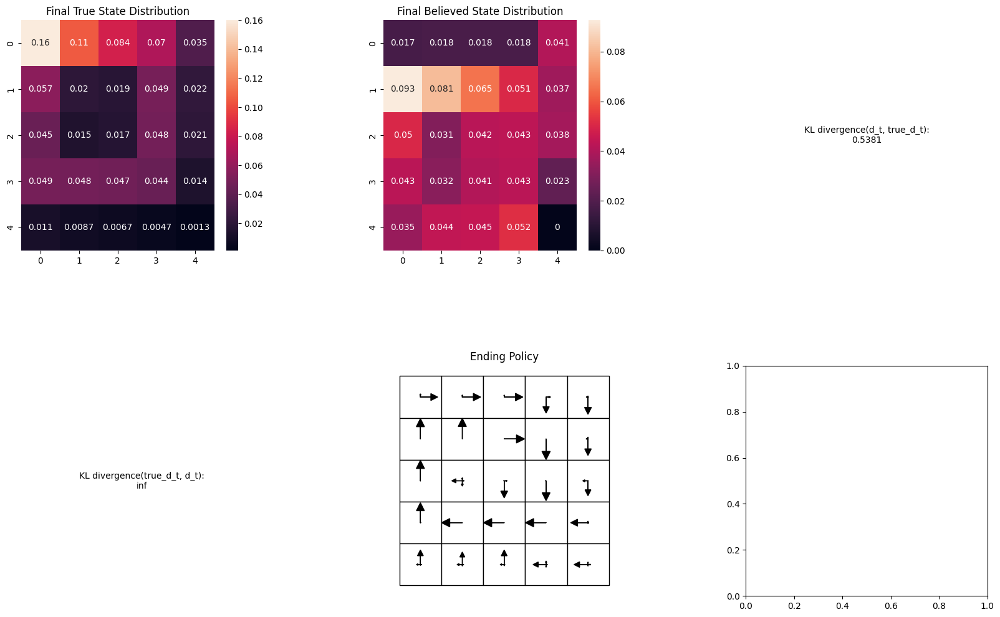

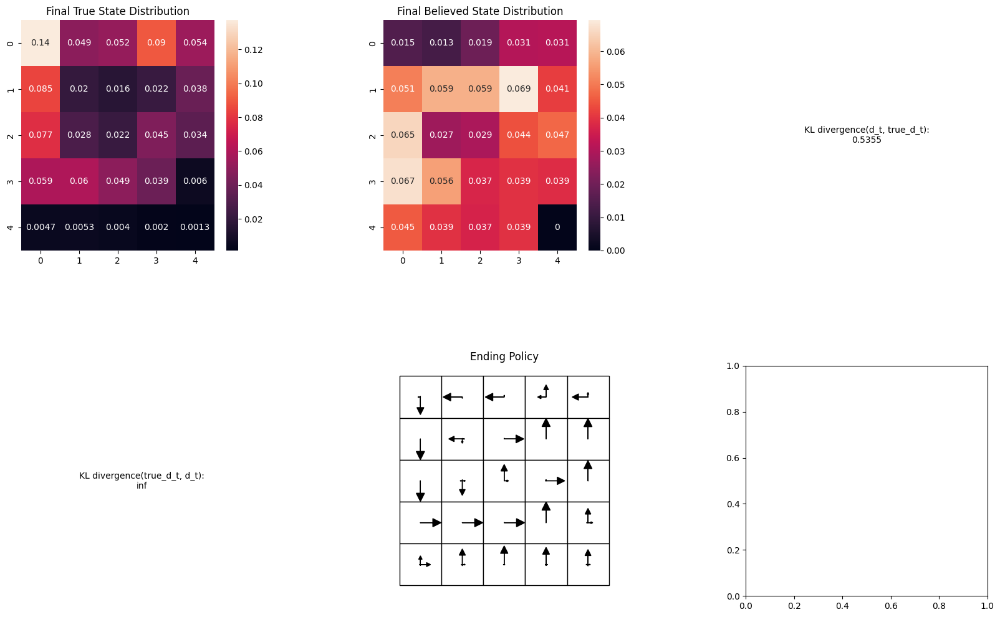

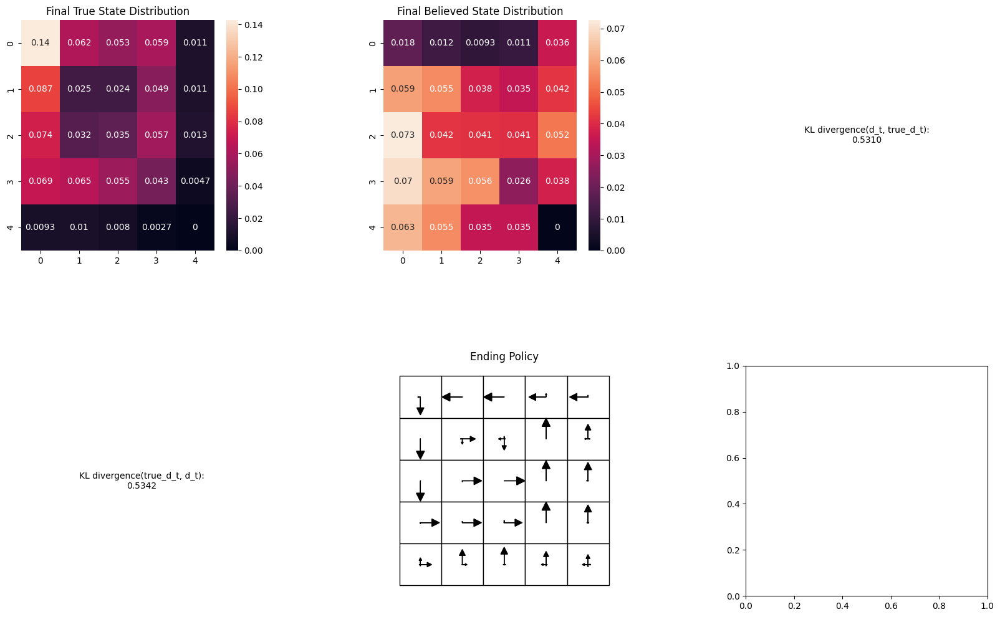

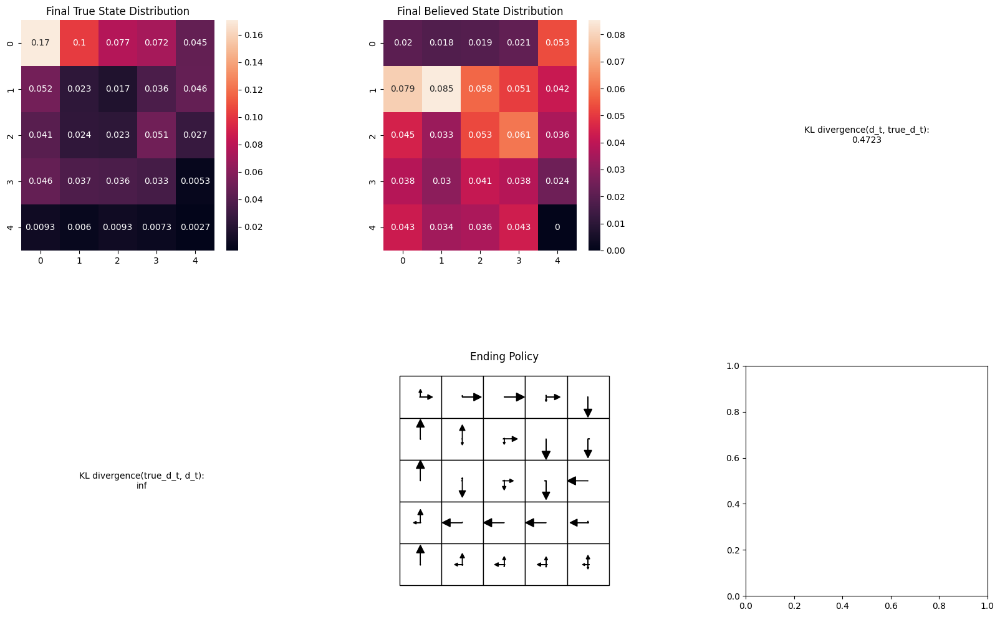

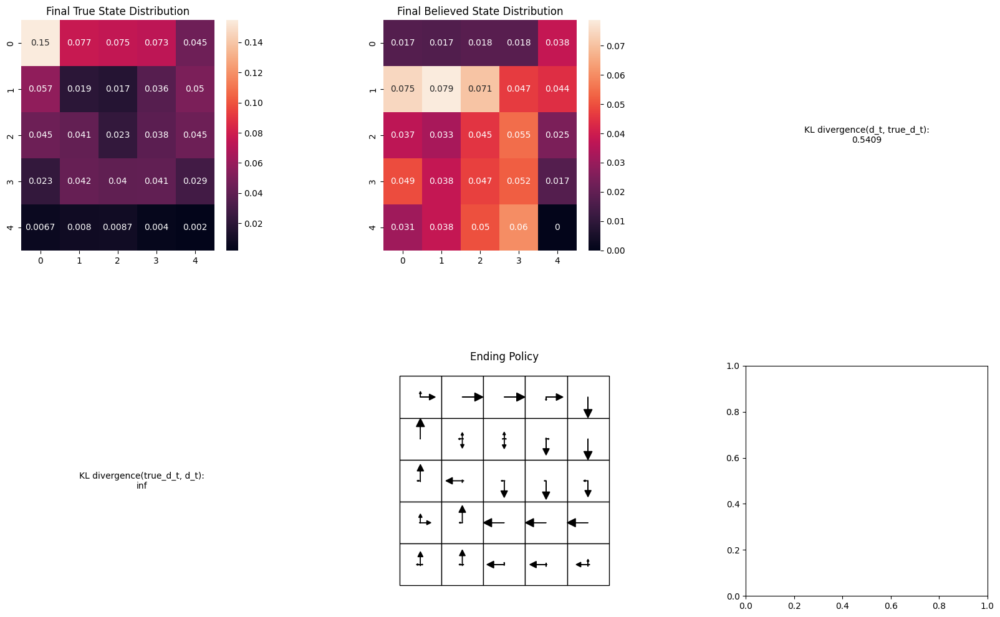

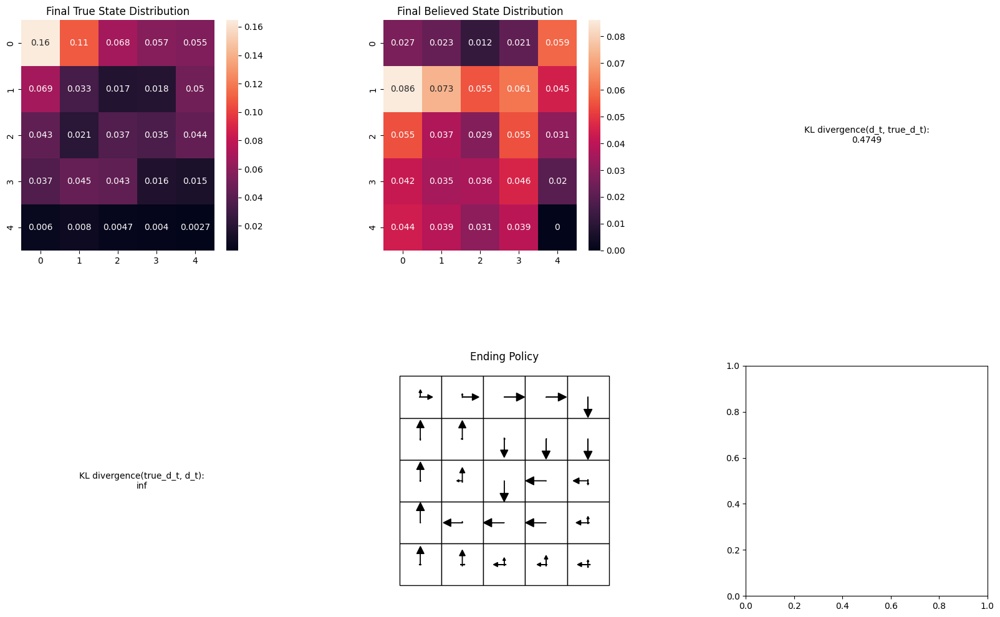

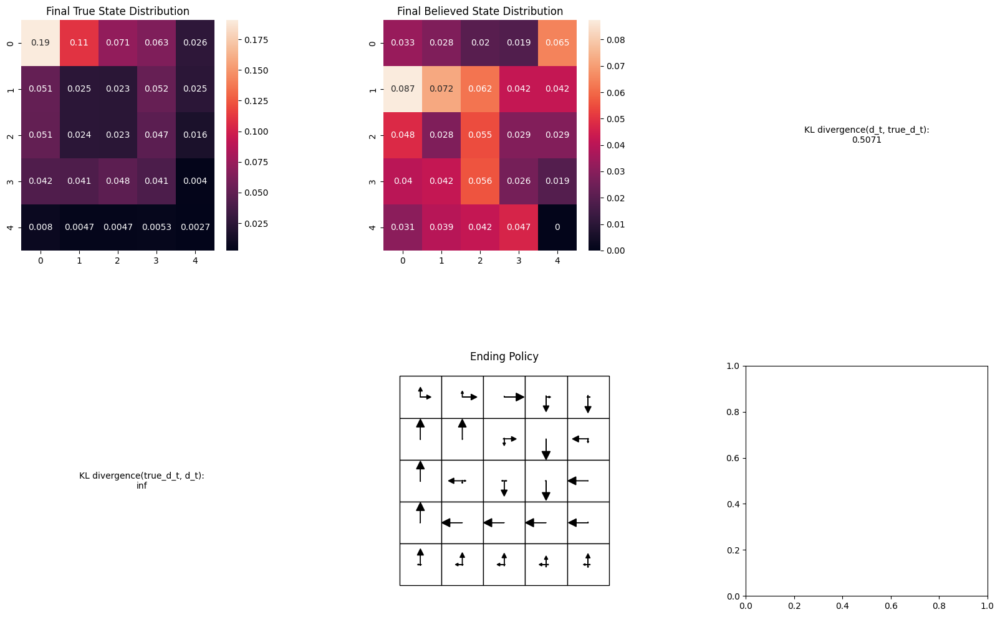

Stochastic Learned mean: 2.505616069343211


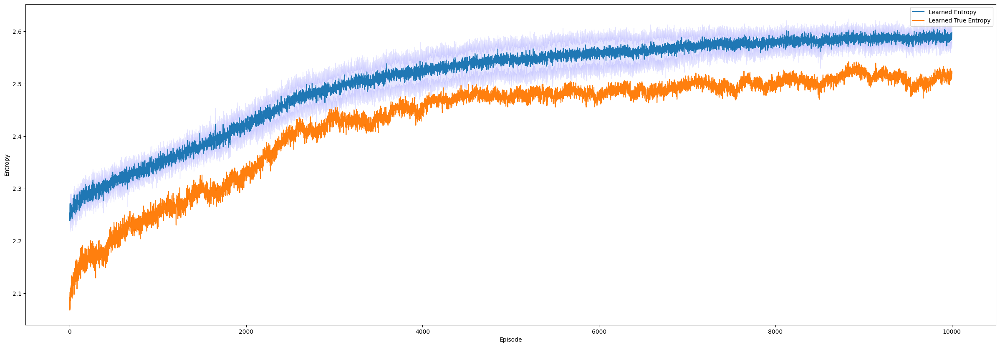

In [9]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0.1
randomize=0
shift_amount=0.8
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP BiModal")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Stochastic Random BiModal**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

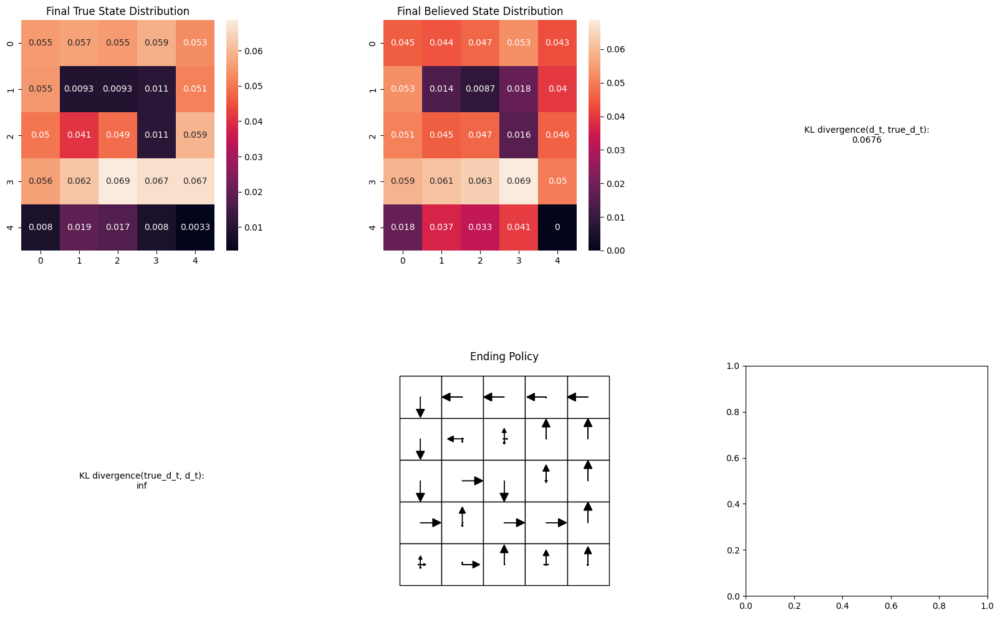

Run 0:  98%|████████████████████████████▎| 9764/10000 [1:08:32<01:41,  2.32it/s]

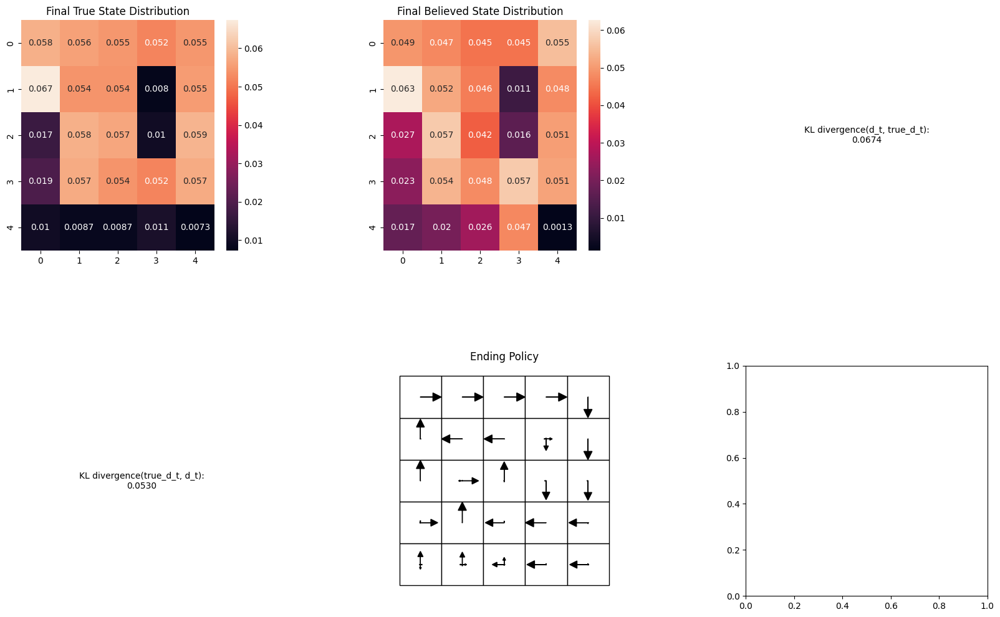

Run 0:  98%|████████████████████████████▎| 9772/10000 [1:08:35<01:33,  2.44it/s]

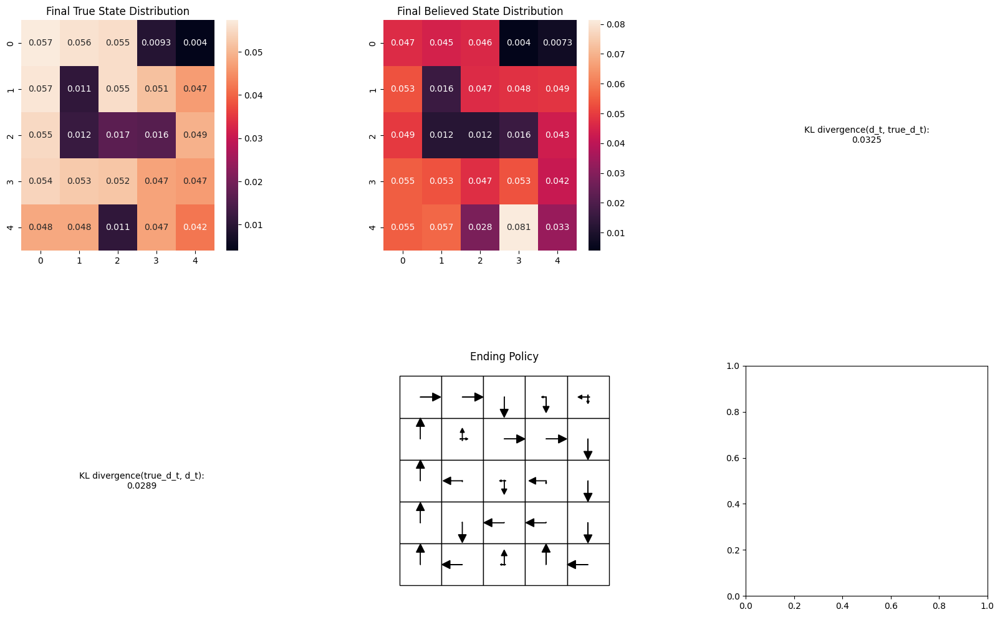

Run 0:  98%|████████████████████████████▍| 9786/10000 [1:08:40<01:27,  2.46it/s]

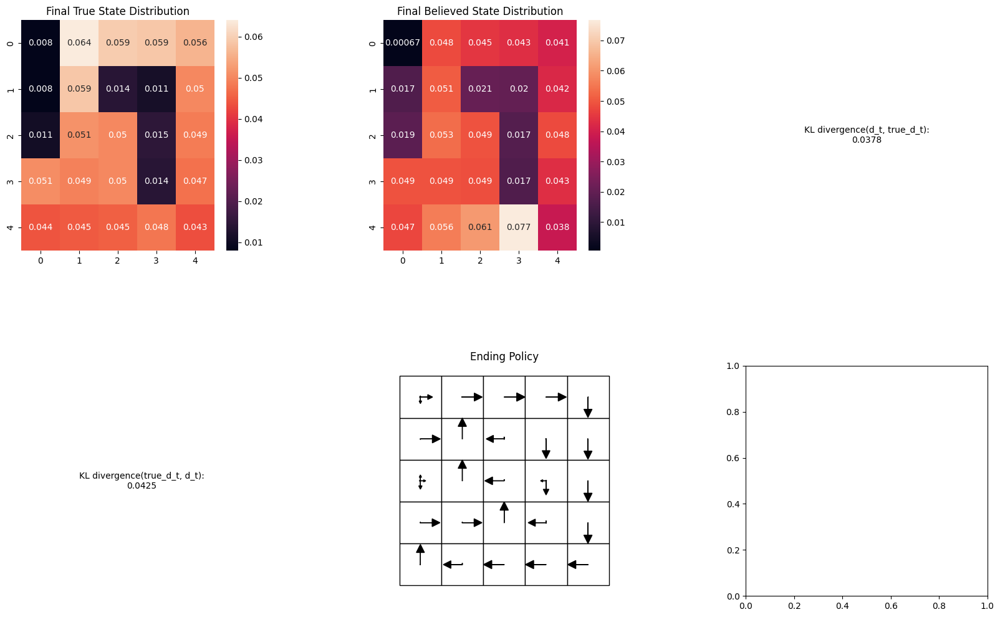

Run 0:  99%|████████████████████████████▋| 9871/10000 [1:09:18<00:56,  2.28it/s]

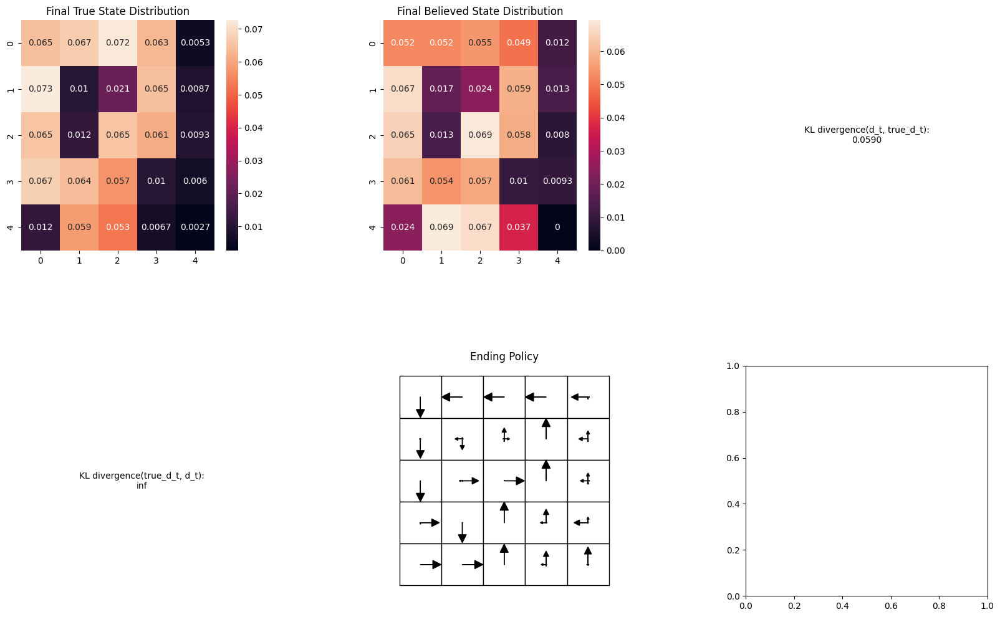

Run 0:  99%|████████████████████████████▊| 9937/10000 [1:09:47<00:28,  2.23it/s]

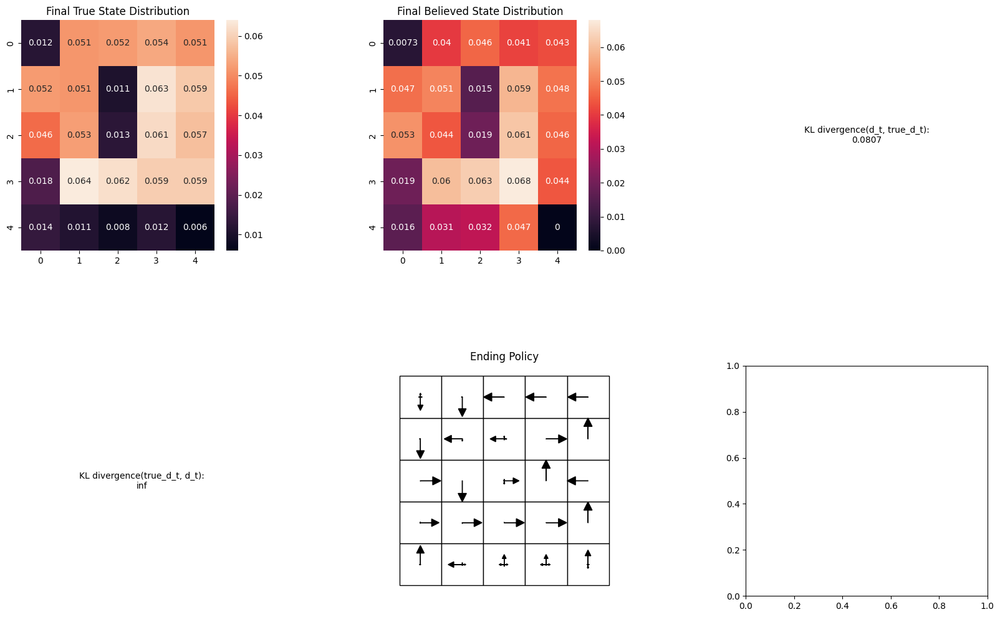

Run 0: 100%|████████████████████████████▉| 9965/10000 [1:09:59<00:14,  2.36it/s]

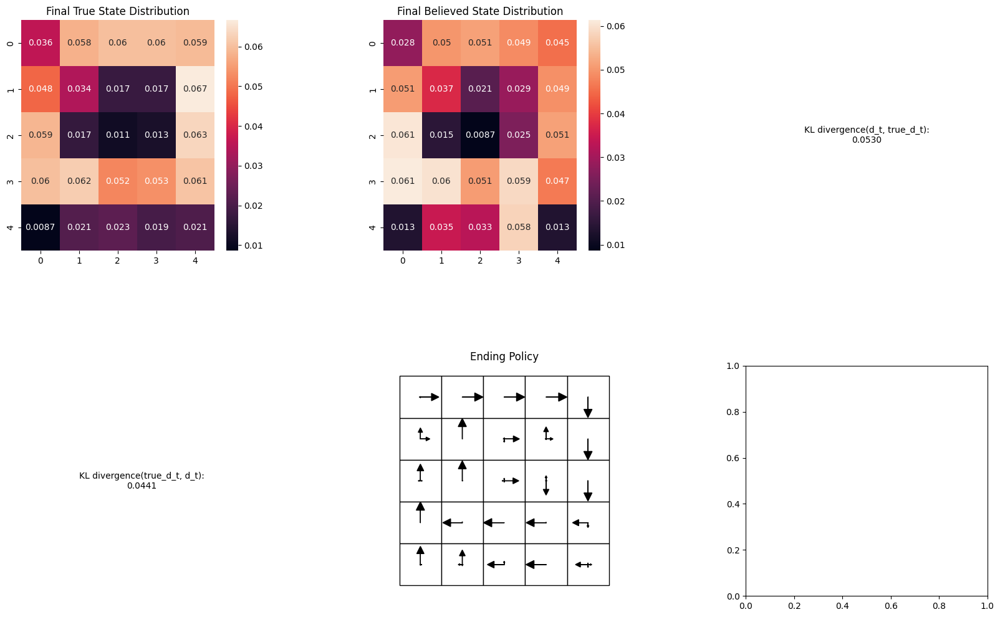

Run 0: 100%|████████████████████████████| 10000/10000 [1:10:13<00:00,  2.37it/s]


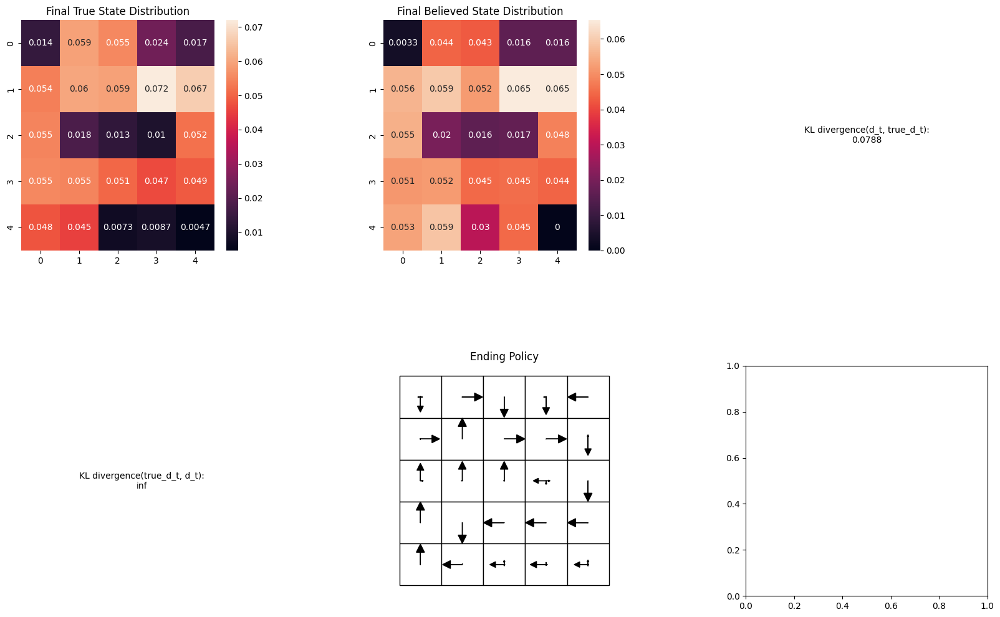

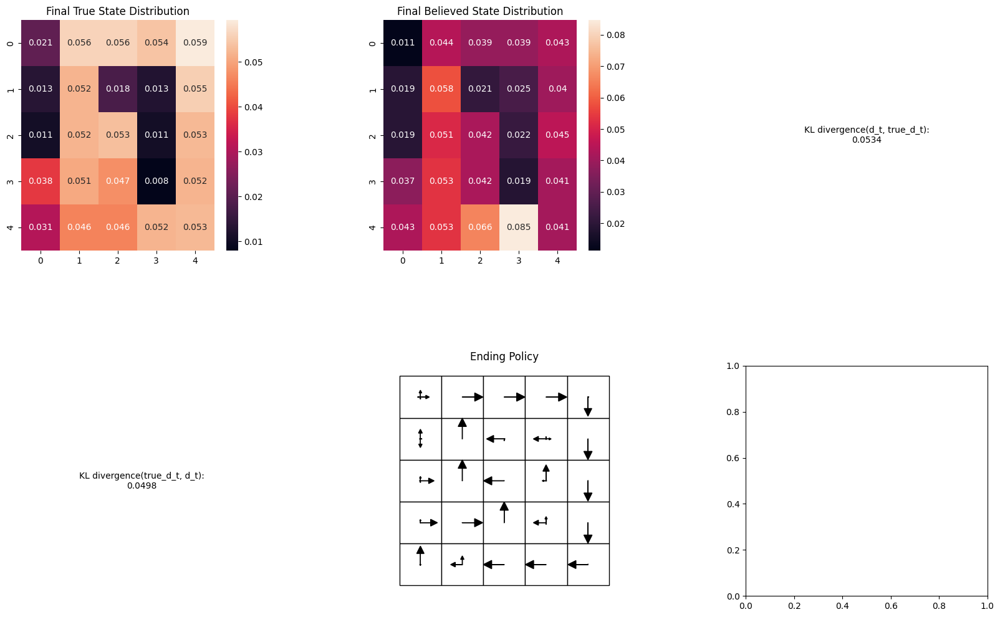

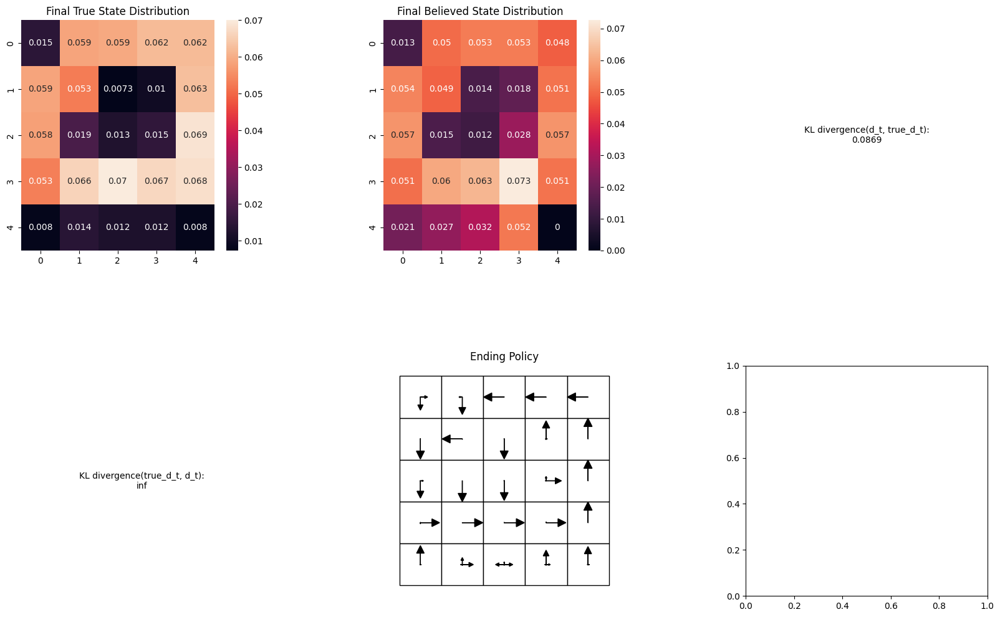

Stochastic Learned mean: 2.773437439184659


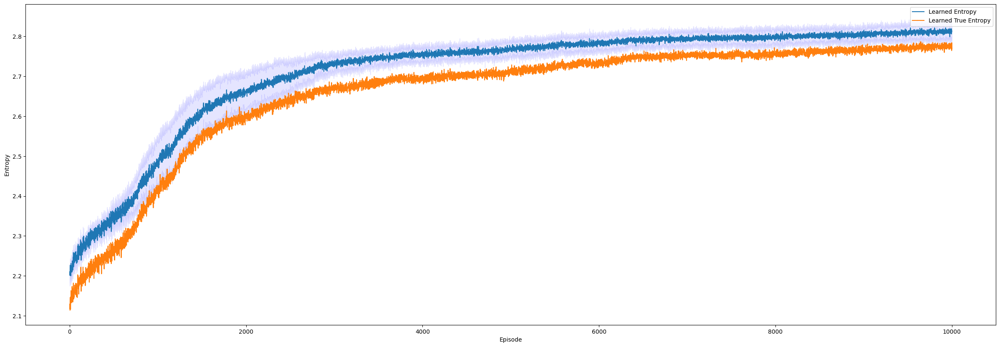

In [10]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0.1
randomize=1
shift_amount=0.8
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP BiModal Random Initial Position")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Stochastic Random BiModal Correct Prior**

In [11]:
'''# Number of episodes for the training
n_episodes = 6000
n_traj = 65
# Number of runs per episode
n_run = 3
time_horizon = 25
env = gym.make('GridworldPOMDPEnvBiModal-v0', time_horizon = time_horizon, steepness=15, prob=0.1, randomize=1)

with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    # Train the agent and plot the entropies
    list_entropies = []
    list_true_entropies = []
    for r in range(n_run):
        agent = agents.REINFORCEAgentEPOMDP(env, alpha = 0.15)
        avg_entropies = []
        avg_true_entropies = []
        for i in range(n_episodes):
            episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
            entropies = agent.update_multiple_sampling(episodes)
            avg_entropies.append(np.mean(entropies))
            avg_true_entropies.append(np.mean(true_entropies))
            pbar.update(1)
        agent.print_visuals(env=env, n_traj=n_traj)
        list_entropies.append(avg_entropies)
        list_true_entropies.append(avg_true_entropies)
    list_entropies = np.transpose(np.array(list_entropies), (1,0))
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

plot_graph(n_run, n_episodes, list_true_entropies, list_true_entropies, confidence)'''

"# Number of episodes for the training\nn_episodes = 6000\nn_traj = 65\n# Number of runs per episode\nn_run = 3\ntime_horizon = 25\nenv = gym.make('GridworldPOMDPEnvBiModal-v0', time_horizon = time_horizon, steepness=15, prob=0.1, randomize=1)\n\nwith tqdm(total=n_run * n_episodes, ncols=80) as pbar:\n    # Train the agent and plot the entropies\n    list_entropies = []\n    list_true_entropies = []\n    for r in range(n_run):\n        agent = agents.REINFORCEAgentEPOMDP(env, alpha = 0.15)\n        avg_entropies = []\n        avg_true_entropies = []\n        for i in range(n_episodes):\n            episodes, true_entropies = agent.play(env=env, n_traj=n_traj)\n            entropies = agent.update_multiple_sampling(episodes)\n            avg_entropies.append(np.mean(entropies))\n            avg_true_entropies.append(np.mean(true_entropies))\n            pbar.update(1)\n        agent.print_visuals(env=env, n_traj=n_traj)\n        list_entropies.append(avg_entropies)\n        list_true_en

# Asymmetric env

In [19]:
gym.envs.register(
    id='GridworldPOMDPEnvAsymm-v0',
    entry_point=environments.GridworldPOMDPEnvAsymm
)
env = gym.make('GridworldPOMDPEnvAsymm-v0')

AttributeError: module 'environments' has no attribute 'GridworldPOMDPEnvAsymm'

In [ ]:
# Define a function to perform the training for a single run
def train_agent(args):
    run_idx, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount = args
    env = gym.make("GridworldPOMDPEnvAsymm-v0", time_horizon=time_horizon, steepness=steepness, prob=prob, randomize=randomize, shift_amount=shift_amount)  # Create a new environment for each run
    agent = agents.REINFORCEAgentEPOMDP(env, alpha=alpha)
    avg_entropies = []
    avg_true_entropies = []

    if run_idx == 0:
        with tqdm(total=n_episodes, position=run_idx, ncols=80, desc=f'Run {run_idx}') as pbar:
            for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
                pbar.update(1)
    else:
        for i in range(n_episodes):
                episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
                entropies = agent.update_multiple_sampling(episodes)
                avg_entropies.append(np.mean(entropies))
                avg_true_entropies.append(np.mean(true_entropies))
    agent.print_visuals(env, n_traj)
    return avg_entropies, avg_true_entropies

1.0
0.19230176730481


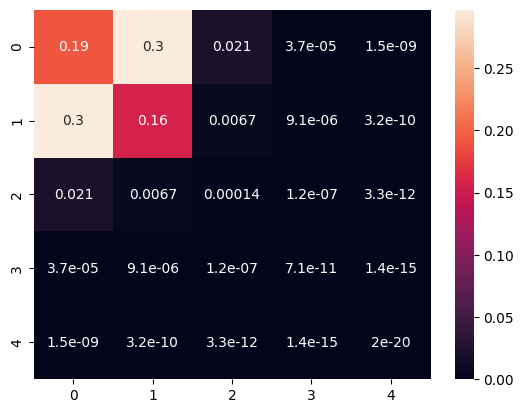

In [12]:
# Test observation matrix
sns.heatmap(np.reshape(env.observation_matrix[0], (env.grid_size, env.grid_size)), annot=True)
print(np.sum(env.observation_matrix[0]))
print(np.sum(env.observation_matrix[0][0]))

**Deterministic Asymmetric**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

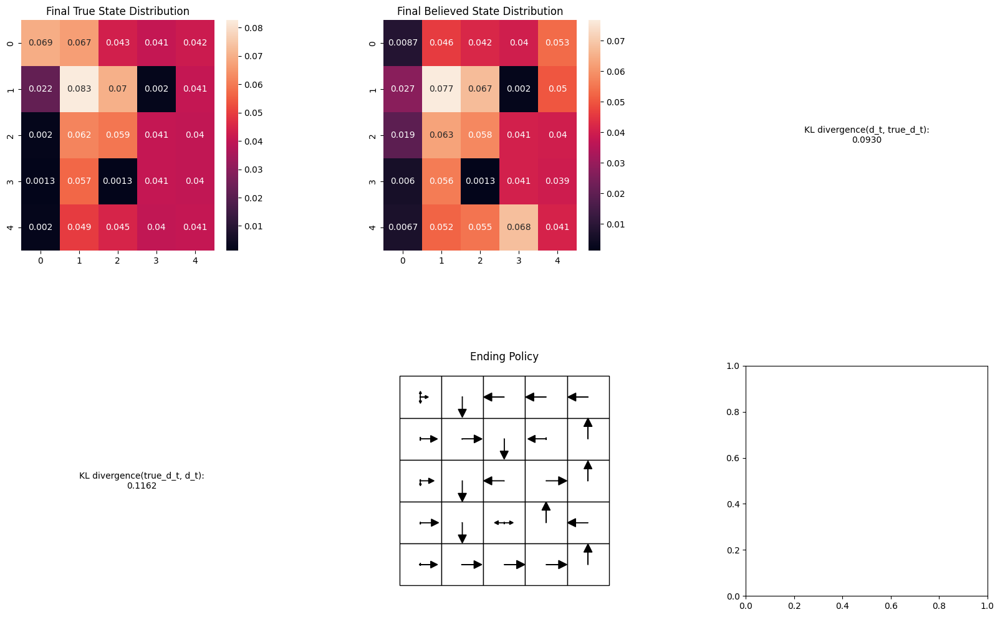

Run 0:  92%|██████████████████████████▋  | 9197/10000 [1:08:55<05:51,  2.28it/s]

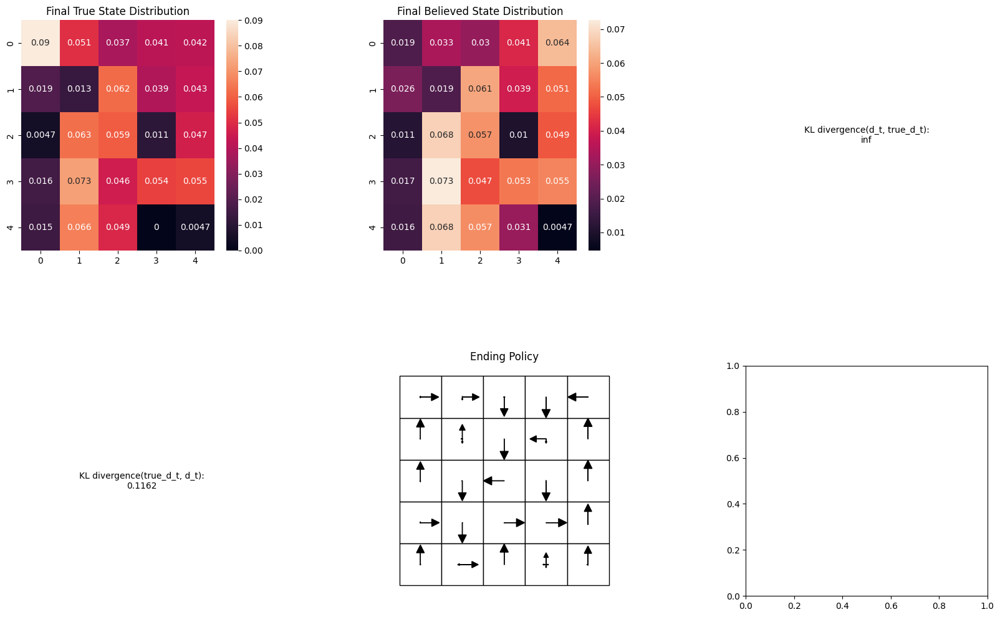

Run 0:  92%|██████████████████████████▋  | 9198/10000 [1:08:55<05:40,  2.35it/s]

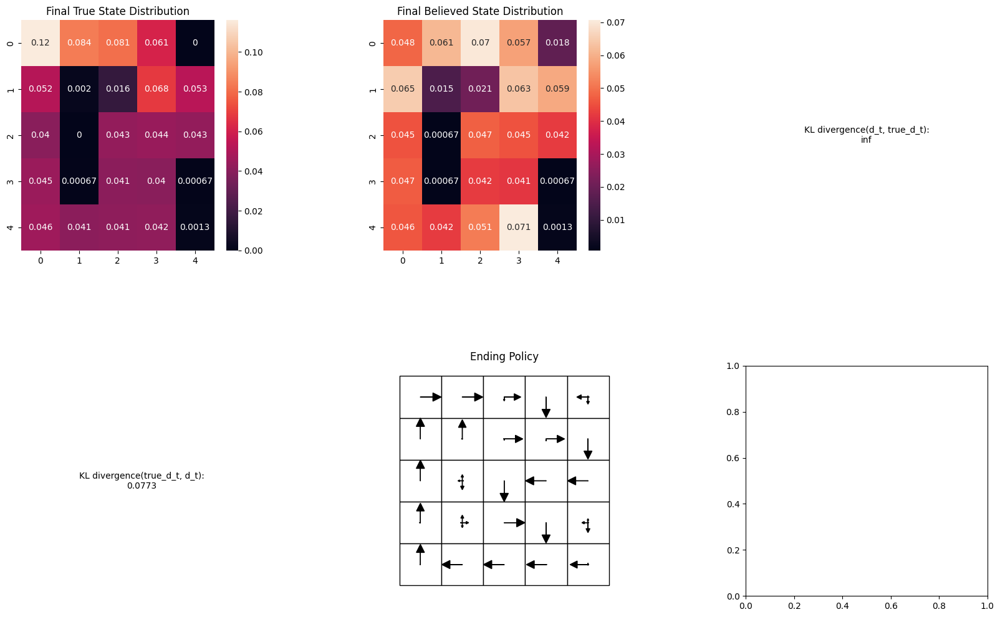

Run 0:  92%|██████████████████████████▋  | 9221/10000 [1:09:05<05:42,  2.28it/s]

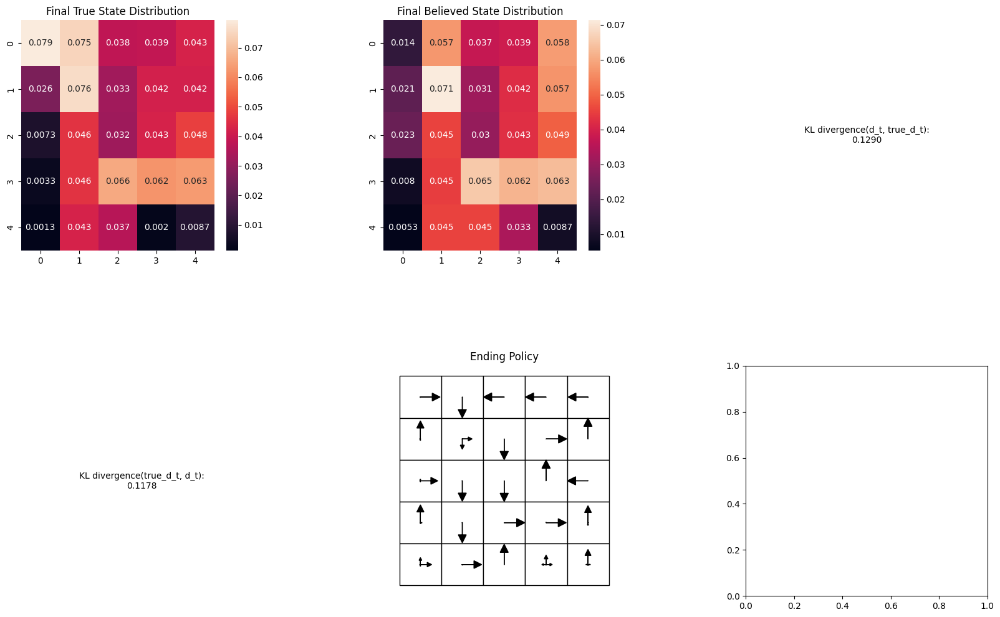

Run 0:  92%|██████████████████████████▋  | 9222/10000 [1:09:05<05:45,  2.25it/s]

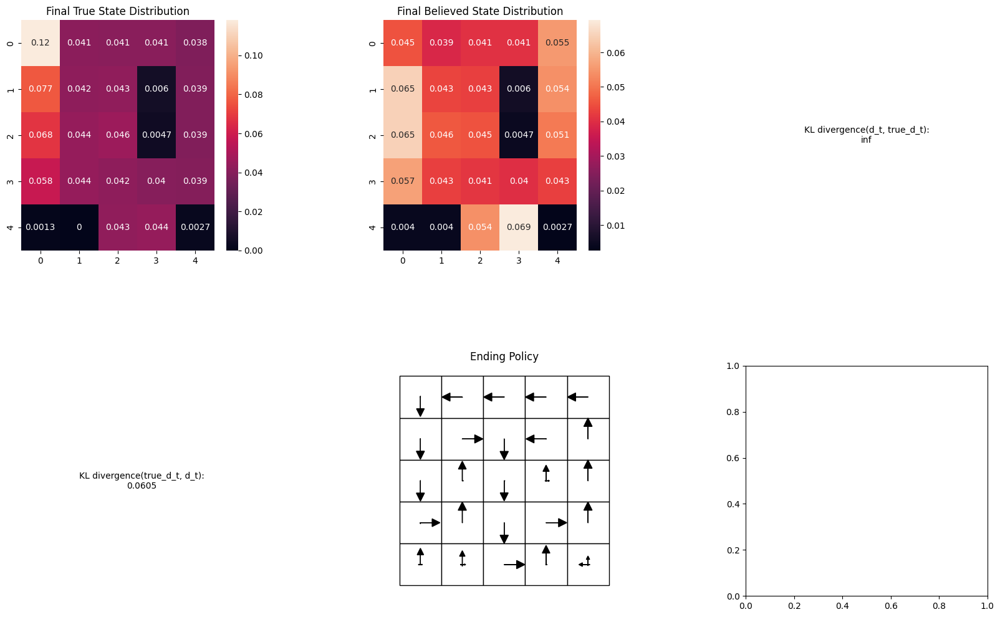

Run 0:  92%|██████████████████████████▊  | 9237/10000 [1:09:12<05:42,  2.23it/s]

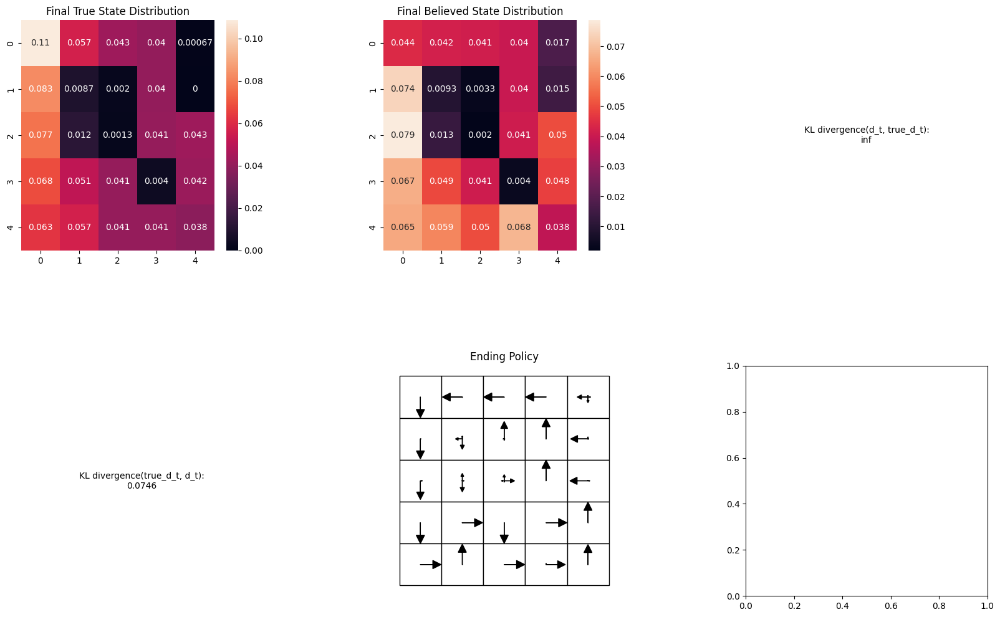

Run 0:  92%|██████████████████████████▊  | 9244/10000 [1:09:15<05:20,  2.36it/s]

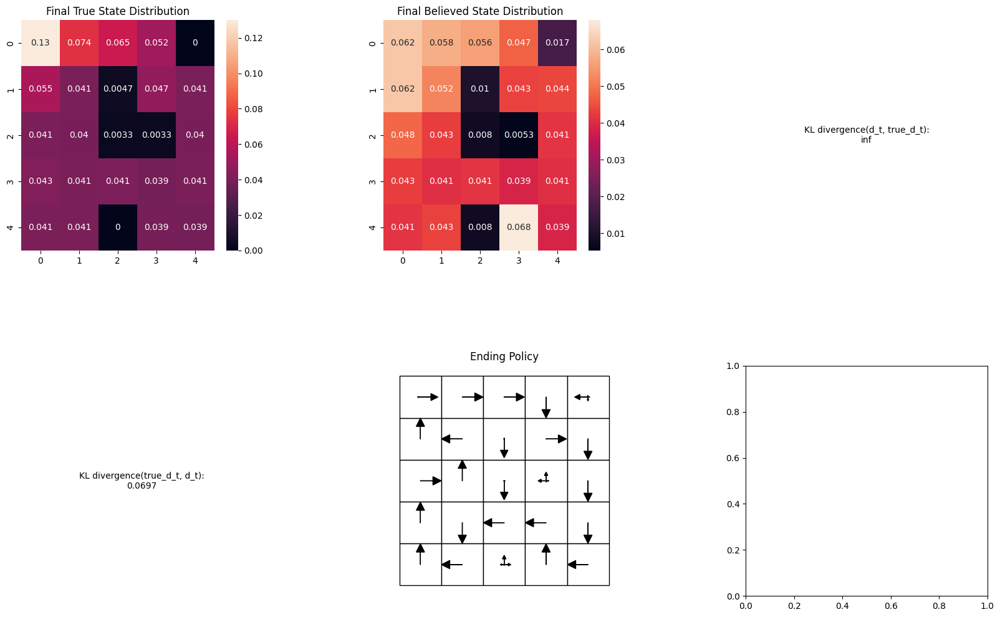

Run 0:  93%|██████████████████████████▉  | 9292/10000 [1:09:34<04:50,  2.44it/s]

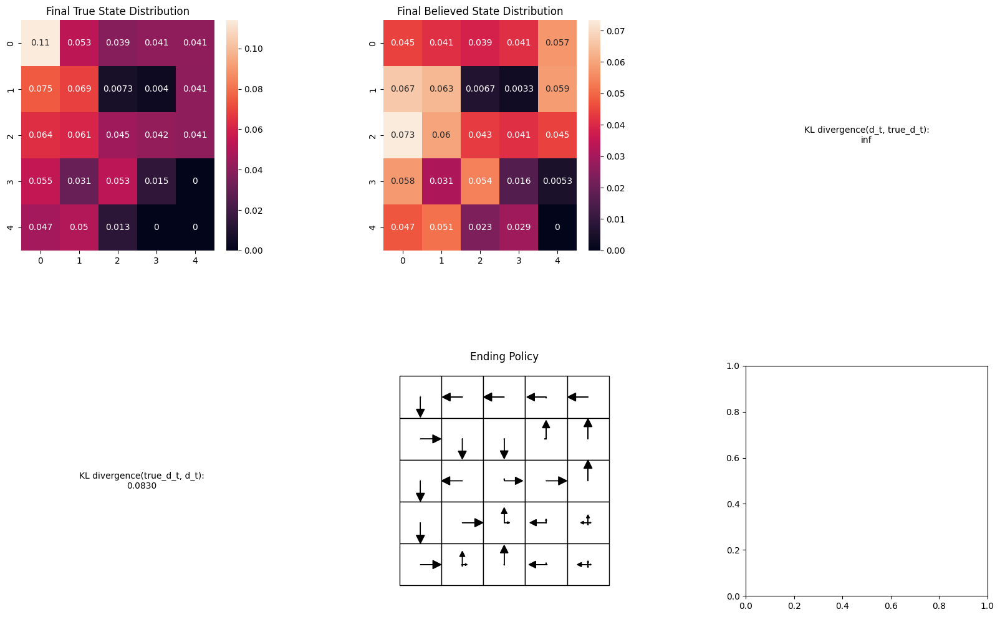

Run 0:  93%|███████████████████████████  | 9314/10000 [1:09:43<04:27,  2.56it/s]

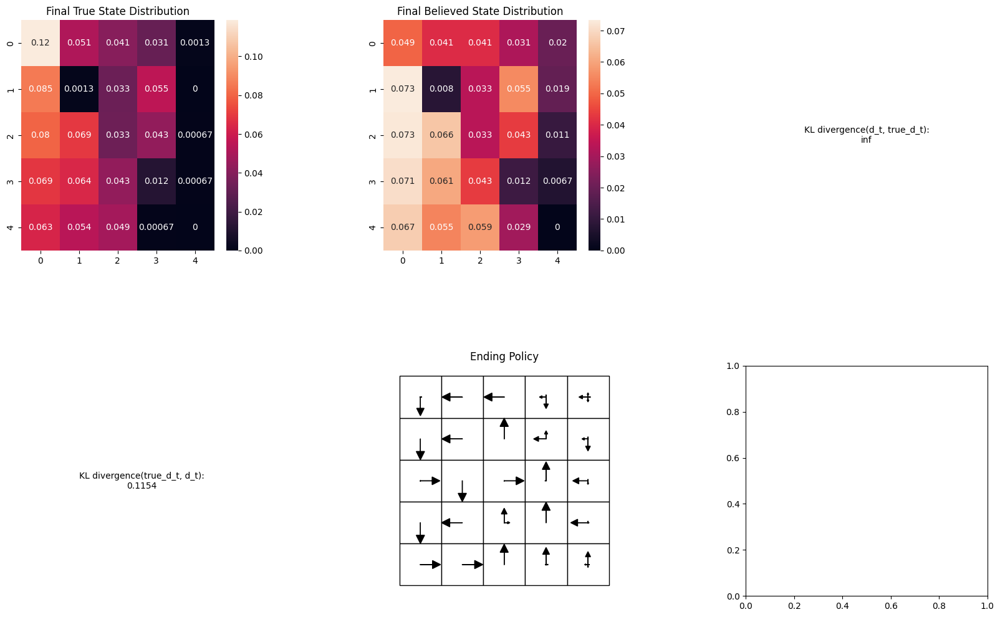

Run 0: 100%|████████████████████████████| 10000/10000 [1:14:11<00:00,  2.25it/s]


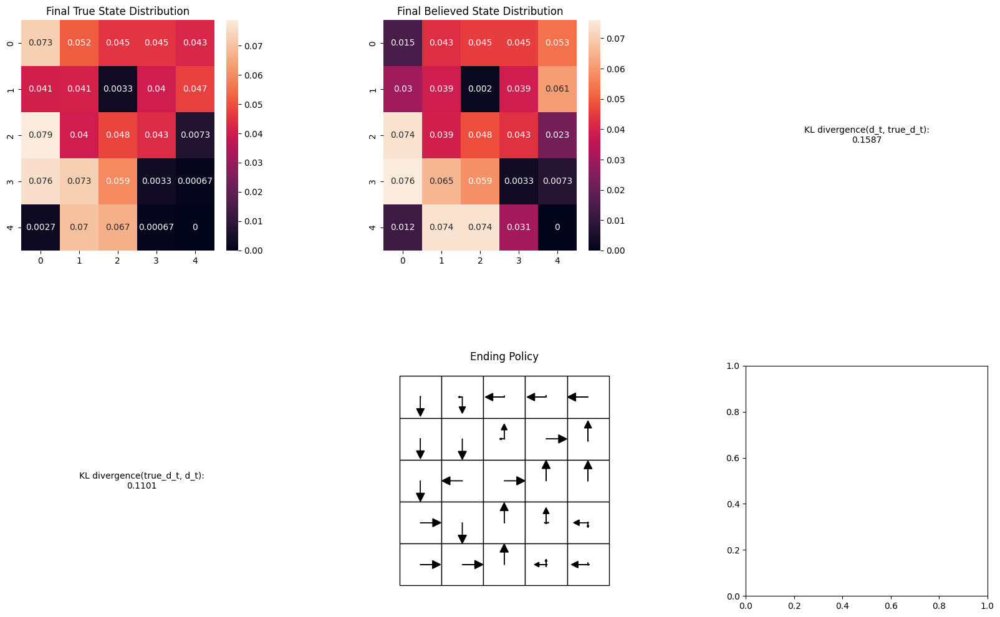

Stochastic Learned mean: 2.833735304572352


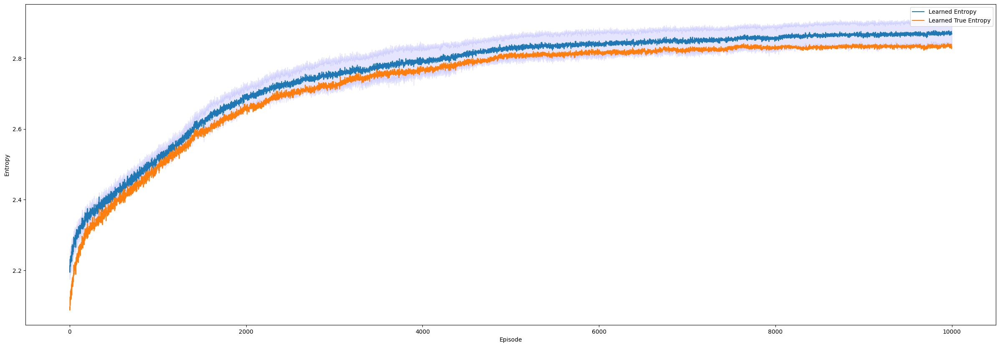

In [13]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0
randomize=0
shift_amount=0.1
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP Asymm")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Deterministic Asymmetric with Random Initial Position**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

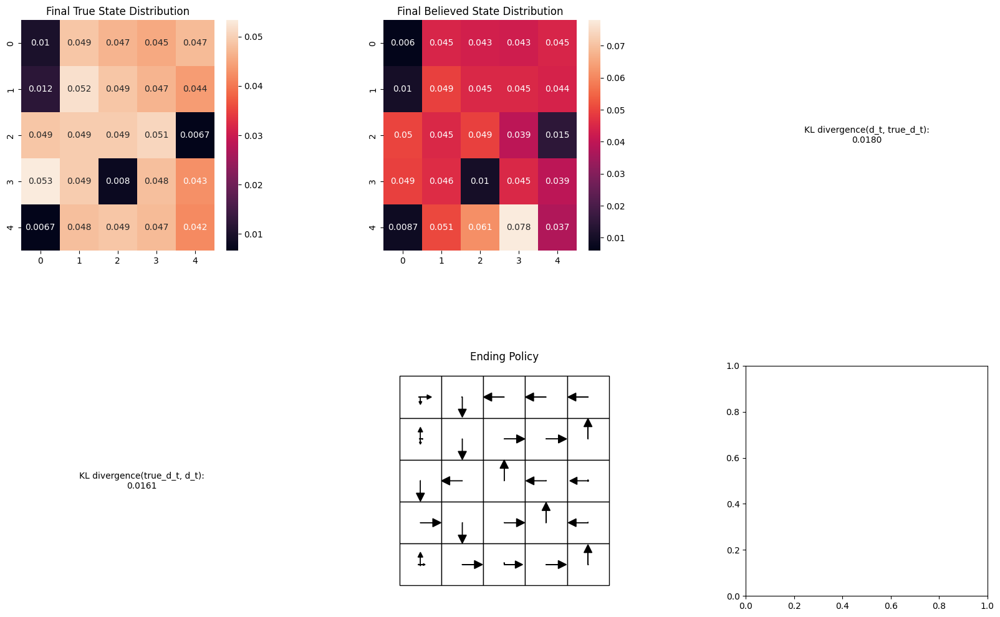

Run 0:  94%|███████████████████████████  | 9351/10000 [1:08:42<04:21,  2.48it/s]

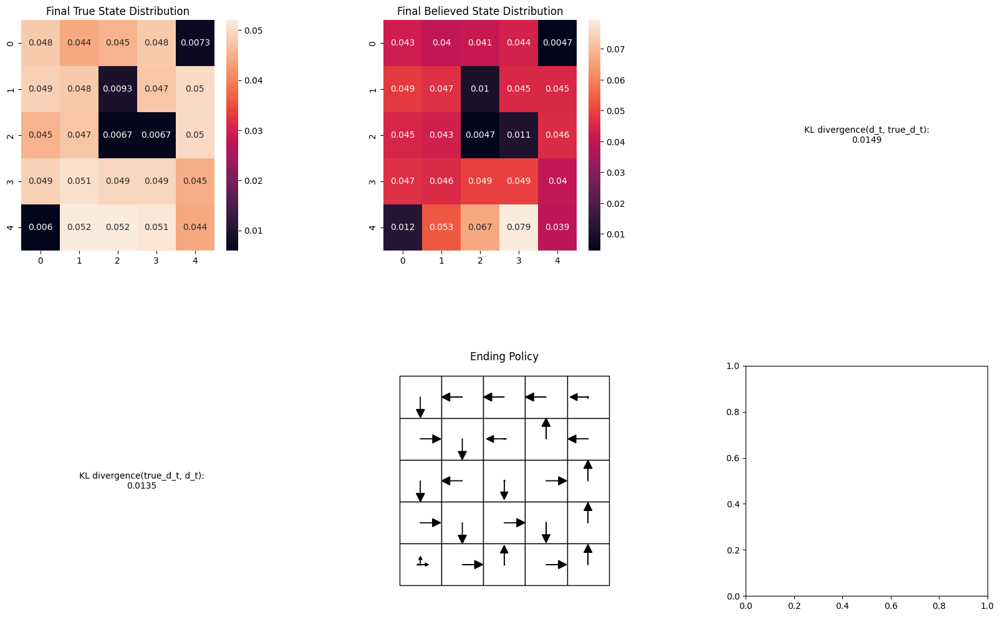

Run 0:  94%|███████████████████████████▏ | 9383/10000 [1:08:55<04:08,  2.49it/s]

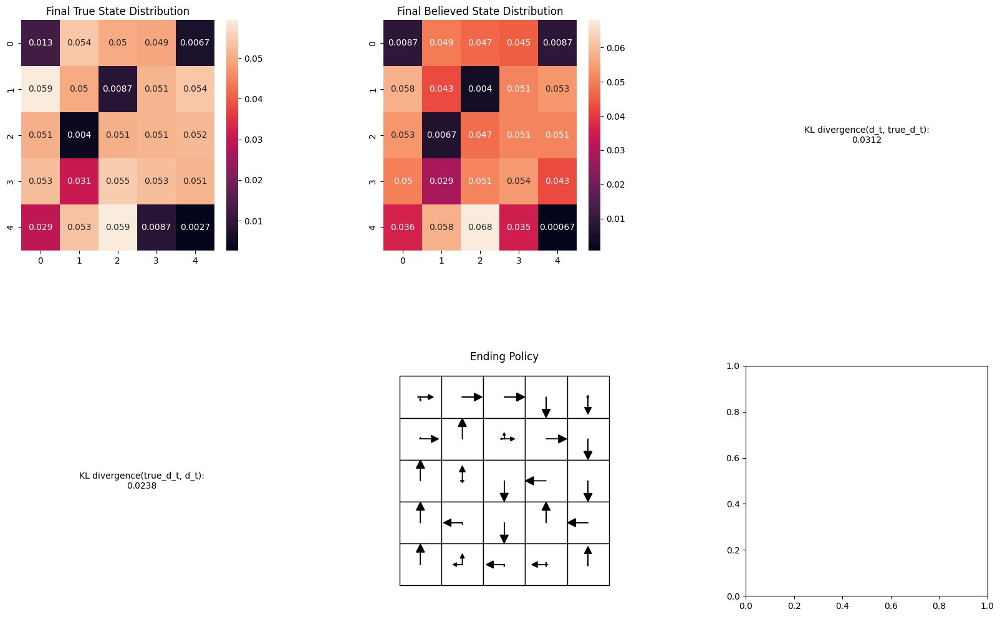

Run 0:  94%|███████████████████████████▎ | 9419/10000 [1:09:09<03:42,  2.62it/s]

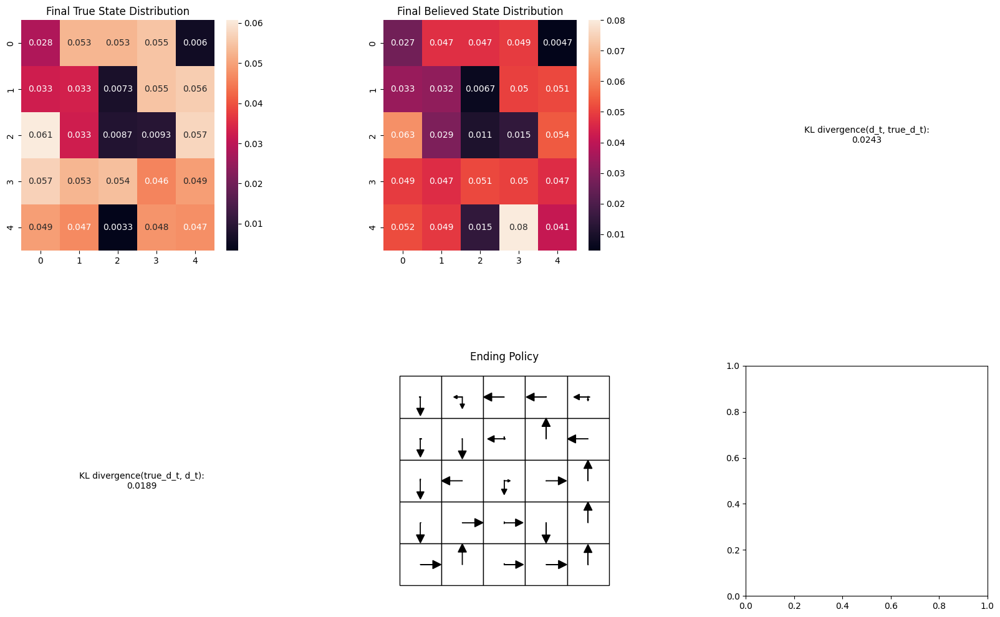

Run 0:  95%|███████████████████████████▍ | 9463/10000 [1:09:29<04:00,  2.24it/s]

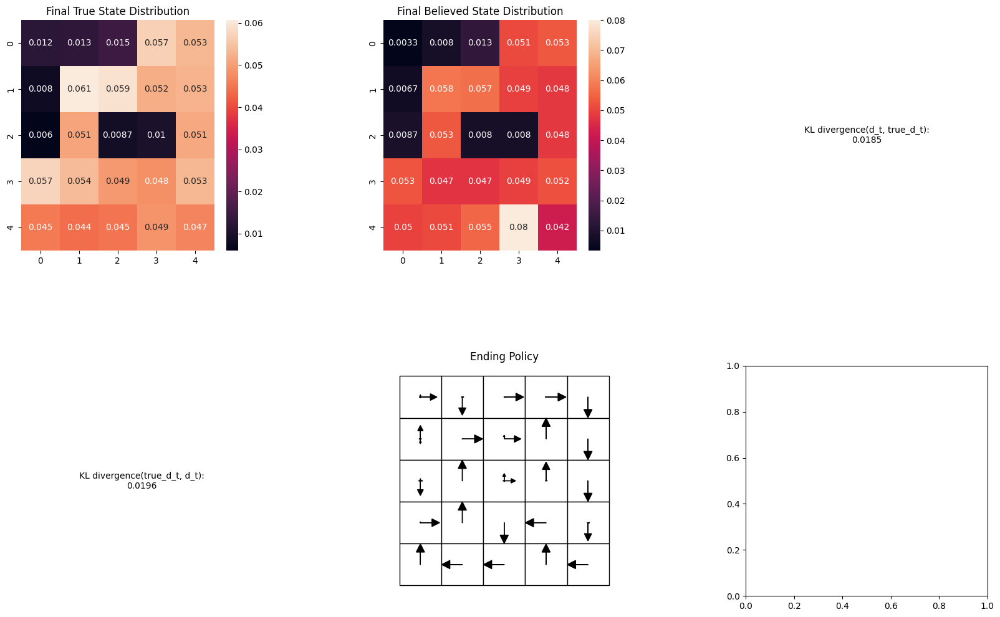

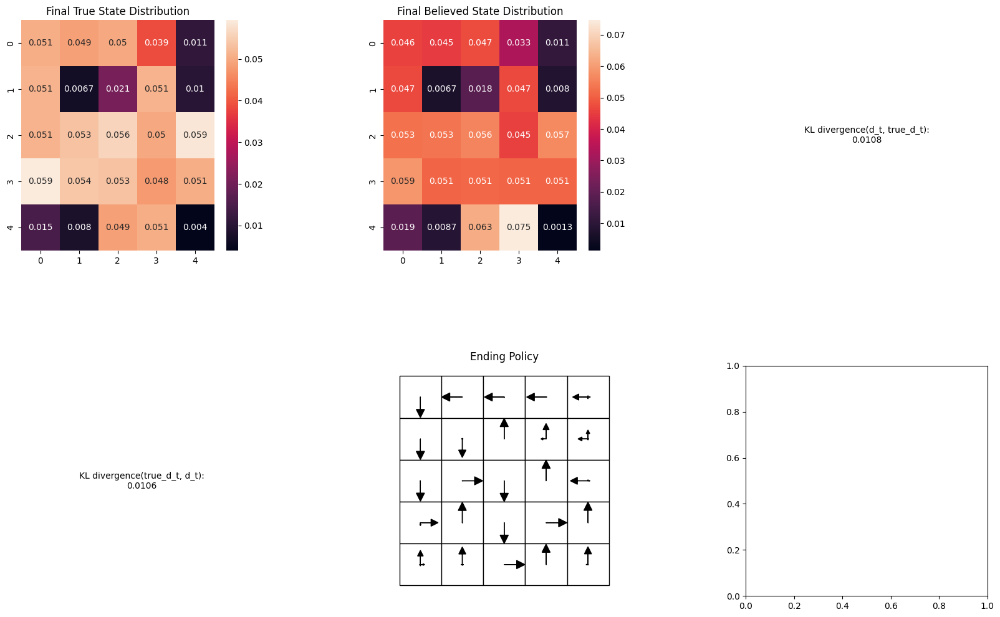

Run 0:  95%|███████████████████████████▌ | 9525/10000 [1:09:54<03:16,  2.42it/s]

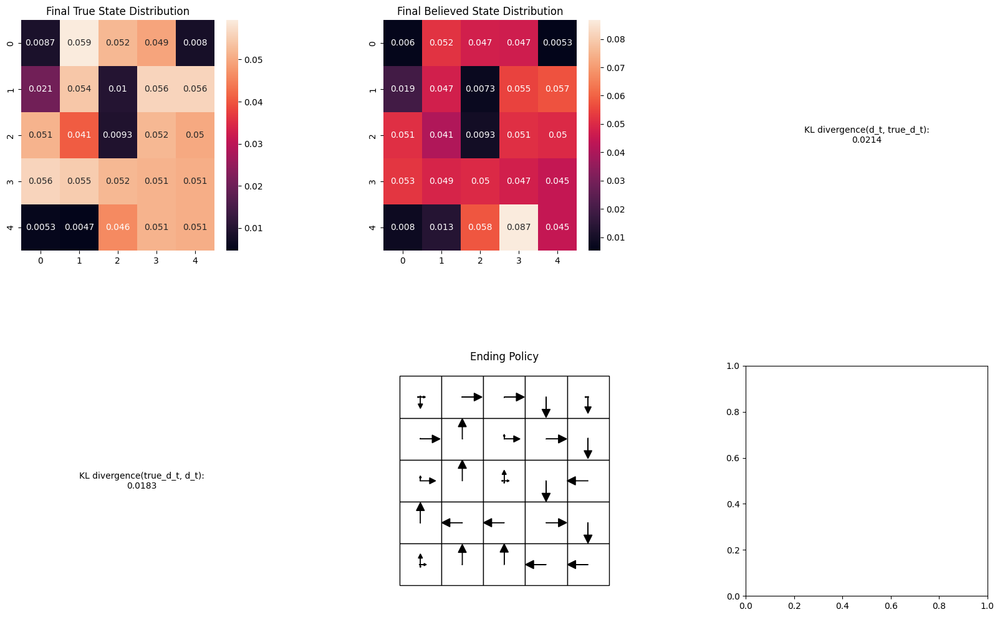

Run 0:  96%|███████████████████████████▋ | 9550/10000 [1:10:03<02:54,  2.57it/s]

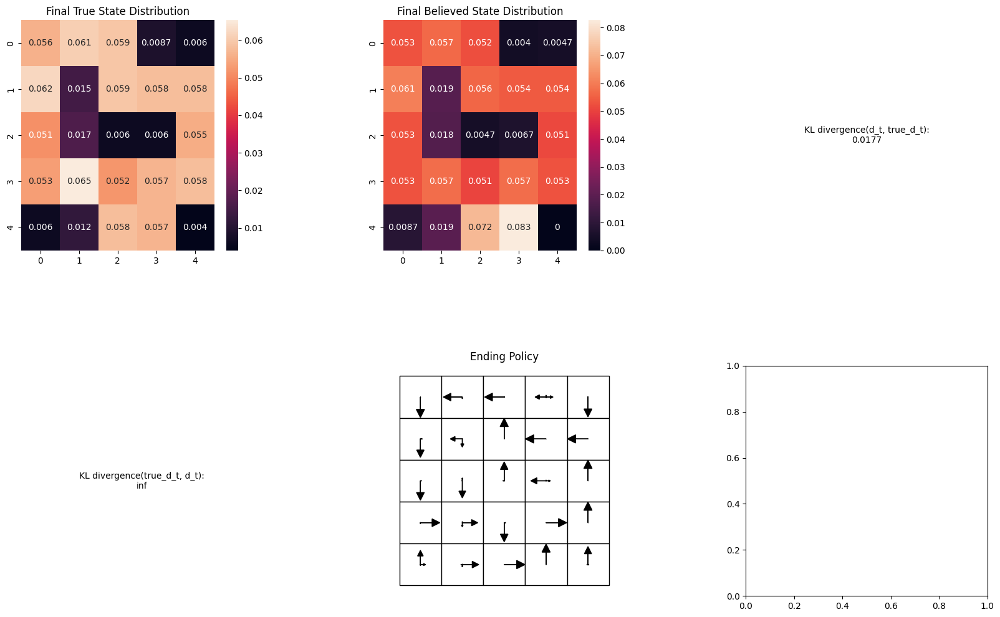

Run 0:  96%|███████████████████████████▋ | 9559/10000 [1:10:07<03:06,  2.37it/s]

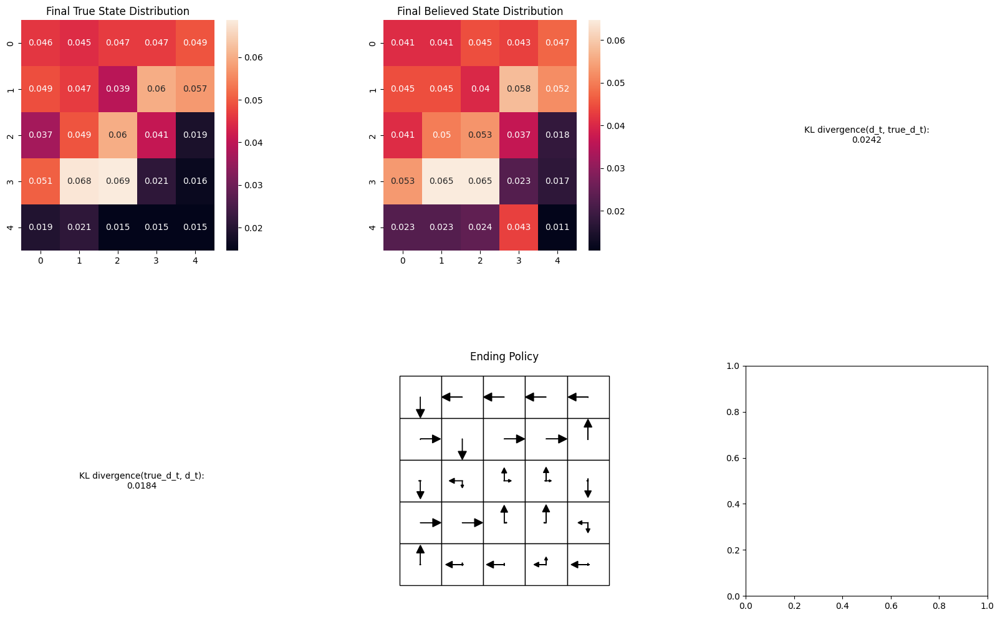

Run 0: 100%|████████████████████████████| 10000/10000 [1:12:48<00:00,  2.29it/s]


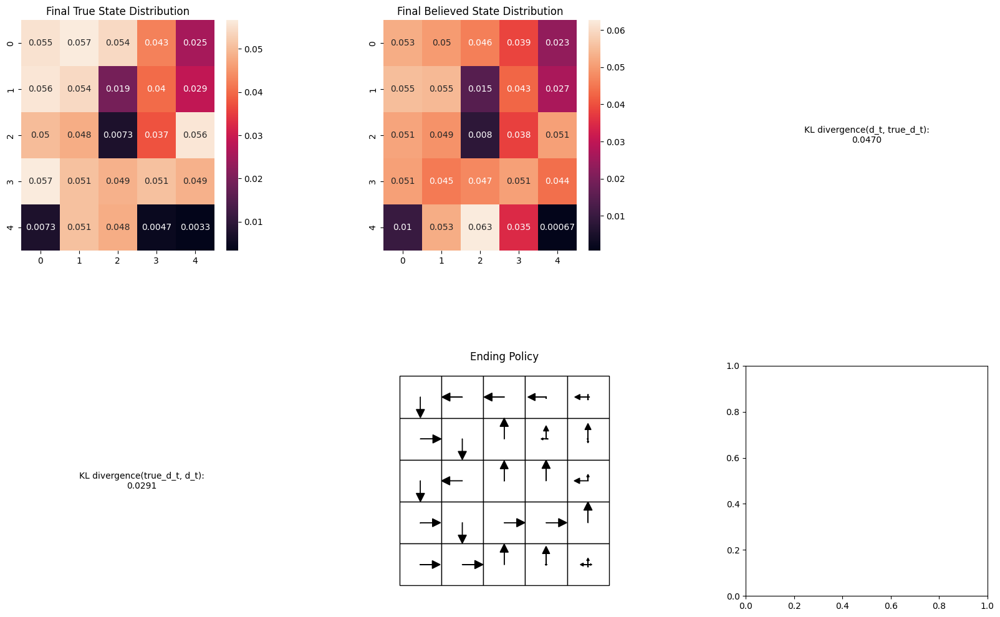

Stochastic Learned mean: 2.8559075794507205


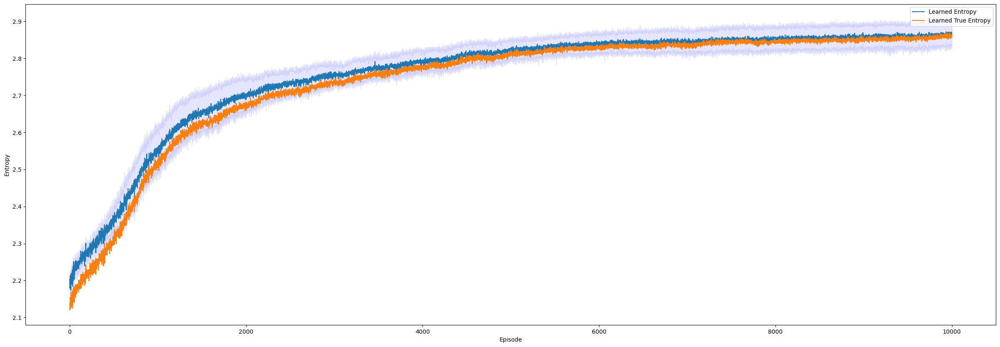

In [14]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0
randomize=1
shift_amount=0.1
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Deterministic Entropy POMDP Asymm Random Initial Position")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Deterministic Asymmetric with Random Initial Position Correct Prior**

In [15]:
'''# Number of episodes for the training
n_episodes = 6000
n_traj = 65
# Number of runs per episode
n_run = 3
confidence = 0.95
time_horizon = 25
env = GridworldPOMDPEnvAsymm(time_horizon = time_horizon, steepness=15, prob=0, randomize=1)

with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    # Train the agent and plot the entropies
    list_true_entropies = []
    list_true_entropies = []
    for r in range(n_run):
        agent = REINFORCEAgentEPOMDP(env, alpha = 0.5)
        avg_entropies = []
        avg_true_entropies = []
        for i in range(n_episodes):
            episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
            entropies = agent.update_multiple_sampling(episodes)
            avg_entropies.append(np.mean(entropies))
            avg_true_entropies.append(np.mean(true_entropies))
            pbar.update(1)
        agent.print_visuals(env=env, n_traj=n_traj)
        list_true_entropies.append(avg_entropies)
        list_true_entropies.append(avg_true_entropies)
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

plot_graph(n_run, n_episodes, list_true_entropies, list_true_entropies, confidence)'''

'# Number of episodes for the training\nn_episodes = 6000\nn_traj = 65\n# Number of runs per episode\nn_run = 3\nconfidence = 0.95\ntime_horizon = 25\nenv = GridworldPOMDPEnvAsymm(time_horizon = time_horizon, steepness=15, prob=0, randomize=1)\n\nwith tqdm(total=n_run * n_episodes, ncols=80) as pbar:\n    # Train the agent and plot the entropies\n    list_true_entropies = []\n    list_true_entropies = []\n    for r in range(n_run):\n        agent = REINFORCEAgentEPOMDP(env, alpha = 0.5)\n        avg_entropies = []\n        avg_true_entropies = []\n        for i in range(n_episodes):\n            episodes, true_entropies = agent.play(env=env, n_traj=n_traj)\n            entropies = agent.update_multiple_sampling(episodes)\n            avg_entropies.append(np.mean(entropies))\n            avg_true_entropies.append(np.mean(true_entropies))\n            pbar.update(1)\n        agent.print_visuals(env=env, n_traj=n_traj)\n        list_true_entropies.append(avg_entropies)\n        list_true_

**Stochastic Asymmetric**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
Run 0:   0%|                                          | 0/10000 [00:00<?, ?it/s]/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for 

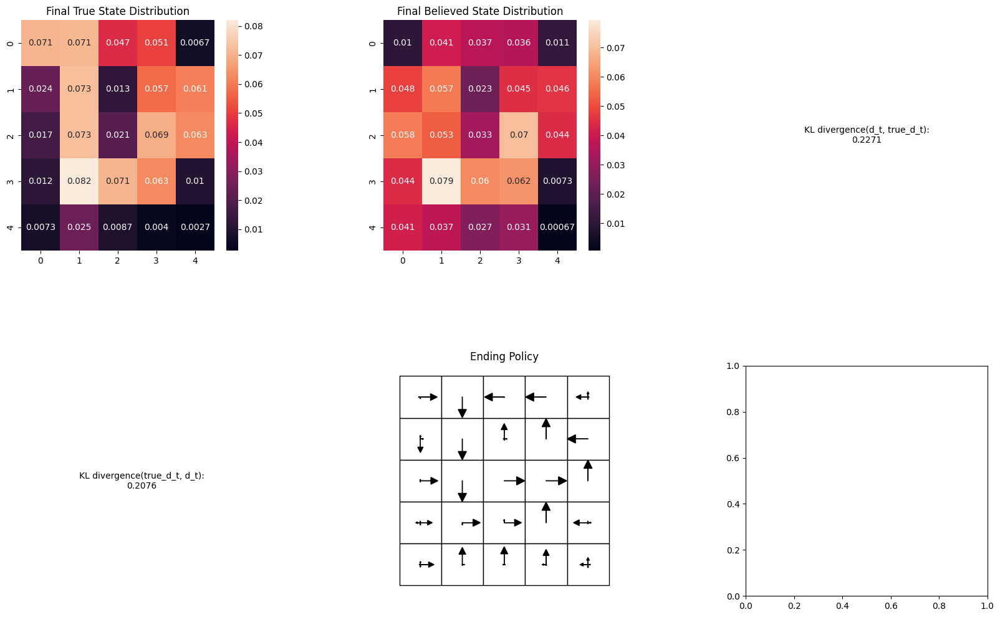

Run 0:  99%|████████████████████████████▊| 9926/10000 [1:07:27<00:30,  2.43it/s]

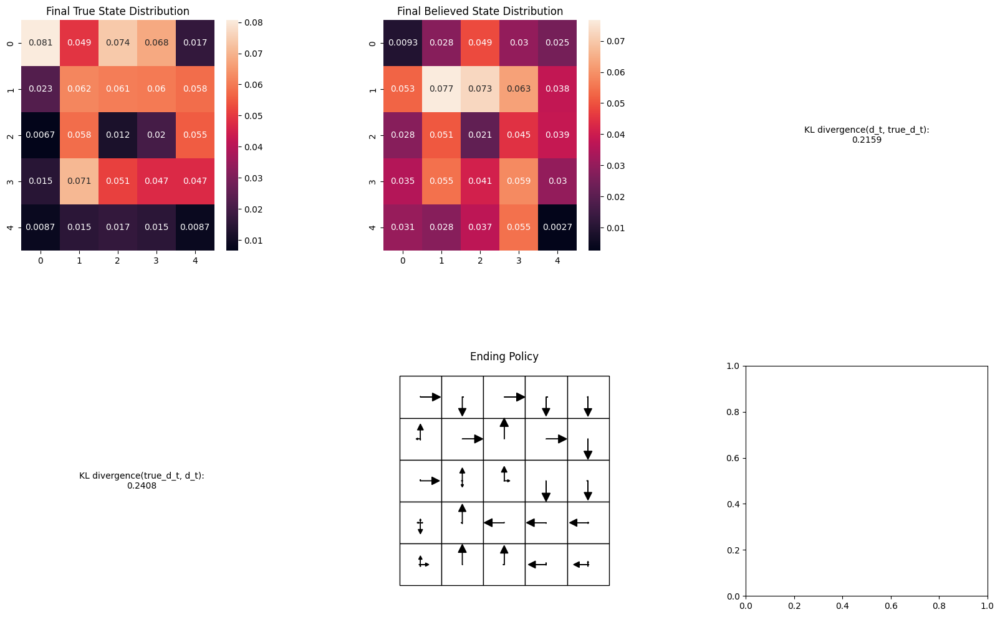

Run 0: 100%|████████████████████████████| 10000/10000 [1:07:56<00:00,  2.45it/s]


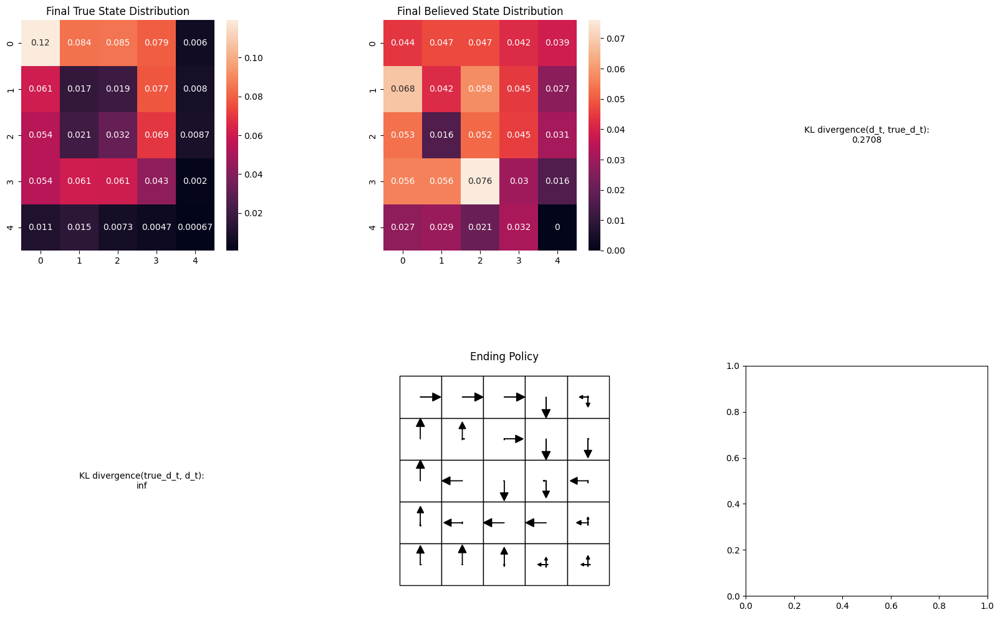

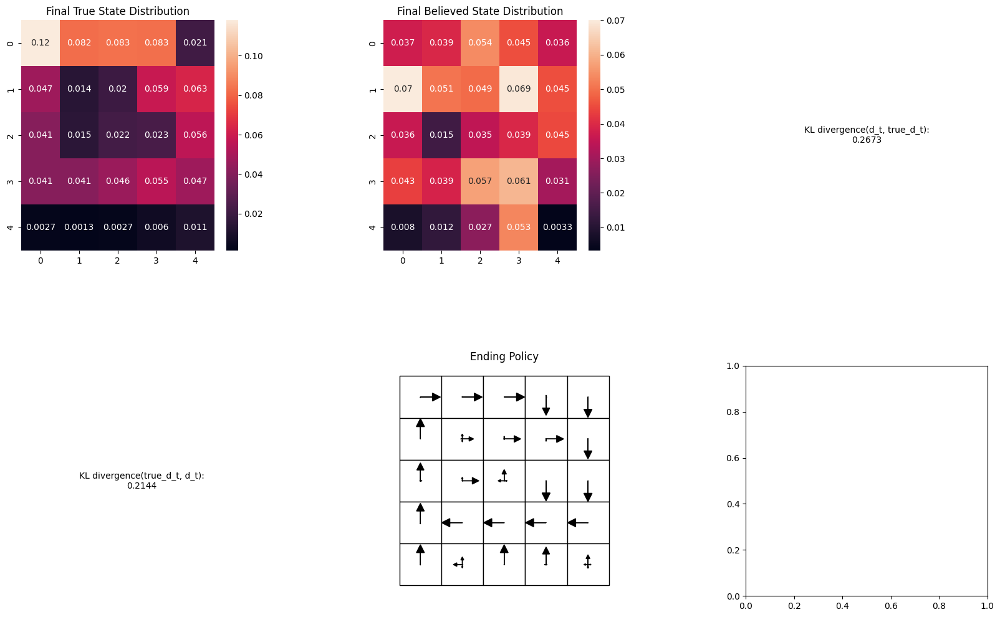

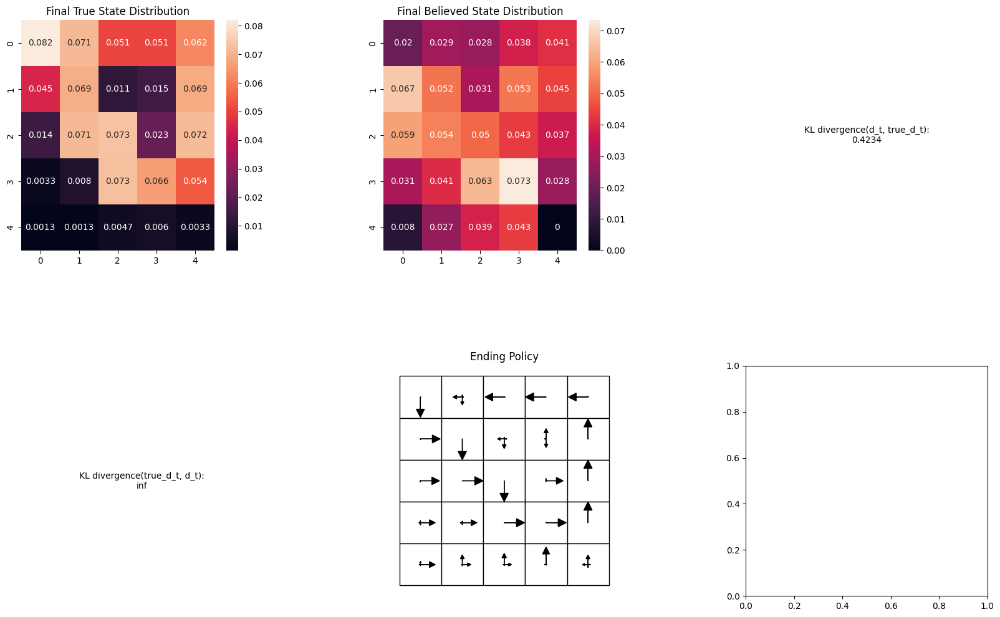

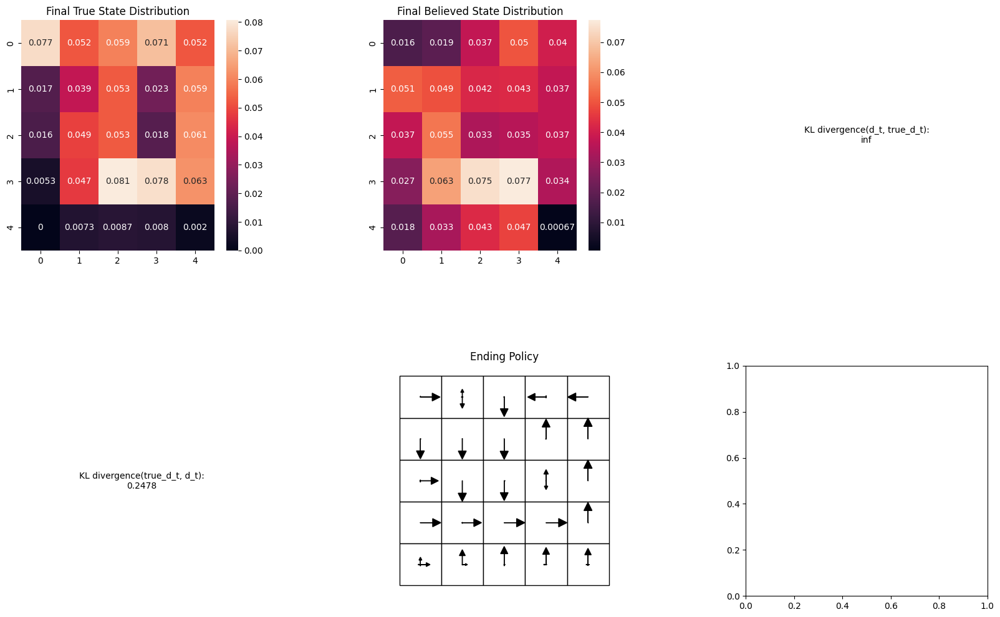

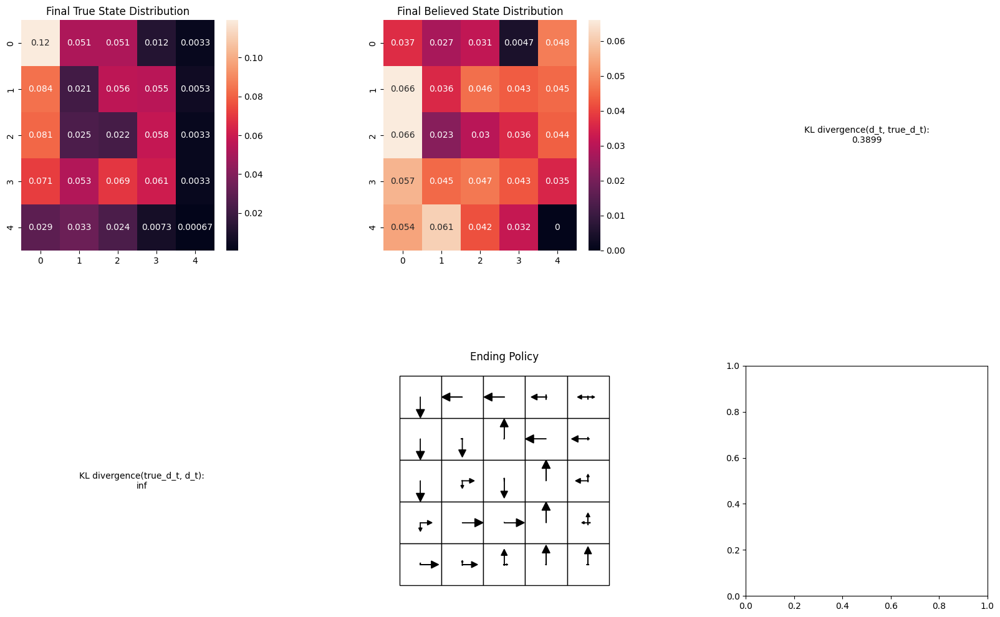

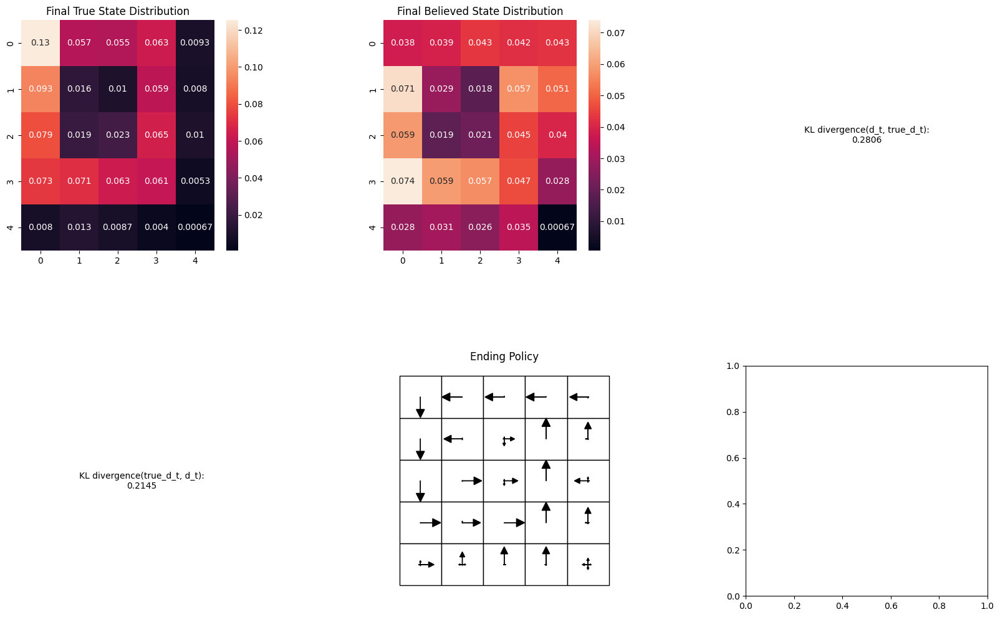

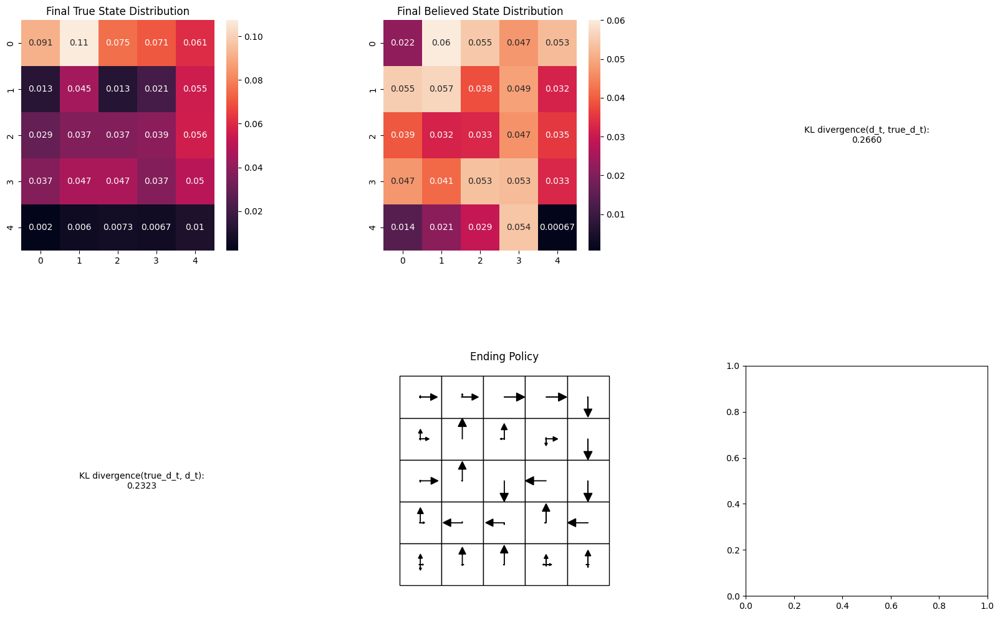

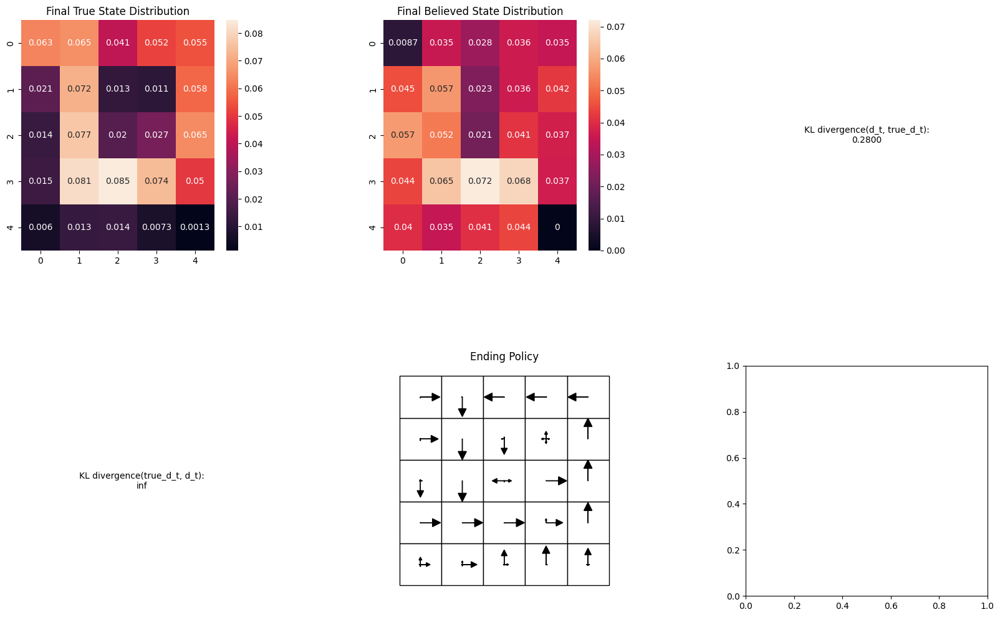

Stochastic Learned mean: 2.624245919176008


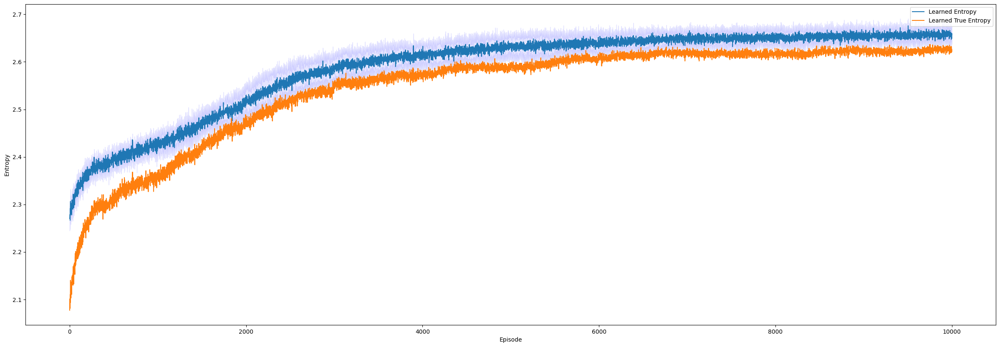

In [16]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0.1
randomize=0
shift_amount=0.1
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP Asymm")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Stochastic Asymmetric with Random Initial Position**

/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
/home/duilio999/.pyenv/versions/3.10.12/lib/python3.10/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.b

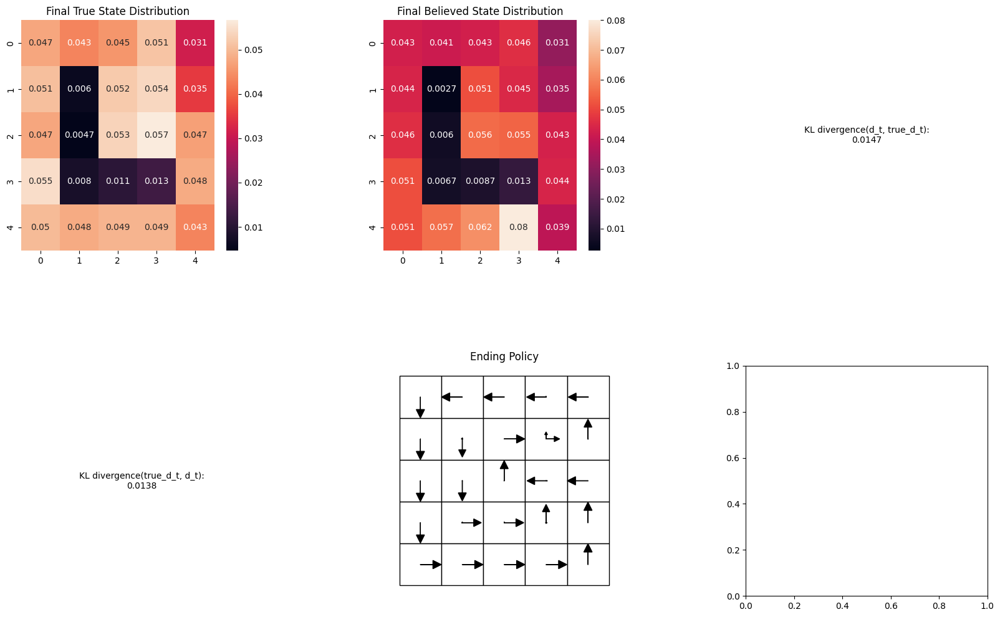

Run 0:  98%|████████████████████████████▍| 9786/10000 [1:07:02<01:27,  2.45it/s]

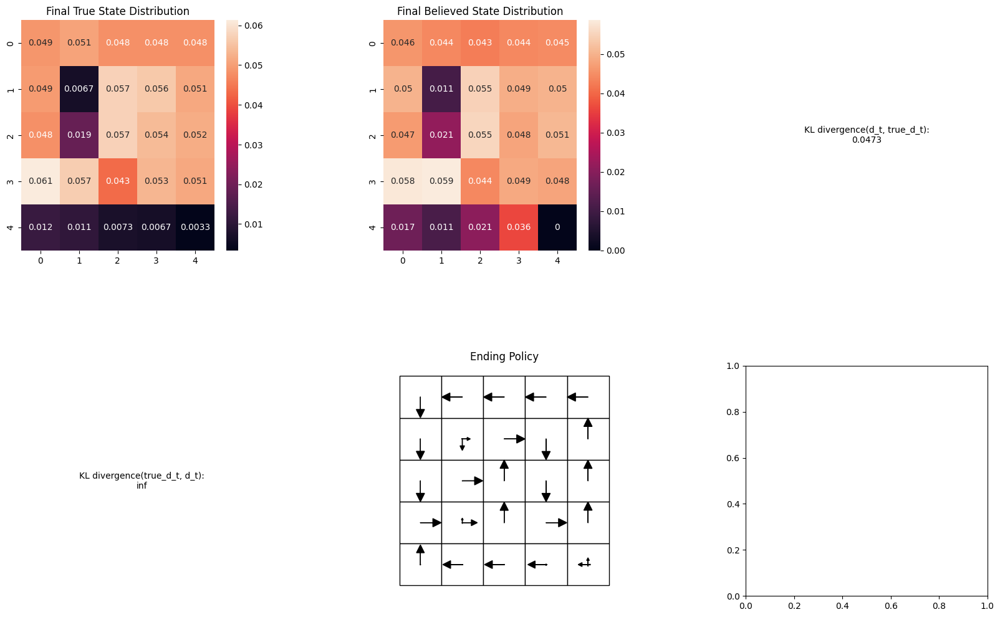

Run 0:  99%|████████████████████████████▋| 9898/10000 [1:07:45<00:42,  2.39it/s]

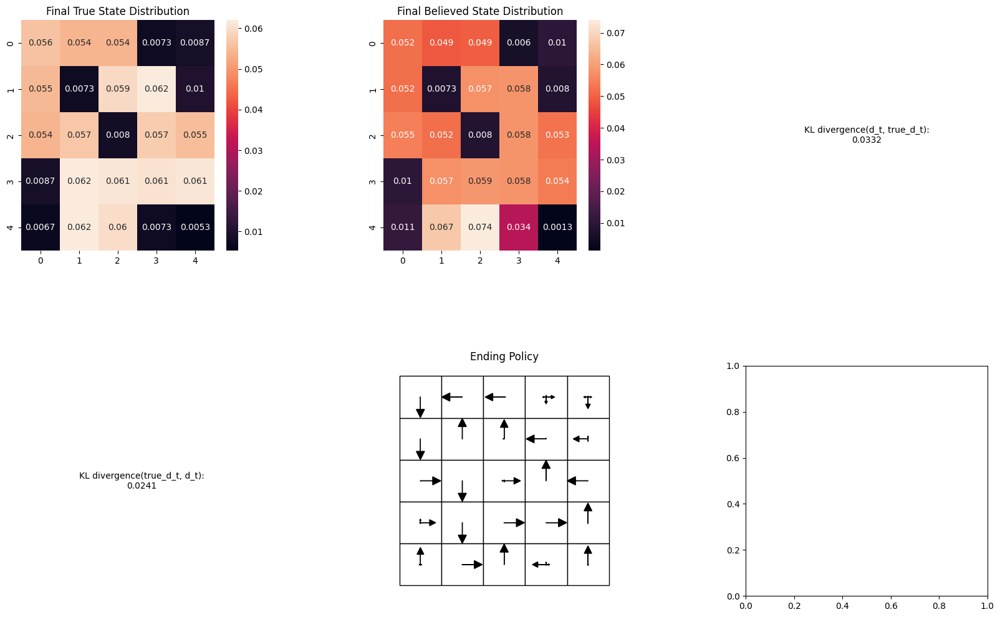

Run 0: 100%|████████████████████████████| 10000/10000 [1:08:28<00:00,  2.43it/s]


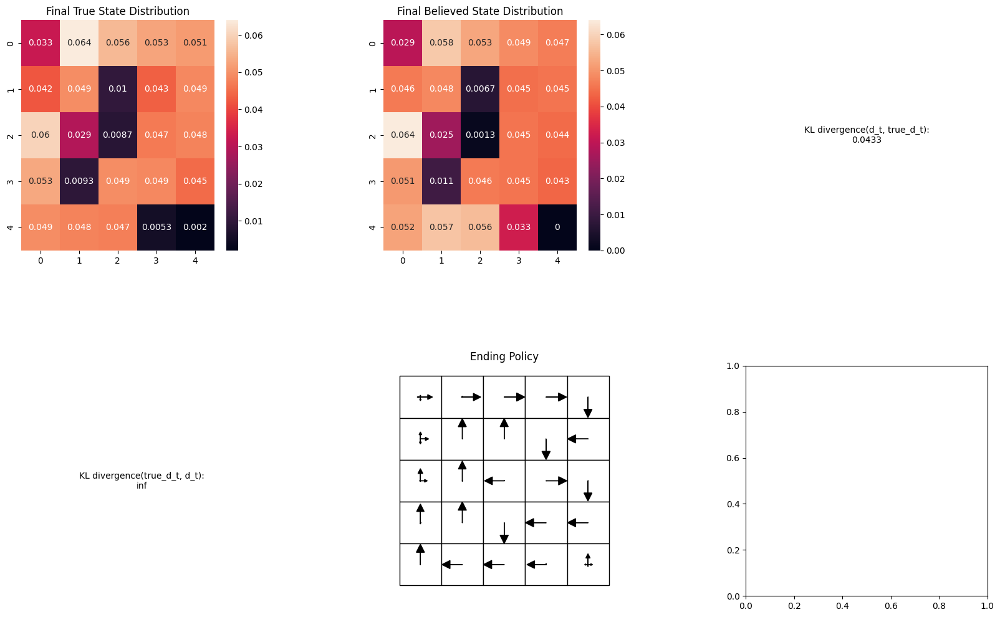

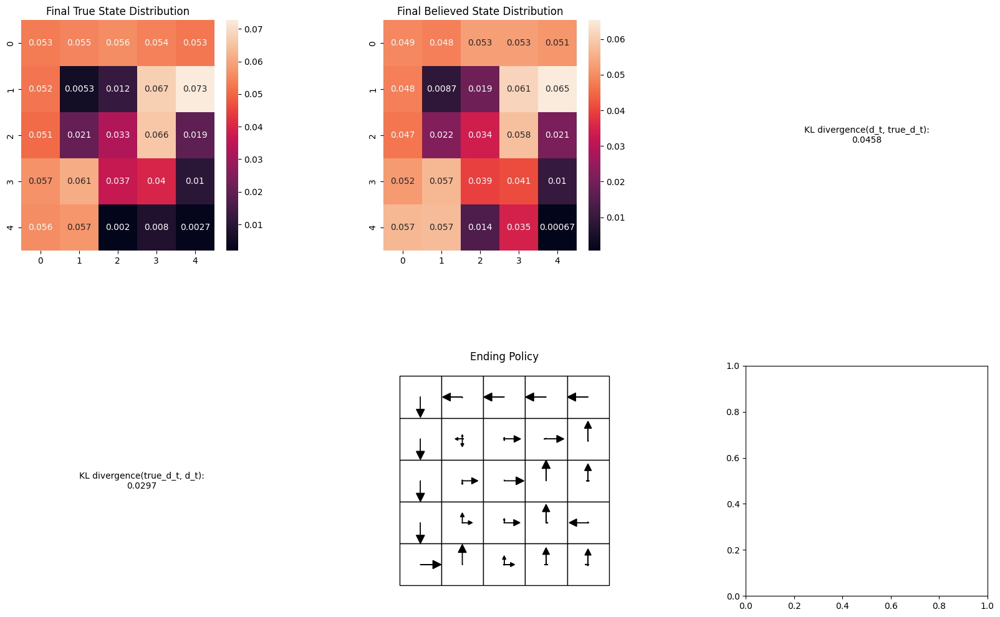

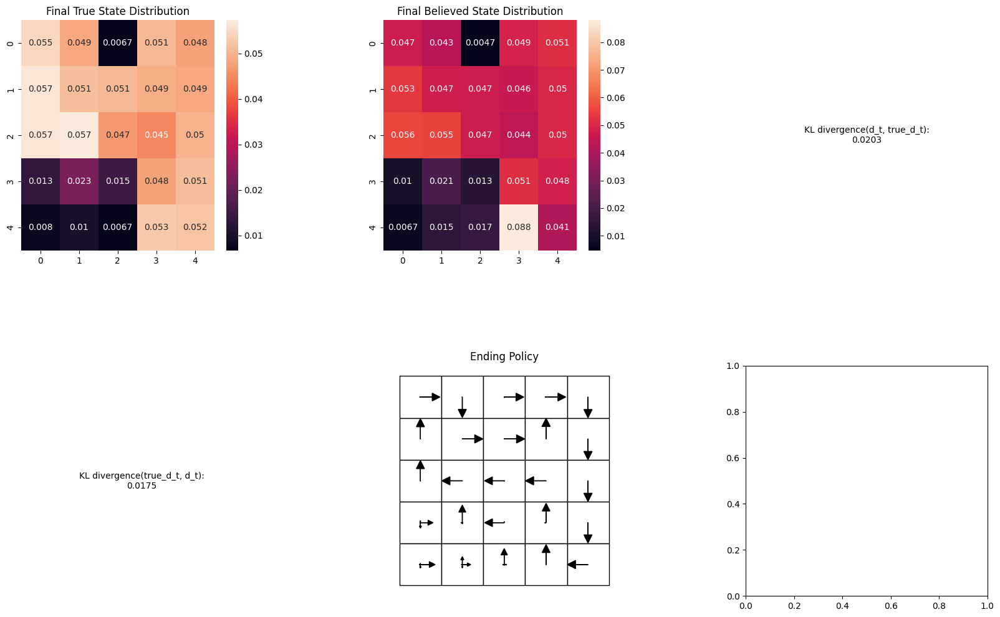

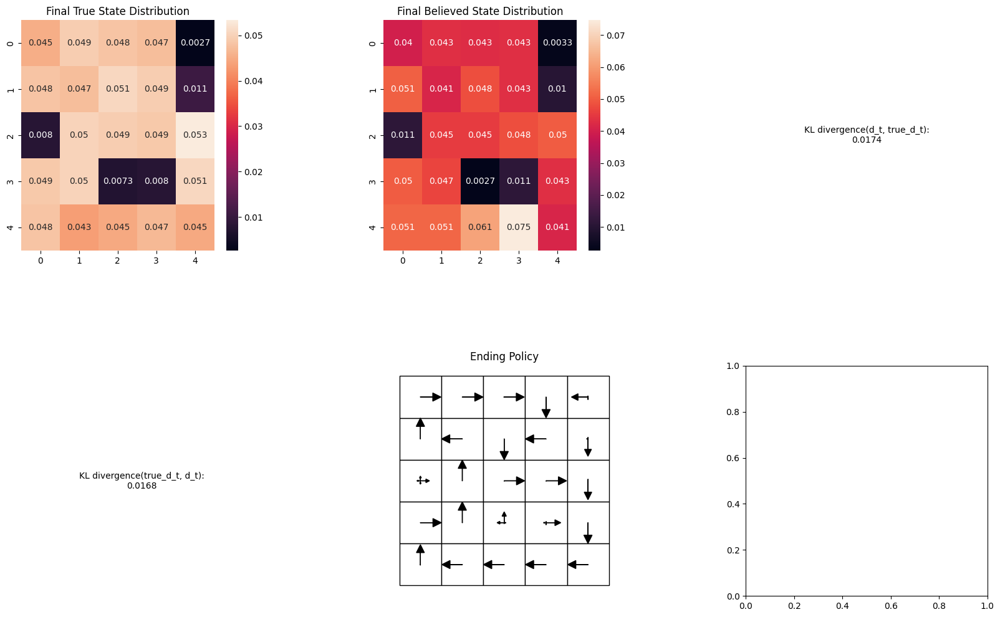

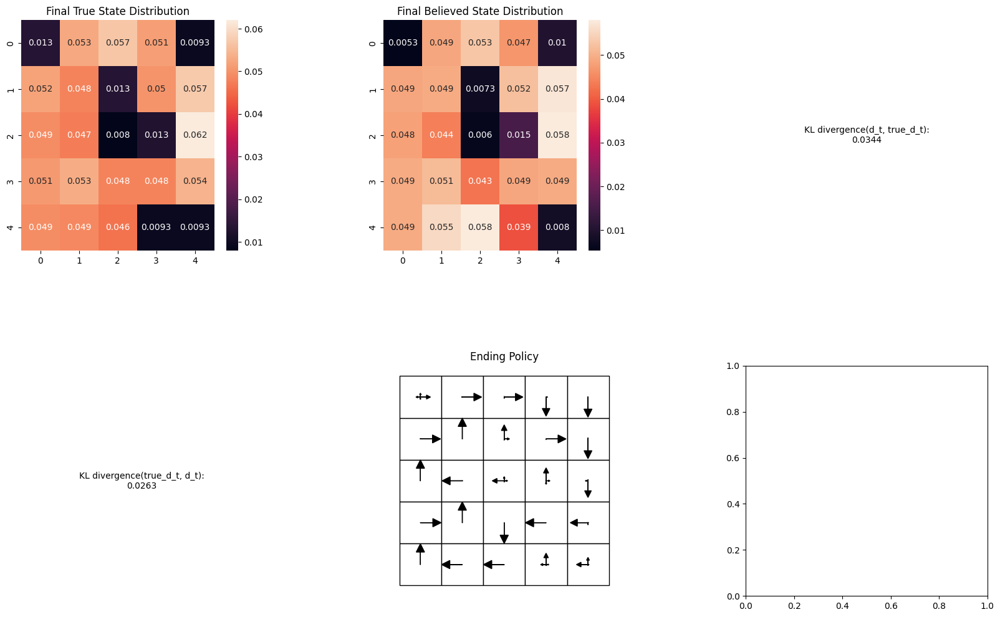

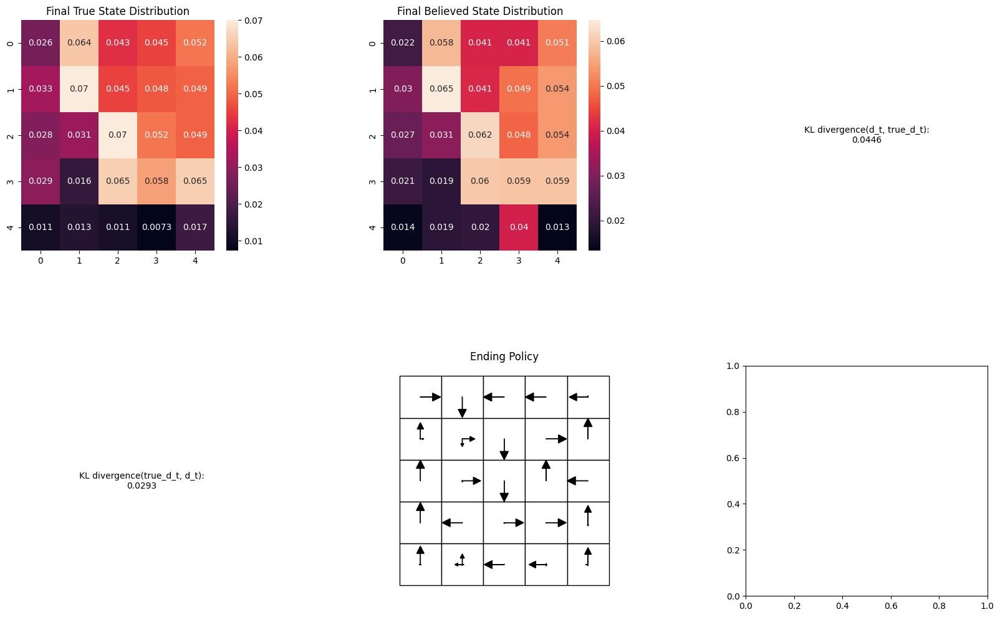

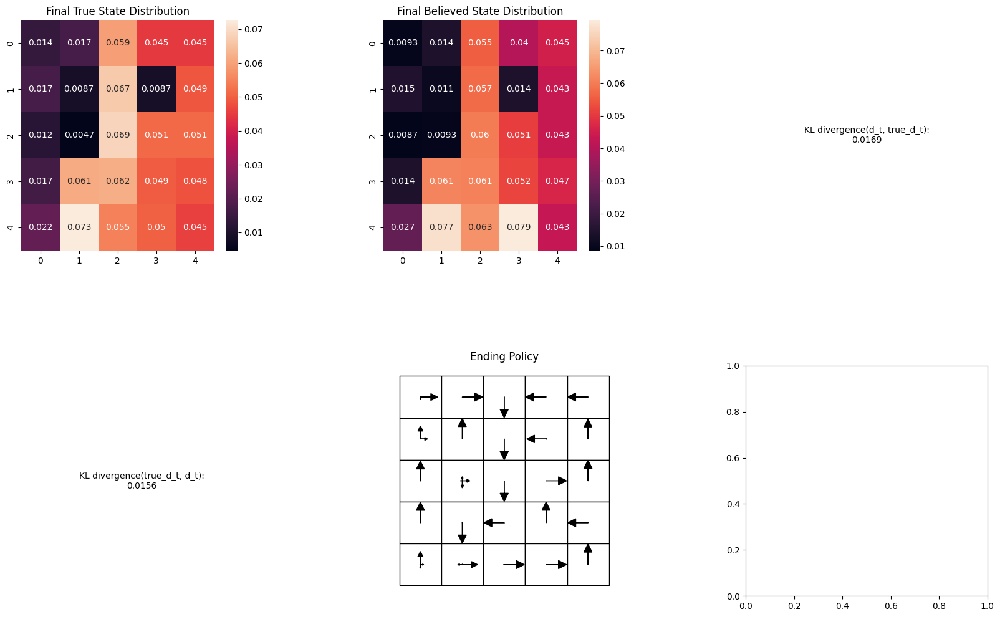

Stochastic Learned mean: 2.838532933508792


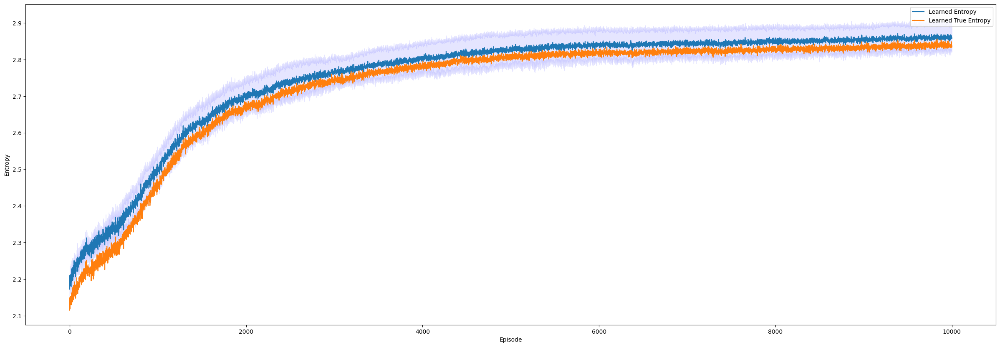

In [17]:
# Number of episodes for the training
n_episodes = 10000
n_traj = 60
# Number of runs per episode
n_run = 10
# Environment variables
time_horizon = 25
steepness=15
prob=0.1
randomize=1
shift_amount=0.1
# Agent variables
alpha = 0.15

# Create a list of arguments to pass to train_agent
args_list = [(r, alpha, n_traj, n_episodes, steepness, prob, randomize, shift_amount) for r in range(n_run)]

# Use multiprocessing.Pool to parallelize the runs
with Pool() as pool:
    results = pool.map(train_agent, args_list)

# Collect the results
list_entropies = []
list_true_entropies = []
for result in results:
    entropies, true_entropies = result
    list_entropies.append(entropies)
    list_true_entropies.append(true_entropies)

# Transpose the lists to get the desired format
list_entropies = np.transpose(np.array(list_entropies), (1, 0))
list_true_entropies = np.transpose(np.array(list_true_entropies), (1, 0))

# Prepare values to print
plot_args = {}
entropies_means = np.mean(list_entropies, axis=1)
entropies_stds = np.std(list_entropies, axis=1)
plot_args['Learned Entropy'] = [entropies_means, entropies_stds]
true_entropies_means = np.mean(list_true_entropies, axis=1)
true_entropies_stds = np.std(list_true_entropies, axis=1)
plot_args['Learned True Entropy'] = [true_entropies_means, true_entropies_stds]
plot_graph(n_run, n_episodes, plot_args, confidence, 'Entropy', "Stochastic Entropy POMDP Asymm Random Initial Position")
print("Stochastic Learned mean: " + str(np.mean(true_entropies_means[9500:])))

**Stochastic Asymmetric with Random Initial Position Correct Prior**

In [18]:
'''# Number of episodes for the training
n_episodes = 6000
n_traj = 65
# Number of runs per episode
n_run = 3
confidence = 0.95
time_horizon = 25
env = GridworldPOMDPEnvAsymm(time_horizon = time_horizon, steepness=15, prob=0.1, randomize=1)

with tqdm(total=n_run * n_episodes, ncols=80) as pbar:
    # Train the agent and plot the entropies
    list_true_entropies = []
    list_true_entropies = []
    for r in range(n_run):
        agent = REINFORCEAgentEPOMDP(env, alpha = 0.5)
        avg_entropies = []
        avg_true_entropies = []
        for i in range(n_episodes):
            episodes, true_entropies = agent.play(env=env, n_traj=n_traj)
            entropies = agent.update_multiple_sampling(episodes)
            avg_entropies.append(np.mean(entropies))
            avg_true_entropies.append(np.mean(true_entropies))
            pbar.update(1)
        agent.print_visuals(env=env, n_traj=n_traj)
        list_true_entropies.append(avg_entropies)
        list_true_entropies.append(avg_true_entropies)
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))
    list_true_entropies = np.transpose(np.array(list_true_entropies), (1,0))

plot_graph(n_run, n_episodes, list_true_entropies, list_true_entropies, confidence)'''

'# Number of episodes for the training\nn_episodes = 6000\nn_traj = 65\n# Number of runs per episode\nn_run = 3\nconfidence = 0.95\ntime_horizon = 25\nenv = GridworldPOMDPEnvAsymm(time_horizon = time_horizon, steepness=15, prob=0.1, randomize=1)\n\nwith tqdm(total=n_run * n_episodes, ncols=80) as pbar:\n    # Train the agent and plot the entropies\n    list_true_entropies = []\n    list_true_entropies = []\n    for r in range(n_run):\n        agent = REINFORCEAgentEPOMDP(env, alpha = 0.5)\n        avg_entropies = []\n        avg_true_entropies = []\n        for i in range(n_episodes):\n            episodes, true_entropies = agent.play(env=env, n_traj=n_traj)\n            entropies = agent.update_multiple_sampling(episodes)\n            avg_entropies.append(np.mean(entropies))\n            avg_true_entropies.append(np.mean(true_entropies))\n            pbar.update(1)\n        agent.print_visuals(env=env, n_traj=n_traj)\n        list_true_entropies.append(avg_entropies)\n        list_tru